In [1]:
import sys
import os
from glob import glob
sys.path.append("../NEAT")
from NEATModels import NEATStatic, nets
from NEATModels.Staticconfig  import static_config
from NEATUtils import helpers
from NEATUtils.helpers import save_json, load_json
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

Using TensorFlow backend.


In [2]:
npz_directory = '/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/'
npz_name = 'Landmark128.npz'
npz_val_name = 'Landmark128Val.npz'


model_dir = '/home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/'
#Model name based on wether it is residual or sequntial ONEAT network
model_name = 'Landmark128K7s48d11.h5'


In [3]:
static_categories_json = model_dir + 'StaticCategories.json'
key_categories = load_json(static_categories_json)
static_cord_json = model_dir + 'StaticCord.json'
key_cord = load_json(static_cord_json)

#For ORNET use residual = True and for OSNET use residual = False
residual = False
#NUmber of starting convolutional filters, is doubled down with increasing depth
startfilter = 48
#CNN network start layer, mid layers and lstm layer kernel size
start_kernel = 7
mid_kernel = 7
#Network depth has to be 9n + 2, n= 3 or 4 is optimal for Notum dataset
depth = 11
#Size of the gradient descent length vector, start small and use callbacks to get smaller when reaching the minima
learning_rate = 1.0E-4
#For stochastic gradient decent, the batch size used for computing the gradients
batch_size = 10
# use softmax for single event per box, sigmoid for multi event per box
multievent = False
# Trainng image size
yolo_v0 = True
show = True
#Training epochs, longer the better with proper chosen learning rate
epochs = 250
nboxes = 1
#The inbuilt model stride which is equal to the nulber of times image was downsampled by the network
stride = 4
show = True
imagex = 128
imagey = 128

In [4]:
config = static_config(npz_directory =npz_directory, npz_name = npz_name, npz_val_name = npz_val_name, 
                         key_categories = key_categories, key_cord = key_cord, 
                         residual = residual, depth = depth, start_kernel = start_kernel, stride = stride, mid_kernel = mid_kernel,
                         startfiler = startfilter, nboxes = nboxes, gridx = 1, gridy = 1, show = show,
                         epochs = epochs, learning_rate = learning_rate, imagex = imagex, imagey = imagey,
                         batch_size = batch_size, model_name = model_name, yolo_v0 = yolo_v0, multievent = multievent)

config_json = config.to_json()

print(config)
save_json(config_json, model_dir + os.path.splitext(model_name)[0] + '_Parameter.json')

static_config(batch_size=10, box_vector=2, categories=2, depth=11, epochs=250, gridx=1, gridy=1, imagex=128, imagey=128, key_categories={'Background': 0, 'Landmark': 1}, key_cord={'x': 0, 'y': 1}, learning_rate=0.0001, mid_kernel=7, model_name='Landmark128K7s48d11.h5', multievent=False, nboxes=1, npz_directory='/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/', npz_name='Landmark128.npz', npz_val_name='Landmark128Val.npz', residual=False, show=True, start_kernel=7, startfilter=32, stride=(4,), yolo_v0=True)


number of  images:	 3546
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
number of  images:	 187
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
(3546, 1, 1, 4) 1














Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 3 1600        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, None, None, 3 128         conv2d_1[0][0]                   
_________________________________________________________________________

Train on 3546 samples, validate on 187 samples
Epoch 1/250
3546/3546 [==============================] - 21s 6ms/step - loss: 0.5949 - acc: 0.6819 - val_loss: 0.5955 - val_acc: 0.7540

Epoch 00001: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.5955407922280663, 'val_acc': 0.7540106955059072, 'loss': 0.5948525696186043, 'acc': 0.6818950946678634, 'lr': 1e-04}


<Figure size 432x288 with 0 Axes>

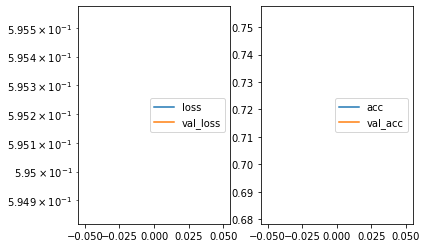

Predicted cell: Background Probability: [[0.9588167]]
True Cell type: Landmark
x [[0.5082179]]
True positional value x 0.421875
y [[0.5362072]]
True positional value y 0.578125


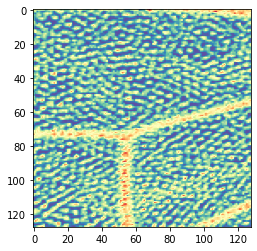

Epoch 2/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.4053 - acc: 0.8432 - val_loss: 0.3772 - val_acc: 0.8717

Epoch 00002: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.3771561076615583, 'val_acc': 0.8716577520982467, 'loss': 0.4052591364614317, 'acc': 0.8432036045911415, 'lr': 1e-04}


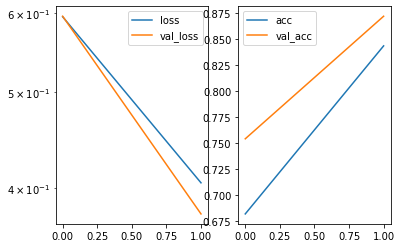

Predicted cell: Background Probability: [[0.75321645]]
True Cell type: Landmark
x [[0.50469816]]
True positional value x 0.421875
y [[0.46949947]]
True positional value y 0.578125


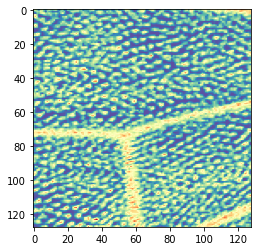

Epoch 3/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.2893 - acc: 0.9177 - val_loss: 0.4322 - val_acc: 0.8663

Epoch 00003: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.43223553816264965, 'val_acc': 0.8663101572403933, 'loss': 0.28927324475269833, 'acc': 0.9176536866049274, 'lr': 1e-04}


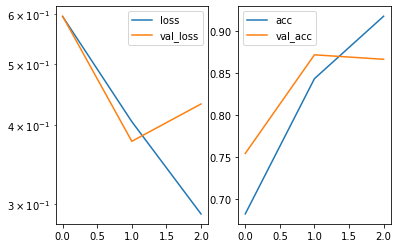

Predicted cell: Landmark Probability: [[0.9947508]]
True Cell type: Landmark
x [[0.61204416]]
True positional value x 0.578125
y [[0.43729344]]
True positional value y 0.421875


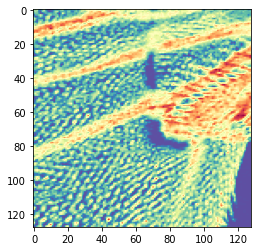

Epoch 4/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.2361 - acc: 0.9450 - val_loss: 0.2334 - val_acc: 0.9305

Epoch 00004: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.23337688723349953, 'val_acc': 0.9304812780038558, 'loss': 0.23613189801666204, 'acc': 0.9450084531771148, 'lr': 1e-04}


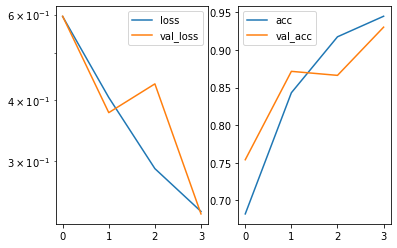

Predicted cell: Landmark Probability: [[0.97383285]]
True Cell type: Landmark
x [[0.6309897]]
True positional value x 0.5
y [[0.32912275]]
True positional value y 0.421875


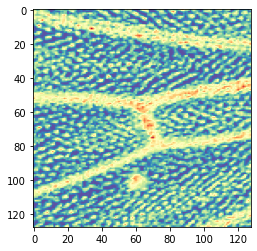

Epoch 5/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1957 - acc: 0.9608 - val_loss: 0.2249 - val_acc: 0.9572

Epoch 00005: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.22491095011884515, 'val_acc': 0.9572192443245873, 'loss': 0.1956665123409964, 'acc': 0.9608008962731811, 'lr': 1e-04}


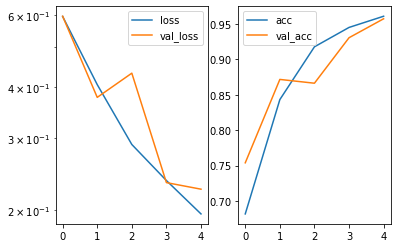

Predicted cell: Landmark Probability: [[0.9995989]]
True Cell type: Landmark
x [[0.5410945]]
True positional value x 0.421875
y [[0.519564]]
True positional value y 0.421875


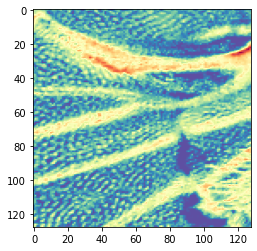

Epoch 6/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1526 - acc: 0.9831 - val_loss: 0.2079 - val_acc: 0.9626

Epoch 00006: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.20788666582043797, 'val_acc': 0.9625668391824406, 'loss': 0.15261597673787414, 'acc': 0.9830795232011179, 'lr': 1e-04}


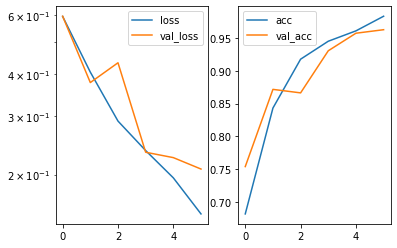

Predicted cell: Background Probability: [[0.9999186]]
True Cell type: Background
x [[0.5617849]]
True positional value x 0.5
y [[0.49836877]]
True positional value y 0.5


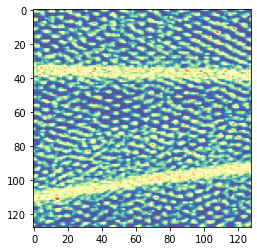

Epoch 7/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1290 - acc: 0.9898 - val_loss: 0.2016 - val_acc: 0.9679

Epoch 00007: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.20161045888528467, 'val_acc': 0.9679144308528799, 'loss': 0.12898980857236064, 'acc': 0.9898477138198168, 'lr': 1e-04}


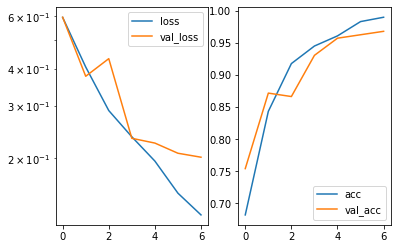

Predicted cell: Landmark Probability: [[0.999946]]
True Cell type: Landmark
x [[0.64716405]]
True positional value x 0.421875
y [[0.41072854]]
True positional value y 0.5


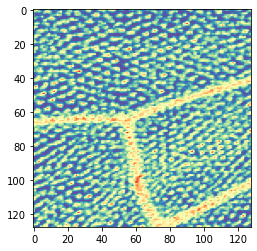

Epoch 8/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1302 - acc: 0.9884 - val_loss: 0.2267 - val_acc: 0.9519

Epoch 00008: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.2266939664110143, 'val_acc': 0.9518716462793197, 'loss': 0.13022918199928077, 'acc': 0.9884376738344419, 'lr': 1e-04}


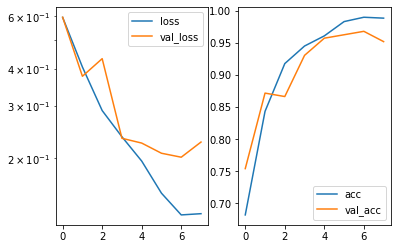

Predicted cell: Background Probability: [[0.99997187]]
True Cell type: Background
x [[0.4111696]]
True positional value x 0.5
y [[0.50670916]]
True positional value y 0.5


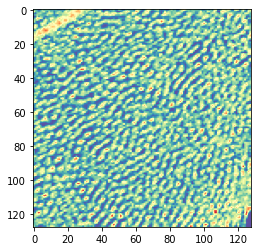

Epoch 9/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1163 - acc: 0.9932 - val_loss: 0.2728 - val_acc: 0.9519

Epoch 00009: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.272770567612852, 'val_acc': 0.9518716494667339, 'loss': 0.11629231494325605, 'acc': 0.9932318090451214, 'lr': 1e-04}


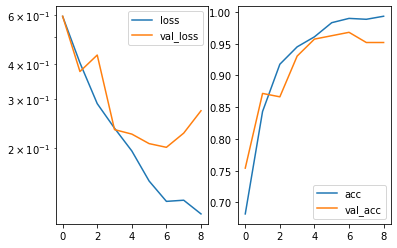

Predicted cell: Landmark Probability: [[0.99999]]
True Cell type: Landmark
x [[0.33764067]]
True positional value x 0.421875
y [[0.5585275]]
True positional value y 0.578125


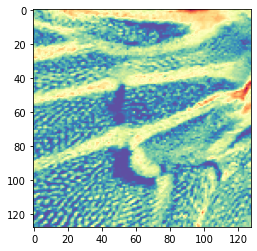

Epoch 10/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1068 - acc: 0.9969 - val_loss: 0.2306 - val_acc: 0.9572

Epoch 00010: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.23056242435692467, 'val_acc': 0.957219241137173, 'loss': 0.10680591333520931, 'acc': 0.9968979125700627, 'lr': 1e-04}


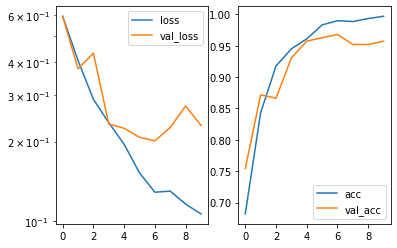

Predicted cell: Background Probability: [[0.99902034]]
True Cell type: Background
x [[0.68173856]]
True positional value x 0.5
y [[0.55738664]]
True positional value y 0.5


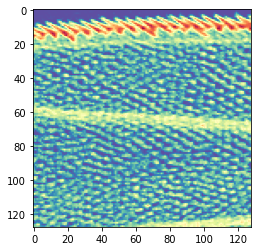

Epoch 11/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1018 - acc: 0.9983 - val_loss: 0.1933 - val_acc: 0.9733

Epoch 00011: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.19327088134652154, 'val_acc': 0.9732620257107332, 'loss': 0.10175137152055932, 'acc': 0.9983079522192579, 'lr': 1e-04}


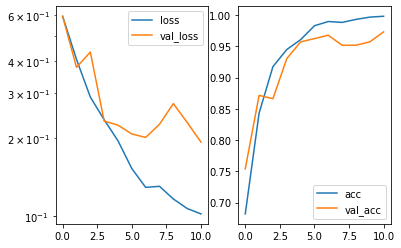

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.45997372]]
True positional value x 0.5
y [[0.5816093]]
True positional value y 0.5


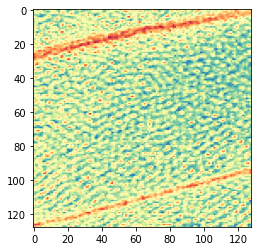

Epoch 12/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0958 - acc: 0.9997 - val_loss: 0.1824 - val_acc: 0.9786

Epoch 00012: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1824179358660856, 'val_acc': 0.9786096205685866, 'loss': 0.09580372305438804, 'acc': 0.999717992036543, 'lr': 1e-04}


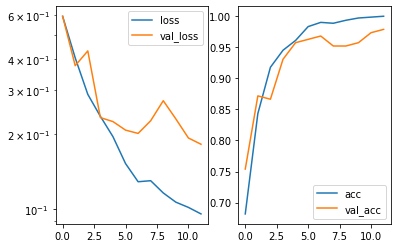

Predicted cell: Landmark Probability: [[0.99965405]]
True Cell type: Landmark
x [[0.4210102]]
True positional value x 0.421875
y [[0.4649619]]
True positional value y 0.5


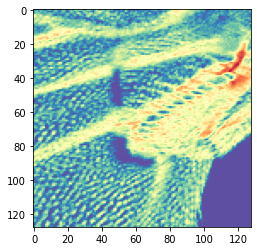

Epoch 13/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1065 - acc: 0.9958 - val_loss: 0.2028 - val_acc: 0.9786

Epoch 00013: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.20282565909910966, 'val_acc': 0.9786096237560007, 'loss': 0.10647412839577283, 'acc': 0.9957698805481447, 'lr': 1e-04}


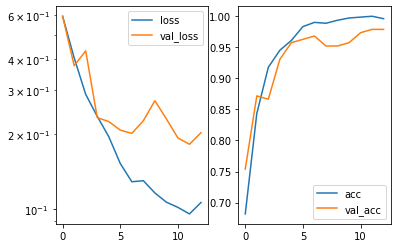

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.5024358]]
True positional value x 0.421875
y [[0.58044606]]
True positional value y 0.578125


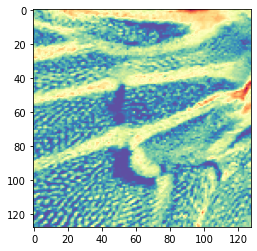

Epoch 14/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.1034 - acc: 0.9969 - val_loss: 0.1531 - val_acc: 0.9840

Epoch 00014: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15308984094125064, 'val_acc': 0.9839572154264399, 'loss': 0.10340673355432936, 'acc': 0.9968979124019728, 'lr': 1e-04}


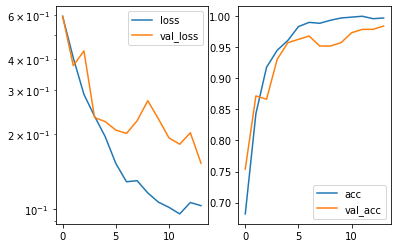

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.48547572]]
True positional value x 0.5
y [[0.4636584]]
True positional value y 0.5


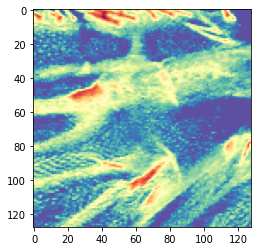

Epoch 15/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0964 - acc: 0.9989 - val_loss: 0.3188 - val_acc: 0.9626

Epoch 00015: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.31878709908634584, 'val_acc': 0.9625668359950265, 'loss': 0.09642936236362167, 'acc': 0.998871968146172, 'lr': 1e-04}


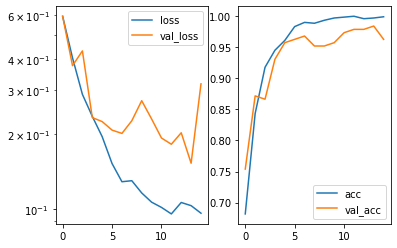

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.40627536]]
True positional value x 0.421875
y [[0.5876997]]
True positional value y 0.578125


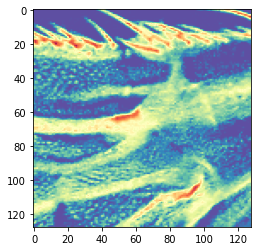

Epoch 16/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0948 - acc: 0.9997 - val_loss: 0.2732 - val_acc: 0.9679

Epoch 00016: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.2732108148502156, 'val_acc': 0.9679144308528799, 'loss': 0.09478540712252083, 'acc': 0.999717992036543, 'lr': 1e-04}


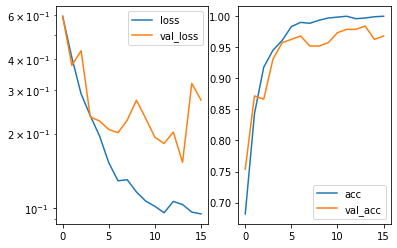

Predicted cell: Landmark Probability: [[0.9995505]]
True Cell type: Background
x [[0.43753445]]
True positional value x 0.5
y [[0.44556397]]
True positional value y 0.5


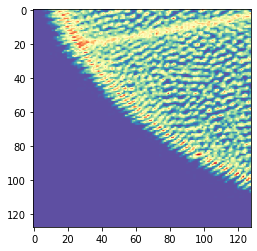

Epoch 17/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0932 - acc: 0.9997 - val_loss: 0.1799 - val_acc: 0.9840

Epoch 00017: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17988199453780995, 'val_acc': 0.9839572154264399, 'loss': 0.09321695375815664, 'acc': 0.999717992036543, 'lr': 1e-04}


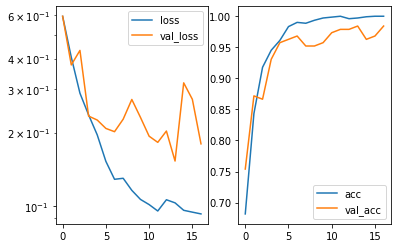

Predicted cell: Background Probability: [[0.9999975]]
True Cell type: Background
x [[0.44558093]]
True positional value x 0.5
y [[0.45698845]]
True positional value y 0.5


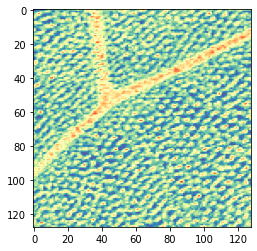

Epoch 18/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0915 - acc: 1.0000 - val_loss: 0.1810 - val_acc: 0.9840

Epoch 00018: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.18098018776605473, 'val_acc': 0.9839572154264399, 'loss': 0.09153527036536163, 'acc': 1.0, 'lr': 1e-04}


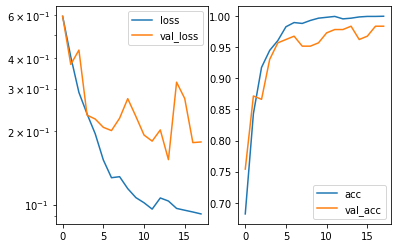

Predicted cell: Landmark Probability: [[0.9999943]]
True Cell type: Landmark
x [[0.47060823]]
True positional value x 0.421875
y [[0.5491932]]
True positional value y 0.578125


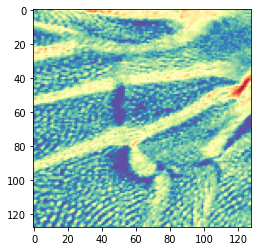

Epoch 19/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0908 - acc: 1.0000 - val_loss: 0.1755 - val_acc: 0.9840

Epoch 00019: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1754870748217093, 'val_acc': 0.9839572154264399, 'loss': 0.09084203960746946, 'acc': 1.0, 'lr': 1e-04}


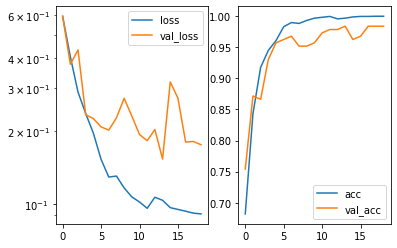

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5792016]]
True positional value x 0.5
y [[0.43783844]]
True positional value y 0.5


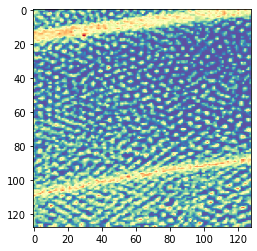

Epoch 20/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0903 - acc: 1.0000 - val_loss: 0.1764 - val_acc: 0.9840

Epoch 00020: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1763912577201976, 'val_acc': 0.9839572154264399, 'loss': 0.09029584315390622, 'acc': 1.0, 'lr': 1e-04}


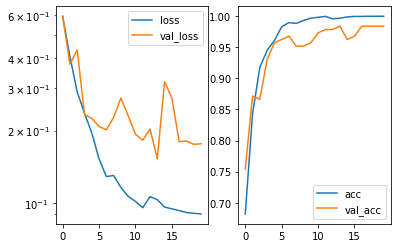

Predicted cell: Landmark Probability: [[0.99976116]]
True Cell type: Landmark
x [[0.4597361]]
True positional value x 0.421875
y [[0.51283246]]
True positional value y 0.5


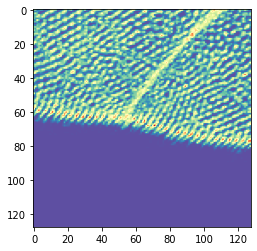

Epoch 21/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0900 - acc: 1.0000 - val_loss: 0.1783 - val_acc: 0.9733

Epoch 00021: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1783424420630868, 'val_acc': 0.9732620257107332, 'loss': 0.08996657796468832, 'acc': 1.0, 'lr': 1e-04}


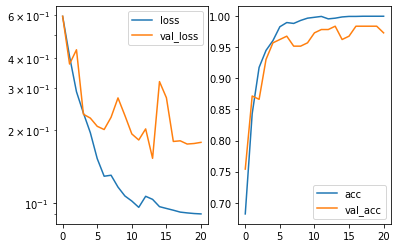

Predicted cell: Landmark Probability: [[0.9999993]]
True Cell type: Landmark
x [[0.50447893]]
True positional value x 0.5
y [[0.5230097]]
True positional value y 0.578125


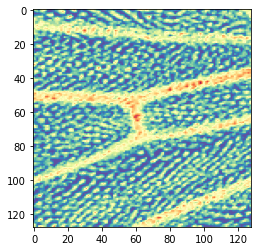

Epoch 22/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0897 - acc: 1.0000 - val_loss: 0.1782 - val_acc: 0.9840

Epoch 00022: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1781998651231674, 'val_acc': 0.9839572154264399, 'loss': 0.08965417506142787, 'acc': 1.0, 'lr': 1e-04}


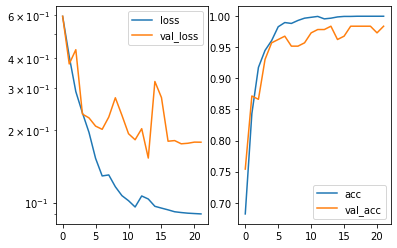

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.4007553]]
True positional value x 0.421875
y [[0.43484578]]
True positional value y 0.5


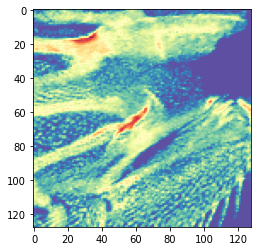

Epoch 23/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0894 - acc: 1.0000 - val_loss: 0.1727 - val_acc: 0.9786

Epoch 00023: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17268004885969315, 'val_acc': 0.9786096205685866, 'loss': 0.08944861373185976, 'acc': 1.0, 'lr': 1e-04}


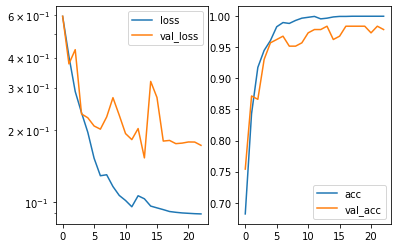

Predicted cell: Background Probability: [[0.9989943]]
True Cell type: Background
x [[0.56855005]]
True positional value x 0.5
y [[0.4997542]]
True positional value y 0.5


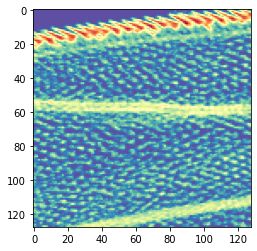

Epoch 24/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0893 - acc: 1.0000 - val_loss: 0.1769 - val_acc: 0.9786

Epoch 00024: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1768708958584357, 'val_acc': 0.9786096205685866, 'loss': 0.0892909811132047, 'acc': 1.0, 'lr': 1e-04}


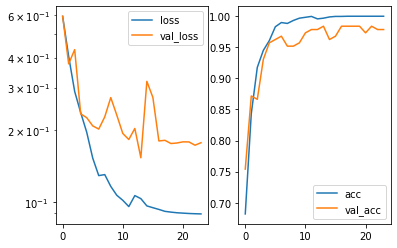

Predicted cell: Landmark Probability: [[0.9988438]]
True Cell type: Landmark
x [[0.5331679]]
True positional value x 0.5
y [[0.48327732]]
True positional value y 0.5


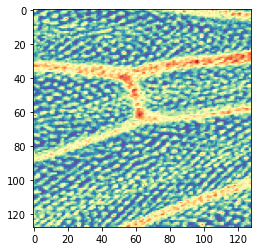

Epoch 25/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0891 - acc: 1.0000 - val_loss: 0.1793 - val_acc: 0.9840

Epoch 00025: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17934883955646963, 'val_acc': 0.9839572154264399, 'loss': 0.08911681819436111, 'acc': 1.0, 'lr': 1e-04}


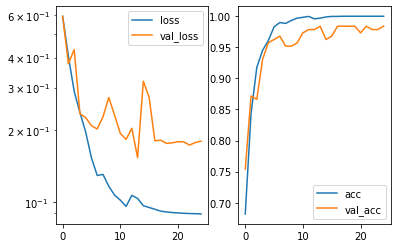

Predicted cell: Landmark Probability: [[0.99999475]]
True Cell type: Landmark
x [[0.47935215]]
True positional value x 0.5
y [[0.46608526]]
True positional value y 0.5


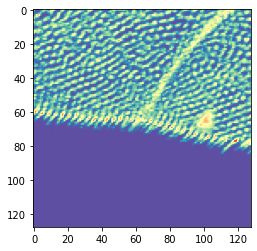

Epoch 26/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0888 - acc: 1.0000 - val_loss: 0.1774 - val_acc: 0.9733

Epoch 00026: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17741824714417126, 'val_acc': 0.9732620257107332, 'loss': 0.08882255507638342, 'acc': 1.0, 'lr': 1e-04}


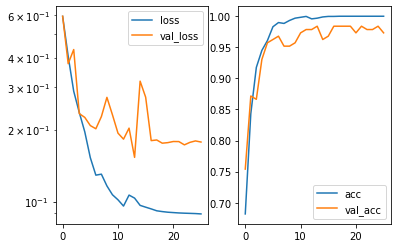

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.44635308]]
True positional value x 0.5
y [[0.49772954]]
True positional value y 0.5


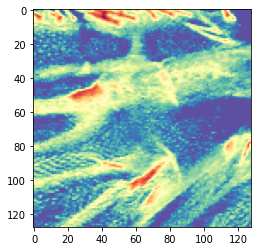

Epoch 27/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0888 - acc: 1.0000 - val_loss: 0.1749 - val_acc: 0.9786

Epoch 00027: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17494900676018413, 'val_acc': 0.9786096205685866, 'loss': 0.08879109588438551, 'acc': 1.0, 'lr': 1e-04}


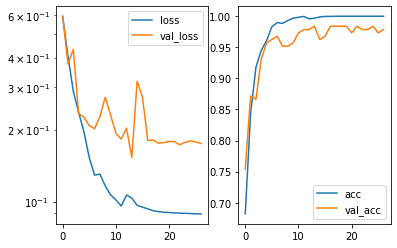

Predicted cell: Landmark Probability: [[0.87139505]]
True Cell type: Background
x [[0.47009784]]
True positional value x 0.5
y [[0.41513142]]
True positional value y 0.5


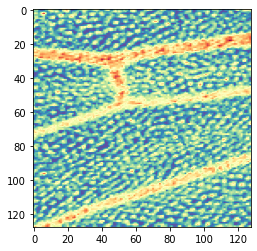

Epoch 28/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0887 - acc: 1.0000 - val_loss: 0.1956 - val_acc: 0.9733

Epoch 00028: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1956387354648687, 'val_acc': 0.9732620257107332, 'loss': 0.08866228284267, 'acc': 1.0, 'lr': 1e-04}


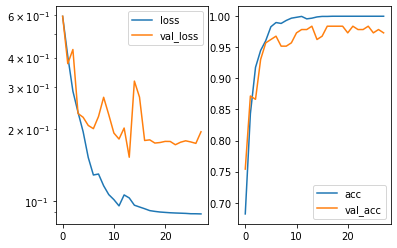

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.36225522]]
True positional value x 0.421875
y [[0.5358829]]
True positional value y 0.578125


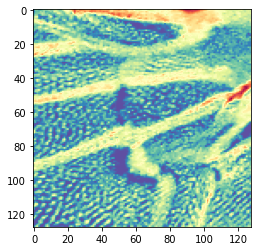

Epoch 29/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0883 - acc: 1.0000 - val_loss: 0.1797 - val_acc: 0.9840

Epoch 00029: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17966474218164535, 'val_acc': 0.9839572154264399, 'loss': 0.08825863012807623, 'acc': 1.0, 'lr': 1e-04}


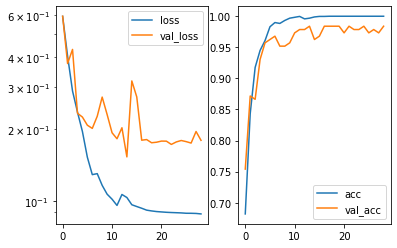

Predicted cell: Landmark Probability: [[0.9999933]]
True Cell type: Landmark
x [[0.60503095]]
True positional value x 0.5
y [[0.4708025]]
True positional value y 0.5


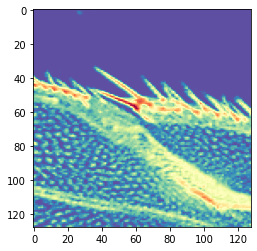

Epoch 30/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0881 - acc: 1.0000 - val_loss: 0.1751 - val_acc: 0.9786

Epoch 00030: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17505652716453063, 'val_acc': 0.9786096205685866, 'loss': 0.08805457487055224, 'acc': 1.0, 'lr': 1e-04}


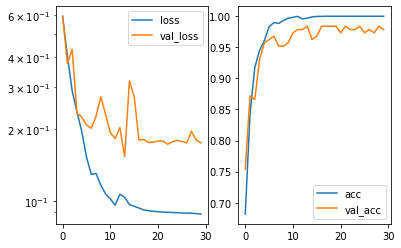

Predicted cell: Landmark Probability: [[0.9991849]]
True Cell type: Landmark
x [[0.45649207]]
True positional value x 0.421875
y [[0.3793217]]
True positional value y 0.5


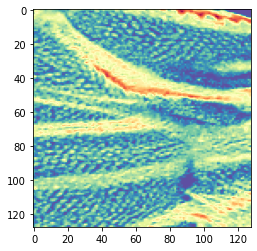

Epoch 31/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0879 - acc: 1.0000 - val_loss: 0.1808 - val_acc: 0.9840

Epoch 00031: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.18081438194781063, 'val_acc': 0.9839572154264399, 'loss': 0.08793931116139357, 'acc': 1.0, 'lr': 1e-04}


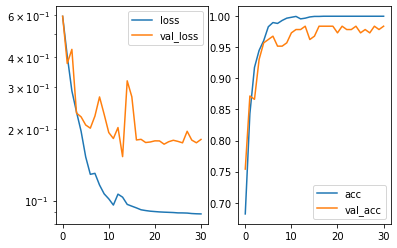

Predicted cell: Background Probability: [[0.9999999]]
True Cell type: Background
x [[0.51139486]]
True positional value x 0.5
y [[0.51830786]]
True positional value y 0.5


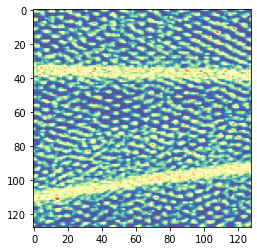

Epoch 32/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0878 - acc: 1.0000 - val_loss: 0.1763 - val_acc: 0.9786

Epoch 00032: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17627342256473347, 'val_acc': 0.9786096205685866, 'loss': 0.08778942903336737, 'acc': 1.0, 'lr': 1e-04}


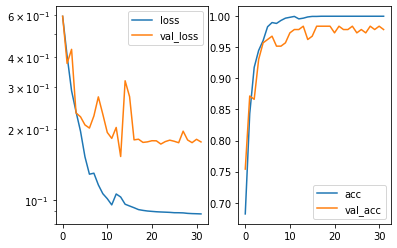

Predicted cell: Background Probability: [[0.99999905]]
True Cell type: Background
x [[0.48169342]]
True positional value x 0.5
y [[0.47694278]]
True positional value y 0.5


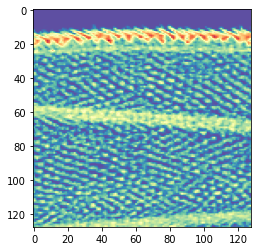

Epoch 33/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0876 - acc: 1.0000 - val_loss: 0.1745 - val_acc: 0.9786

Epoch 00033: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.174511494085113, 'val_acc': 0.9786096205685866, 'loss': 0.0876385446278577, 'acc': 1.0, 'lr': 1e-04}


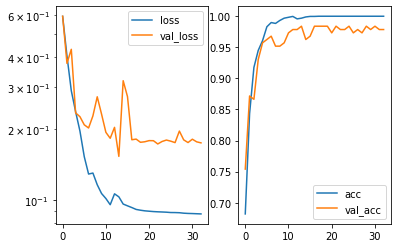

Predicted cell: Landmark Probability: [[0.9967788]]
True Cell type: Landmark
x [[0.4338283]]
True positional value x 0.421875
y [[0.47897083]]
True positional value y 0.5


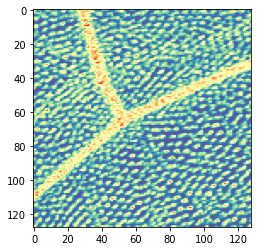

Epoch 34/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0875 - acc: 1.0000 - val_loss: 0.1790 - val_acc: 0.9840

Epoch 00034: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17901184381966923, 'val_acc': 0.9839572154264399, 'loss': 0.08751820269457311, 'acc': 1.0, 'lr': 1e-04}


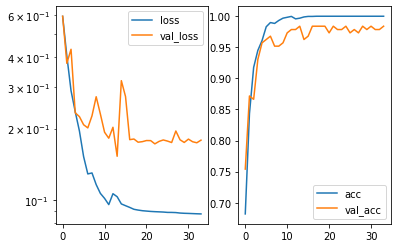

Predicted cell: Landmark Probability: [[0.999997]]
True Cell type: Landmark
x [[0.44821456]]
True positional value x 0.5
y [[0.4972388]]
True positional value y 0.5


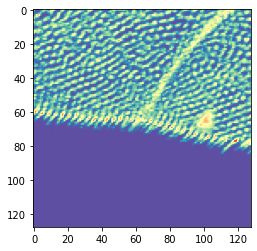

Epoch 35/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0874 - acc: 1.0000 - val_loss: 0.1786 - val_acc: 0.9840

Epoch 00035: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17856446633683168, 'val_acc': 0.9839572154264399, 'loss': 0.08738445349403243, 'acc': 1.0, 'lr': 1e-04}


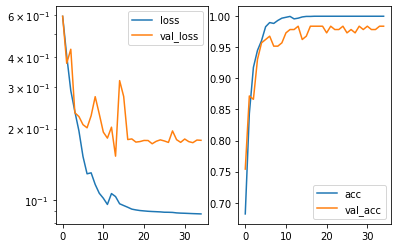

Predicted cell: Background Probability: [[0.9999565]]
True Cell type: Background
x [[0.50380516]]
True positional value x 0.5
y [[0.4885587]]
True positional value y 0.5


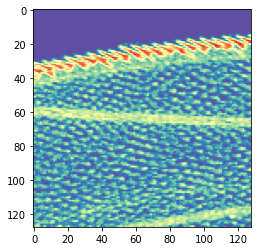

Epoch 36/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0872 - acc: 1.0000 - val_loss: 0.1763 - val_acc: 0.9786

Epoch 00036: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17632909386075116, 'val_acc': 0.9786096205685866, 'loss': 0.0872292551897504, 'acc': 1.0, 'lr': 1e-04}


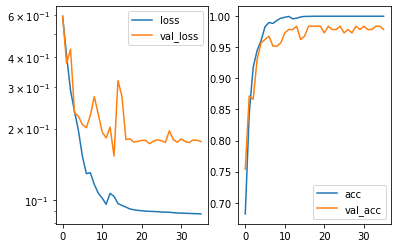

Predicted cell: Landmark Probability: [[0.9993293]]
True Cell type: Landmark
x [[0.52010995]]
True positional value x 0.578125
y [[0.5157555]]
True positional value y 0.578125


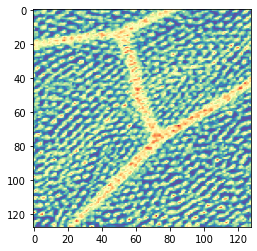

Epoch 37/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0871 - acc: 1.0000 - val_loss: 0.1745 - val_acc: 0.9786

Epoch 00037: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1744902679786325, 'val_acc': 0.9786096205685866, 'loss': 0.08707556880283544, 'acc': 1.0, 'lr': 1e-04}


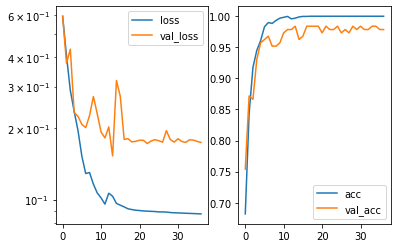

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5077664]]
True positional value x 0.5
y [[0.39096224]]
True positional value y 0.421875


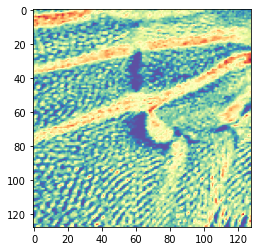

Epoch 38/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0872 - acc: 1.0000 - val_loss: 0.1811 - val_acc: 0.9733

Epoch 00038: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1810731572263381, 'val_acc': 0.9732620257107332, 'loss': 0.08719836880578473, 'acc': 1.0, 'lr': 1e-04}


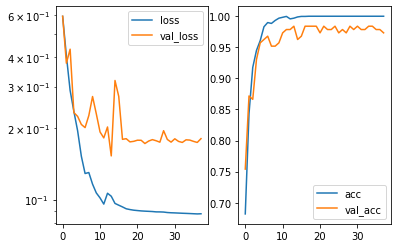

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.50287634]]
True positional value x 0.5
y [[0.45991316]]
True positional value y 0.5


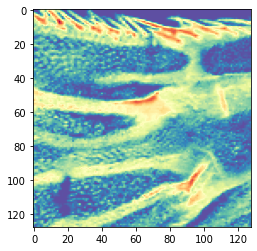

Epoch 39/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0868 - acc: 1.0000 - val_loss: 0.1767 - val_acc: 0.9733

Epoch 00039: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.176665022092707, 'val_acc': 0.9732620257107332, 'loss': 0.08682742051767617, 'acc': 1.0, 'lr': 1e-04}


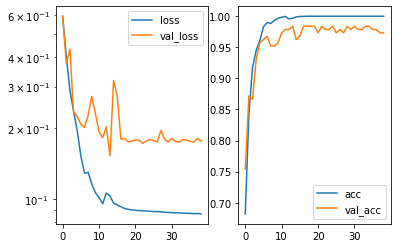

Predicted cell: Background Probability: [[0.99997187]]
True Cell type: Background
x [[0.52056974]]
True positional value x 0.5
y [[0.5067921]]
True positional value y 0.5


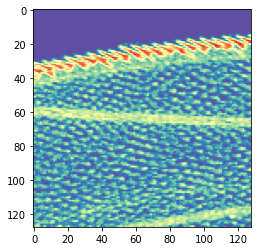

Epoch 40/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0867 - acc: 1.0000 - val_loss: 0.1720 - val_acc: 0.9840

Epoch 00040: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17204396004345326, 'val_acc': 0.9839572154264399, 'loss': 0.08668751409933921, 'acc': 1.0, 'lr': 1e-04}


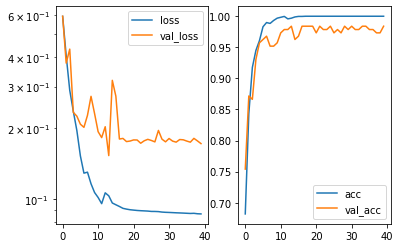

Predicted cell: Background Probability: [[0.99999714]]
True Cell type: Background
x [[0.5581531]]
True positional value x 0.5
y [[0.5008731]]
True positional value y 0.5


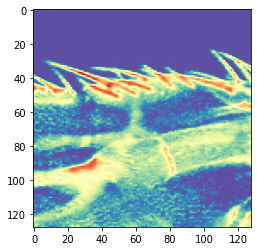

Epoch 41/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0866 - acc: 1.0000 - val_loss: 0.1749 - val_acc: 0.9786

Epoch 00041: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17492293534591236, 'val_acc': 0.9786096205685866, 'loss': 0.0866245572143736, 'acc': 1.0, 'lr': 1e-04}


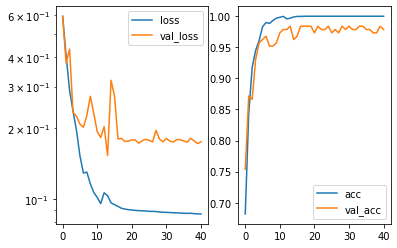

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.57557994]]
True positional value x 0.5
y [[0.45801276]]
True positional value y 0.5


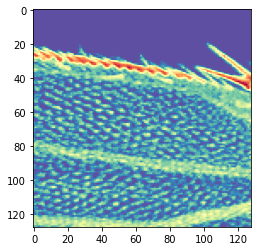

Epoch 42/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0865 - acc: 1.0000 - val_loss: 0.1768 - val_acc: 0.9786

Epoch 00042: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17684525757390548, 'val_acc': 0.9786096205685866, 'loss': 0.08649071972466295, 'acc': 1.0, 'lr': 1e-04}


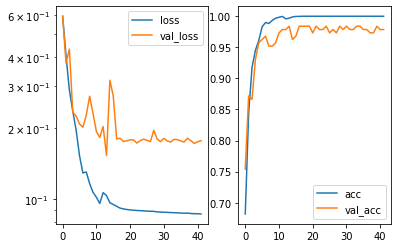

Predicted cell: Background Probability: [[0.99232423]]
True Cell type: Background
x [[0.46055067]]
True positional value x 0.5
y [[0.39008102]]
True positional value y 0.5


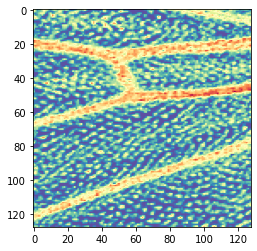

Epoch 43/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0863 - acc: 1.0000 - val_loss: 0.1743 - val_acc: 0.9840

Epoch 00043: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17434557961588876, 'val_acc': 0.9839572154264399, 'loss': 0.0862591091062279, 'acc': 1.0, 'lr': 1e-04}


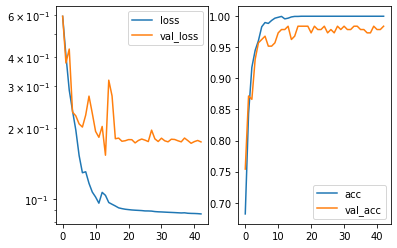

Predicted cell: Background Probability: [[0.8396016]]
True Cell type: Background
x [[0.4025958]]
True positional value x 0.5
y [[0.42328525]]
True positional value y 0.5


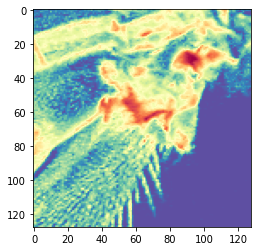

Epoch 44/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0865 - acc: 1.0000 - val_loss: 0.1701 - val_acc: 0.9786

Epoch 00044: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17011422381044072, 'val_acc': 0.9786096205685866, 'loss': 0.08648211855254331, 'acc': 1.0, 'lr': 1e-04}


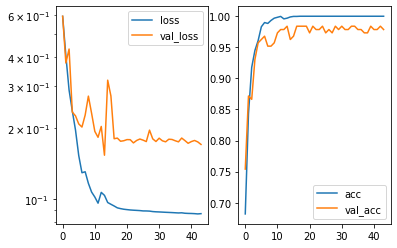

Predicted cell: Landmark Probability: [[0.9992041]]
True Cell type: Landmark
x [[0.57153976]]
True positional value x 0.578125
y [[0.5670928]]
True positional value y 0.578125


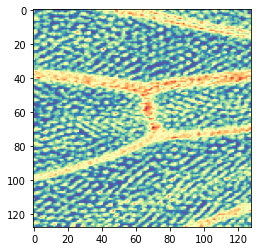

Epoch 45/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0861 - acc: 1.0000 - val_loss: 0.1727 - val_acc: 0.9786

Epoch 00045: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17269487300499237, 'val_acc': 0.9786096205685866, 'loss': 0.08609051744832337, 'acc': 1.0, 'lr': 1e-04}


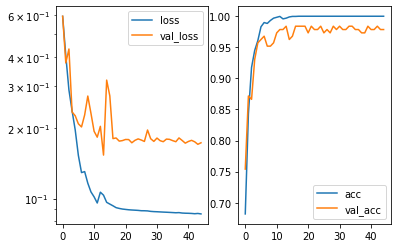

Predicted cell: Landmark Probability: [[0.99999344]]
True Cell type: Landmark
x [[0.46900633]]
True positional value x 0.5
y [[0.4835761]]
True positional value y 0.5


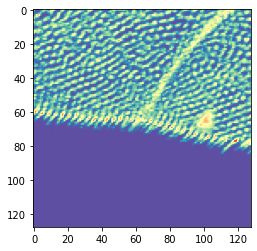

Epoch 46/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0859 - acc: 1.0000 - val_loss: 0.1710 - val_acc: 0.9786

Epoch 00046: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17101405369725456, 'val_acc': 0.9786096205685866, 'loss': 0.08589722393464047, 'acc': 1.0, 'lr': 1e-04}


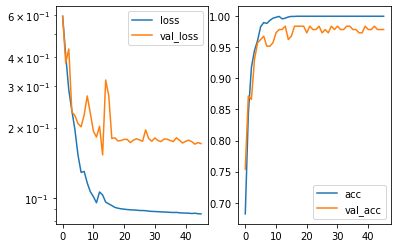

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.6061111]]
True positional value x 0.578125
y [[0.4691281]]
True positional value y 0.421875


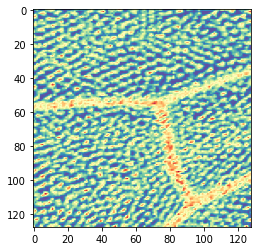

Epoch 47/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0858 - acc: 1.0000 - val_loss: 0.1714 - val_acc: 0.9840

Epoch 00047: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.171373122994275, 'val_acc': 0.9839572154264399, 'loss': 0.08579609344318904, 'acc': 1.0, 'lr': 1e-04}


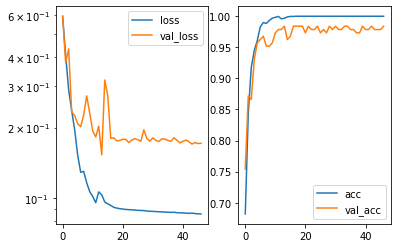

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.4682671]]
True positional value x 0.421875
y [[0.5731941]]
True positional value y 0.578125


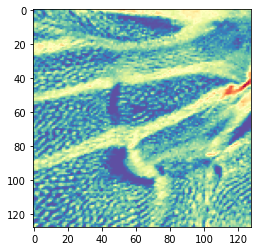

Epoch 48/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0857 - acc: 1.0000 - val_loss: 0.1674 - val_acc: 0.9840

Epoch 00048: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16741071091616216, 'val_acc': 0.9839572154264399, 'loss': 0.0856953098722857, 'acc': 1.0, 'lr': 1e-04}


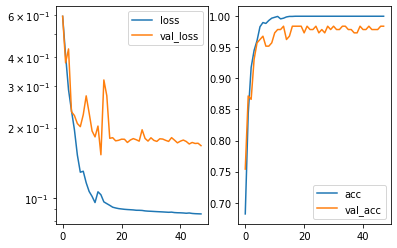

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.44164702]]
True positional value x 0.421875
y [[0.5956733]]
True positional value y 0.578125


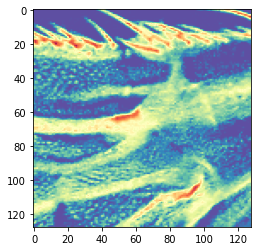

Epoch 49/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0855 - acc: 1.0000 - val_loss: 0.1719 - val_acc: 0.9786

Epoch 00049: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1718644395390934, 'val_acc': 0.9786096205685866, 'loss': 0.08551786346198204, 'acc': 1.0, 'lr': 1e-04}


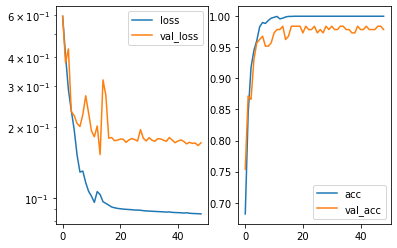

Predicted cell: Background Probability: [[0.9999523]]
True Cell type: Background
x [[0.52020645]]
True positional value x 0.5
y [[0.47936526]]
True positional value y 0.5


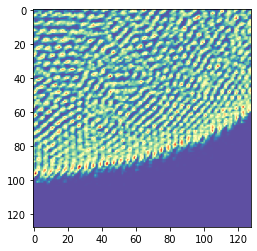

Epoch 50/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0854 - acc: 1.0000 - val_loss: 0.1743 - val_acc: 0.9840

Epoch 00050: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17427878145546838, 'val_acc': 0.9839572154264399, 'loss': 0.08536883570081558, 'acc': 1.0, 'lr': 1e-04}


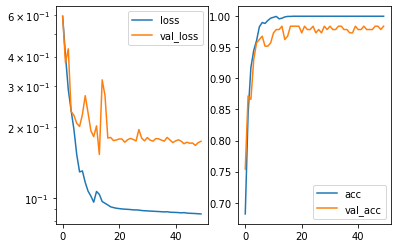

Predicted cell: Background Probability: [[0.99993813]]
True Cell type: Background
x [[0.4834603]]
True positional value x 0.5
y [[0.48524204]]
True positional value y 0.5


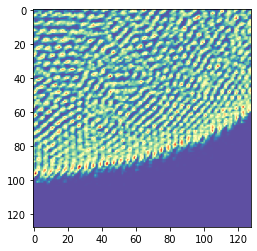

Epoch 51/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0852 - acc: 1.0000 - val_loss: 0.1755 - val_acc: 0.9786

Epoch 00051: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17546163555135064, 'val_acc': 0.9786096205685866, 'loss': 0.08524985891308276, 'acc': 1.0, 'lr': 1e-04}


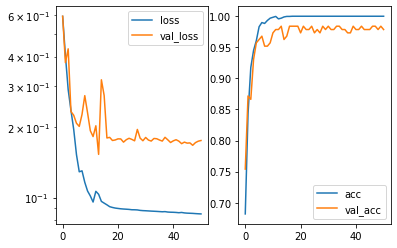

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.5354466]]
True positional value x 0.5
y [[0.5156777]]
True positional value y 0.578125


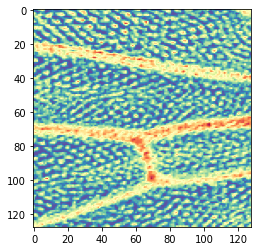

Epoch 52/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0851 - acc: 1.0000 - val_loss: 0.1718 - val_acc: 0.9840

Epoch 00052: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1717556477549242, 'val_acc': 0.9839572154264399, 'loss': 0.08512327332181979, 'acc': 1.0, 'lr': 1e-04}


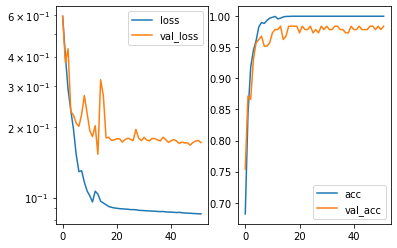

Predicted cell: Background Probability: [[0.99999857]]
True Cell type: Background
x [[0.5152872]]
True positional value x 0.5
y [[0.4458619]]
True positional value y 0.5


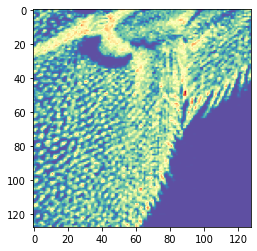

Epoch 53/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0850 - acc: 1.0000 - val_loss: 0.1733 - val_acc: 0.9840

Epoch 00053: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17332479887627025, 'val_acc': 0.9839572154264399, 'loss': 0.08501030375274372, 'acc': 1.0, 'lr': 1e-04}


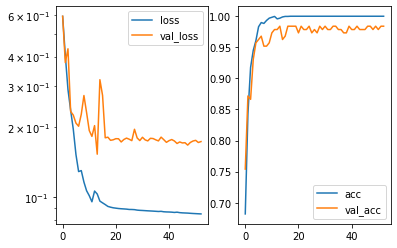

Predicted cell: Landmark Probability: [[0.9999994]]
True Cell type: Landmark
x [[0.4711203]]
True positional value x 0.421875
y [[0.48211694]]
True positional value y 0.421875


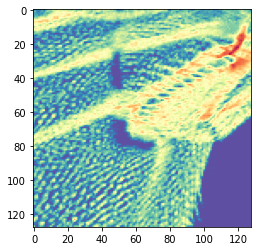

Epoch 54/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0850 - acc: 1.0000 - val_loss: 0.1622 - val_acc: 0.9786

Epoch 00054: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1622172680130617, 'val_acc': 0.9786096205685866, 'loss': 0.08497810149034805, 'acc': 1.0, 'lr': 1e-04}


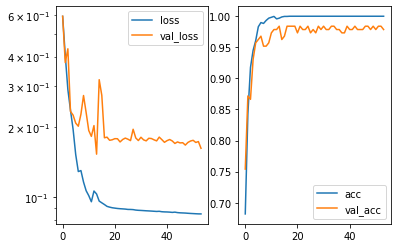

Predicted cell: Background Probability: [[0.9999683]]
True Cell type: Background
x [[0.57648426]]
True positional value x 0.5
y [[0.45738384]]
True positional value y 0.5


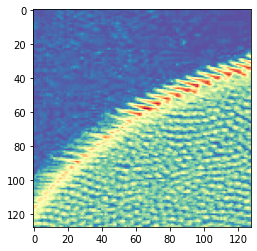

Epoch 55/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0848 - acc: 1.0000 - val_loss: 0.1748 - val_acc: 0.9840

Epoch 00055: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17478939882892977, 'val_acc': 0.9839572154264399, 'loss': 0.08482029672672166, 'acc': 1.0, 'lr': 1e-04}


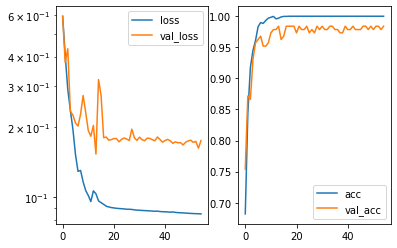

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5674246]]
True positional value x 0.5
y [[0.45608047]]
True positional value y 0.5


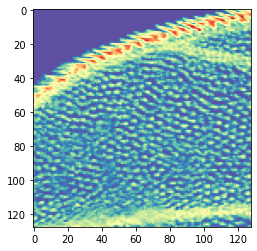

Epoch 56/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0847 - acc: 1.0000 - val_loss: 0.1661 - val_acc: 0.9840

Epoch 00056: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1660785372244483, 'val_acc': 0.9839572154264399, 'loss': 0.08467458583965048, 'acc': 1.0, 'lr': 1e-04}


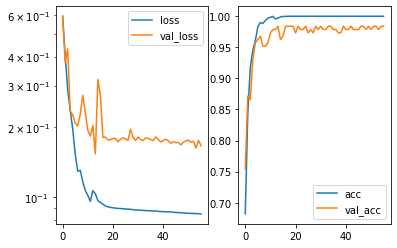

Predicted cell: Landmark Probability: [[0.99999774]]
True Cell type: Landmark
x [[0.59393835]]
True positional value x 0.5
y [[0.5669281]]
True positional value y 0.578125


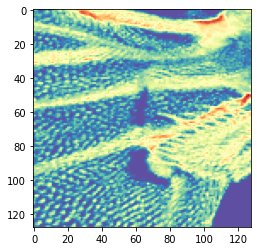

Epoch 57/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0846 - acc: 1.0000 - val_loss: 0.1696 - val_acc: 0.9840

Epoch 00057: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16964773164394706, 'val_acc': 0.9839572154264399, 'loss': 0.08457040896421762, 'acc': 1.0, 'lr': 1e-04}


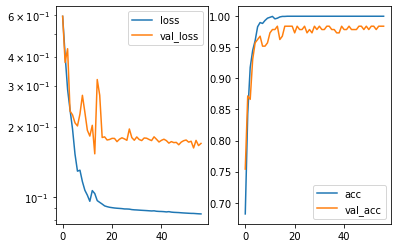

Predicted cell: Landmark Probability: [[0.99999166]]
True Cell type: Landmark
x [[0.53072137]]
True positional value x 0.578125
y [[0.45963827]]
True positional value y 0.578125


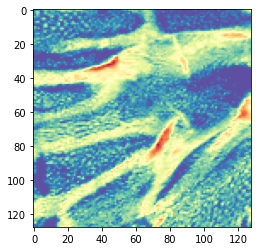

Epoch 58/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0844 - acc: 1.0000 - val_loss: 0.1740 - val_acc: 0.9840

Epoch 00058: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1740118536082181, 'val_acc': 0.9839572154264399, 'loss': 0.08439499363765432, 'acc': 1.0, 'lr': 1e-04}


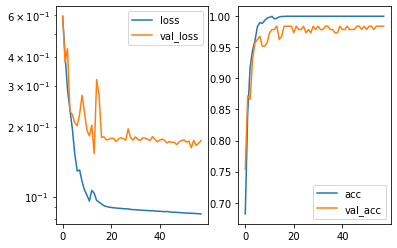

Predicted cell: Landmark Probability: [[0.9999988]]
True Cell type: Landmark
x [[0.40742213]]
True positional value x 0.421875
y [[0.56356204]]
True positional value y 0.578125


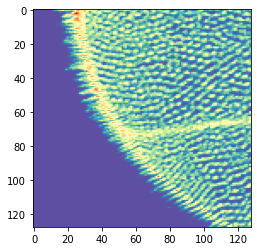

Epoch 59/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0843 - acc: 1.0000 - val_loss: 0.1683 - val_acc: 0.9840

Epoch 00059: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16833660532446468, 'val_acc': 0.9839572154264399, 'loss': 0.08434310605464786, 'acc': 1.0, 'lr': 1e-04}


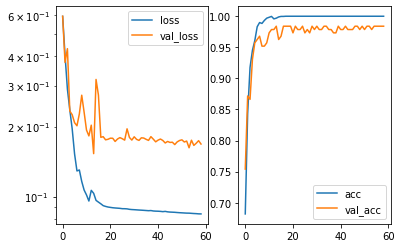

Predicted cell: Landmark Probability: [[0.9999887]]
True Cell type: Landmark
x [[0.65292746]]
True positional value x 0.578125
y [[0.5534477]]
True positional value y 0.578125


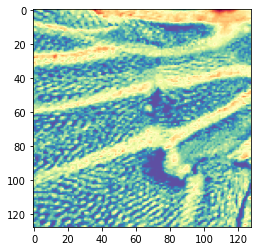

Epoch 60/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0842 - acc: 1.0000 - val_loss: 0.1717 - val_acc: 0.9840

Epoch 00060: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17174500816646107, 'val_acc': 0.9839572154264399, 'loss': 0.08415612175816946, 'acc': 1.0, 'lr': 1e-04}


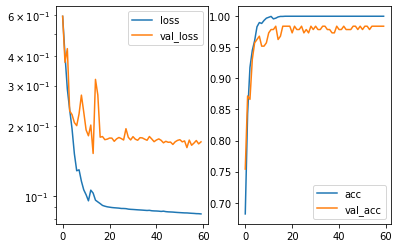

Predicted cell: Landmark Probability: [[0.99999857]]
True Cell type: Landmark
x [[0.6009888]]
True positional value x 0.5
y [[0.56498003]]
True positional value y 0.578125


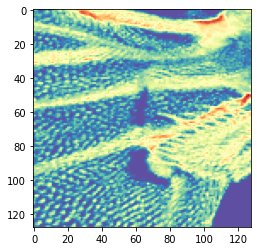

Epoch 61/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0840 - acc: 1.0000 - val_loss: 0.1747 - val_acc: 0.9840

Epoch 00061: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17466503760234559, 'val_acc': 0.9839572154264399, 'loss': 0.08402610373527265, 'acc': 1.0, 'lr': 1e-04}


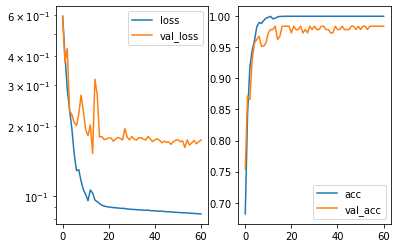

Predicted cell: Background Probability: [[0.99999785]]
True Cell type: Background
x [[0.5669265]]
True positional value x 0.5
y [[0.50553334]]
True positional value y 0.5


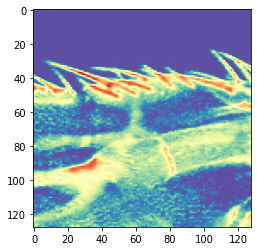

Epoch 62/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0839 - acc: 1.0000 - val_loss: 0.1784 - val_acc: 0.9840

Epoch 00062: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17842424903961426, 'val_acc': 0.9839572154264399, 'loss': 0.0838937916605404, 'acc': 1.0, 'lr': 1e-04}


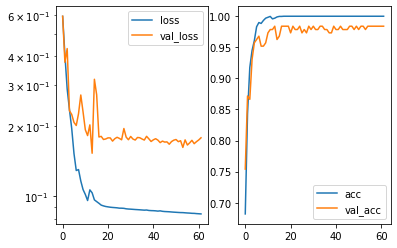

Predicted cell: Landmark Probability: [[0.99991596]]
True Cell type: Landmark
x [[0.61839473]]
True positional value x 0.578125
y [[0.5438322]]
True positional value y 0.578125


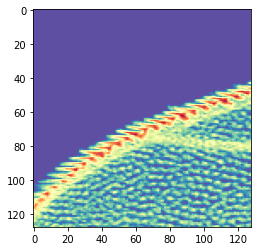

Epoch 63/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0838 - acc: 1.0000 - val_loss: 0.1688 - val_acc: 0.9840

Epoch 00063: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16882150114220093, 'val_acc': 0.9839572154264399, 'loss': 0.08375410339755657, 'acc': 1.0, 'lr': 1e-04}


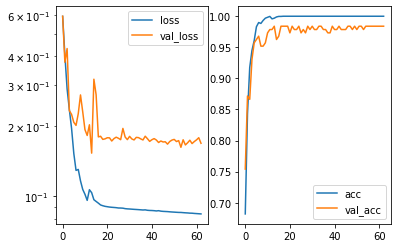

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48134875]]
True positional value x 0.5
y [[0.4798281]]
True positional value y 0.5


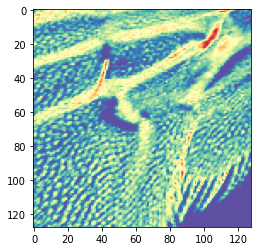

Epoch 64/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0837 - acc: 1.0000 - val_loss: 0.1698 - val_acc: 0.9786

Epoch 00064: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16975367136976935, 'val_acc': 0.9786096205685866, 'loss': 0.08366059571992053, 'acc': 1.0, 'lr': 1e-04}


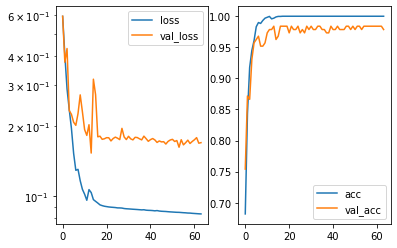

Predicted cell: Landmark Probability: [[0.9999987]]
True Cell type: Landmark
x [[0.58776665]]
True positional value x 0.5
y [[0.5724305]]
True positional value y 0.578125


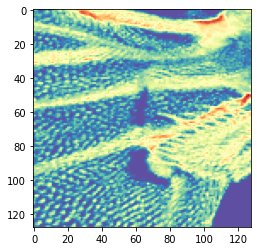

Epoch 65/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0835 - acc: 1.0000 - val_loss: 0.1666 - val_acc: 0.9840

Epoch 00065: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1665753762033534, 'val_acc': 0.9839572154264399, 'loss': 0.08354001085904783, 'acc': 1.0, 'lr': 1e-04}


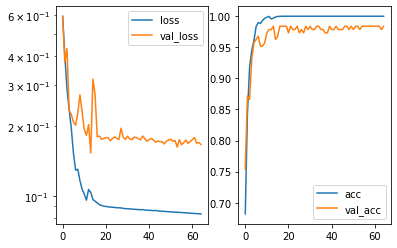

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.6178859]]
True positional value x 0.578125
y [[0.45979044]]
True positional value y 0.421875


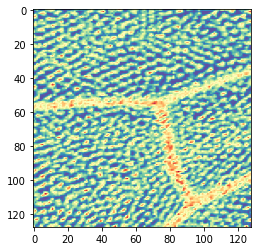

Epoch 66/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0834 - acc: 1.0000 - val_loss: 0.1672 - val_acc: 0.9786

Epoch 00066: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1672394968529436, 'val_acc': 0.9786096205685866, 'loss': 0.08344134767379588, 'acc': 1.0, 'lr': 1e-04}


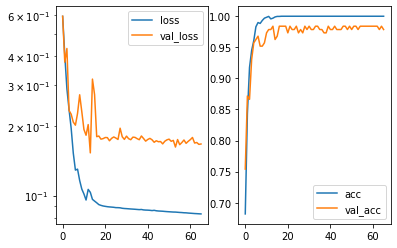

Predicted cell: Landmark Probability: [[0.999998]]
True Cell type: Landmark
x [[0.5786777]]
True positional value x 0.578125
y [[0.40624222]]
True positional value y 0.421875


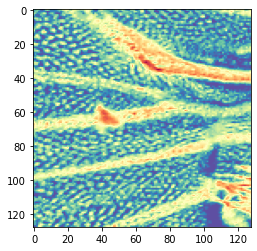

Epoch 67/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0833 - acc: 1.0000 - val_loss: 0.1733 - val_acc: 0.9786

Epoch 00067: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17329562212375396, 'val_acc': 0.9786096205685866, 'loss': 0.0833039377588575, 'acc': 1.0, 'lr': 1e-04}


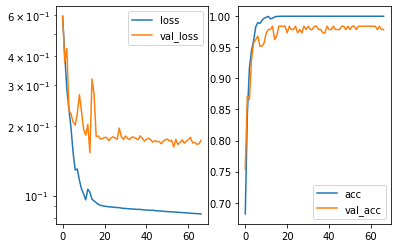

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.6108096]]
True positional value x 0.578125
y [[0.51733744]]
True positional value y 0.5


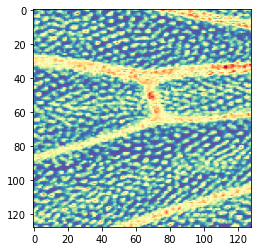

Epoch 68/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0832 - acc: 1.0000 - val_loss: 0.1677 - val_acc: 0.9840

Epoch 00068: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16767883408356477, 'val_acc': 0.9839572154264399, 'loss': 0.08315457107821764, 'acc': 1.0, 'lr': 1e-04}


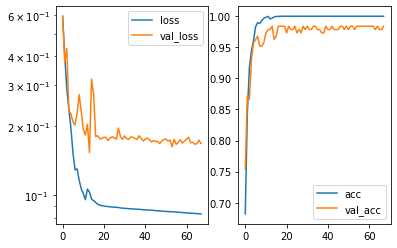

Predicted cell: Background Probability: [[0.9999962]]
True Cell type: Background
x [[0.50233054]]
True positional value x 0.5
y [[0.46674156]]
True positional value y 0.5


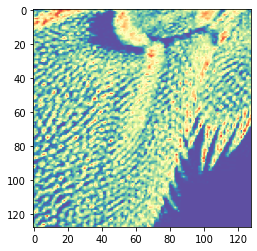

Epoch 69/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0831 - acc: 1.0000 - val_loss: 0.1746 - val_acc: 0.9840

Epoch 00069: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17458578043761738, 'val_acc': 0.9839572154264399, 'loss': 0.08305038063793753, 'acc': 1.0, 'lr': 1e-04}


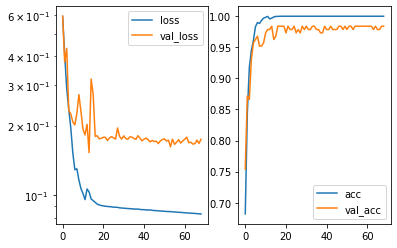

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4939275]]
True positional value x 0.5
y [[0.5143655]]
True positional value y 0.5


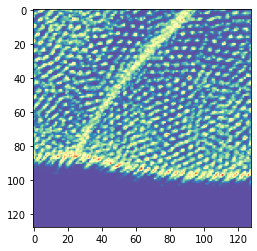

Epoch 70/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0829 - acc: 1.0000 - val_loss: 0.1689 - val_acc: 0.9840

Epoch 00070: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16887830891073707, 'val_acc': 0.9839572154264399, 'loss': 0.08292409211598879, 'acc': 1.0, 'lr': 1e-04}


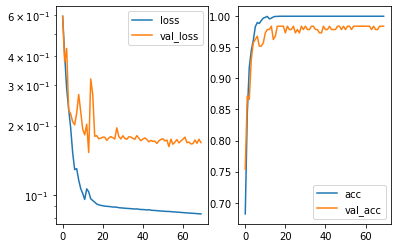

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52013427]]
True positional value x 0.5
y [[0.48004854]]
True positional value y 0.5


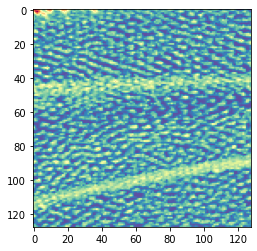

Epoch 71/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0828 - acc: 1.0000 - val_loss: 0.1702 - val_acc: 0.9840

Epoch 00071: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17024565990117782, 'val_acc': 0.9839572154264399, 'loss': 0.08280479417167272, 'acc': 1.0, 'lr': 1e-04}


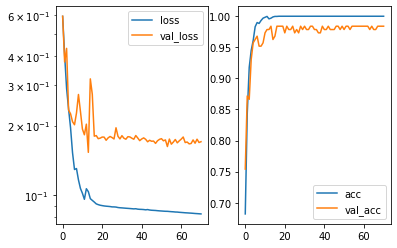

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.49990293]]
True positional value x 0.5
y [[0.5305351]]
True positional value y 0.421875


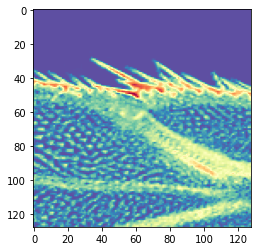

Epoch 72/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0827 - acc: 1.0000 - val_loss: 0.1669 - val_acc: 0.9786

Epoch 00072: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1669064513980386, 'val_acc': 0.9786096205685866, 'loss': 0.08269195769610407, 'acc': 1.0, 'lr': 1e-04}


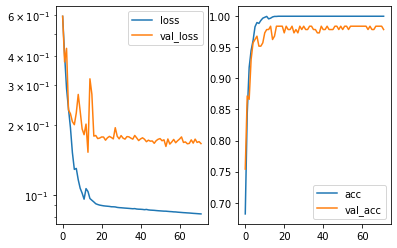

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5041145]]
True positional value x 0.5
y [[0.5190778]]
True positional value y 0.5


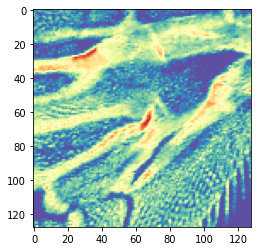

Epoch 73/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0826 - acc: 1.0000 - val_loss: 0.1723 - val_acc: 0.9840

Epoch 00073: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1722813478128158, 'val_acc': 0.9839572154264399, 'loss': 0.082605265992816, 'acc': 1.0, 'lr': 1e-04}


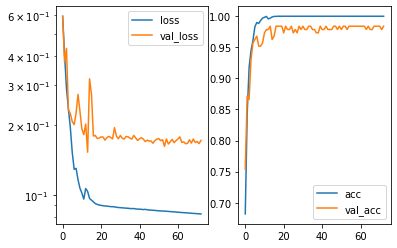

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4347083]]
True positional value x 0.421875
y [[0.5975178]]
True positional value y 0.578125


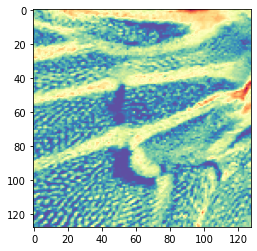

Epoch 74/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0825 - acc: 1.0000 - val_loss: 0.1702 - val_acc: 0.9840

Epoch 00074: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17018949770353695, 'val_acc': 0.9839572154264399, 'loss': 0.08248924360191896, 'acc': 1.0, 'lr': 1e-04}


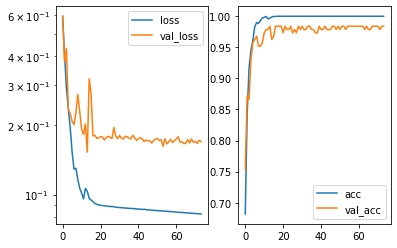

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5187261]]
True positional value x 0.5
y [[0.4948689]]
True positional value y 0.5


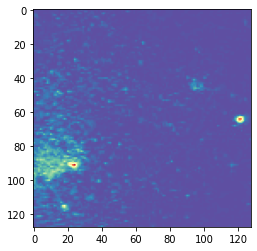

Epoch 75/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0824 - acc: 1.0000 - val_loss: 0.1677 - val_acc: 0.9786

Epoch 00075: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16767504998547508, 'val_acc': 0.9786096205685866, 'loss': 0.08235295373658574, 'acc': 1.0, 'lr': 1e-04}


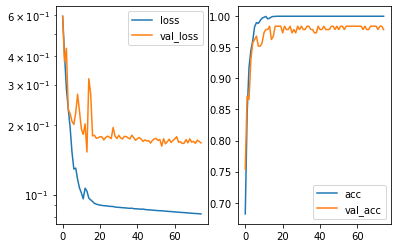

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5541613]]
True positional value x 0.578125
y [[0.4994357]]
True positional value y 0.421875


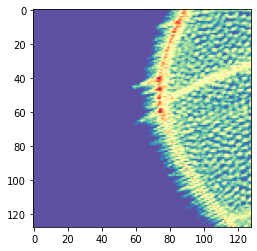

Epoch 76/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0822 - acc: 1.0000 - val_loss: 0.1675 - val_acc: 0.9840

Epoch 00076: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1674837048519104, 'val_acc': 0.9839572154264399, 'loss': 0.08222153363880705, 'acc': 1.0, 'lr': 1e-04}


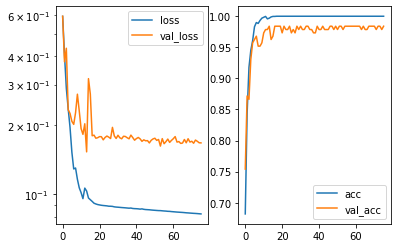

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49515215]]
True positional value x 0.5
y [[0.531966]]
True positional value y 0.578125


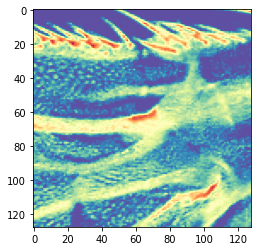

Epoch 77/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0822 - acc: 1.0000 - val_loss: 0.1768 - val_acc: 0.9786

Epoch 00077: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17677119816528922, 'val_acc': 0.9786096205685866, 'loss': 0.0821979315778124, 'acc': 1.0, 'lr': 1e-04}


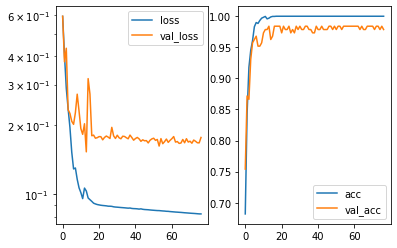

Predicted cell: Landmark Probability: [[0.9994795]]
True Cell type: Landmark
x [[0.5142547]]
True positional value x 0.578125
y [[0.5145811]]
True positional value y 0.578125


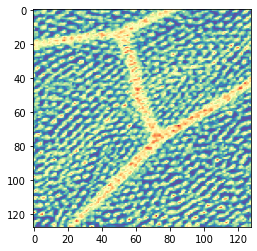

Epoch 78/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0820 - acc: 1.0000 - val_loss: 0.1640 - val_acc: 0.9840

Epoch 00078: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16396270062834184, 'val_acc': 0.9839572154264399, 'loss': 0.08199950324416631, 'acc': 1.0, 'lr': 1e-04}


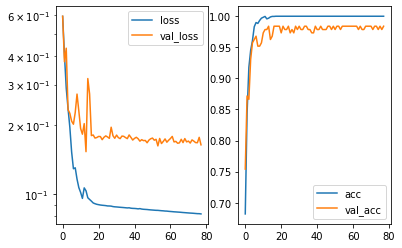

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5531621]]
True positional value x 0.578125
y [[0.55519587]]
True positional value y 0.5


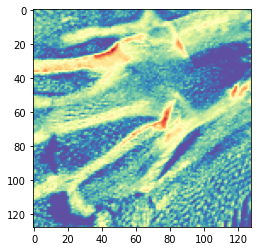

Epoch 79/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0819 - acc: 1.0000 - val_loss: 0.1670 - val_acc: 0.9840

Epoch 00079: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16698340334516157, 'val_acc': 0.9839572154264399, 'loss': 0.08188440794838531, 'acc': 1.0, 'lr': 1e-04}


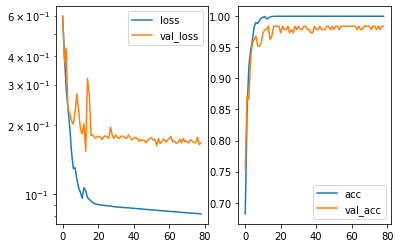

Predicted cell: Background Probability: [[0.9919905]]
True Cell type: Background
x [[0.41513196]]
True positional value x 0.5
y [[0.48698992]]
True positional value y 0.5


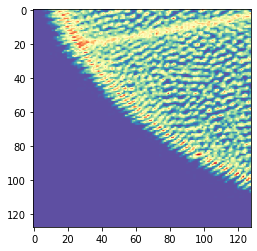

Epoch 80/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0818 - acc: 1.0000 - val_loss: 0.1689 - val_acc: 0.9786

Epoch 00080: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16886268101911495, 'val_acc': 0.9786096205685866, 'loss': 0.0817920306914954, 'acc': 1.0, 'lr': 1e-04}


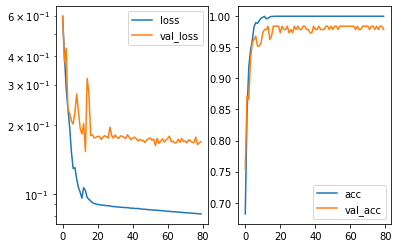

Predicted cell: Landmark Probability: [[0.9999964]]
True Cell type: Landmark
x [[0.5467425]]
True positional value x 0.578125
y [[0.47833768]]
True positional value y 0.578125


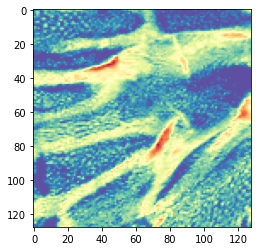

Epoch 81/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0817 - acc: 1.0000 - val_loss: 0.1670 - val_acc: 0.9840

Epoch 00081: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16702971420186088, 'val_acc': 0.9839572154264399, 'loss': 0.08166113529024457, 'acc': 1.0, 'lr': 1e-04}


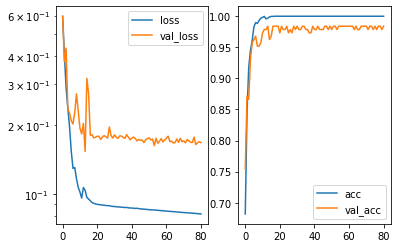

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.55503064]]
True positional value x 0.578125
y [[0.5044598]]
True positional value y 0.5


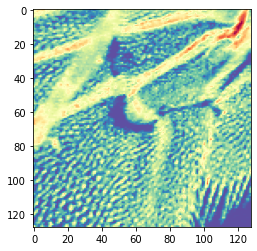

Epoch 82/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0816 - acc: 1.0000 - val_loss: 0.1676 - val_acc: 0.9840

Epoch 00082: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16757533527950552, 'val_acc': 0.9839572154264399, 'loss': 0.08156222983295475, 'acc': 1.0, 'lr': 1e-04}


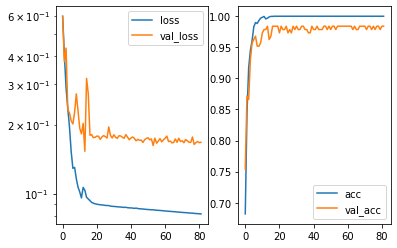

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.44007844]]
True positional value x 0.5
y [[0.41526353]]
True positional value y 0.5


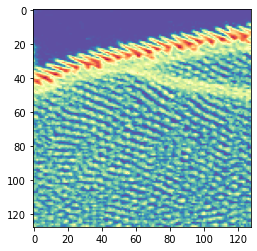

Epoch 83/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0814 - acc: 1.0000 - val_loss: 0.1700 - val_acc: 0.9786

Epoch 00083: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17002522491197536, 'val_acc': 0.9786096205685866, 'loss': 0.08144517466467918, 'acc': 1.0, 'lr': 1e-04}


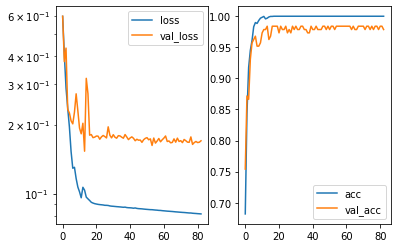

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.40433535]]
True positional value x 0.421875
y [[0.51398414]]
True positional value y 0.5


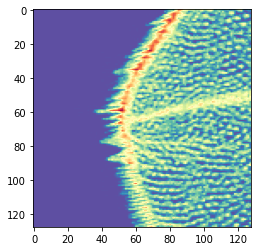

Epoch 84/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0813 - acc: 1.0000 - val_loss: 0.1644 - val_acc: 0.9786

Epoch 00084: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16443559383963519, 'val_acc': 0.9786096205685866, 'loss': 0.08132020493751856, 'acc': 1.0, 'lr': 1e-04}


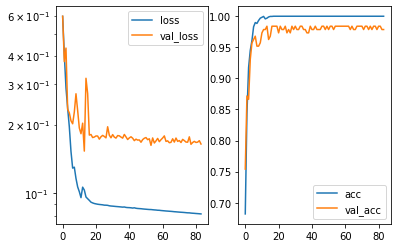

Predicted cell: Landmark Probability: [[0.9999558]]
True Cell type: Landmark
x [[0.51019645]]
True positional value x 0.5
y [[0.5588206]]
True positional value y 0.578125


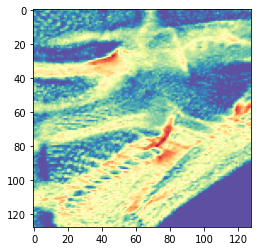

Epoch 85/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0813 - acc: 1.0000 - val_loss: 0.1651 - val_acc: 0.9840

Epoch 00085: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16514273780711833, 'val_acc': 0.9839572154264399, 'loss': 0.08125099659940985, 'acc': 1.0, 'lr': 1e-04}


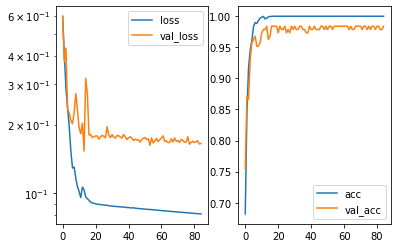

Predicted cell: Landmark Probability: [[0.999874]]
True Cell type: Landmark
x [[0.5147666]]
True positional value x 0.5
y [[0.5518901]]
True positional value y 0.578125


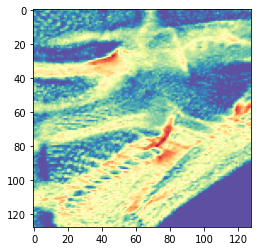

Epoch 86/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0811 - acc: 1.0000 - val_loss: 0.1701 - val_acc: 0.9840

Epoch 00086: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17005604648972578, 'val_acc': 0.9839572154264399, 'loss': 0.0810821793187626, 'acc': 1.0, 'lr': 1e-04}


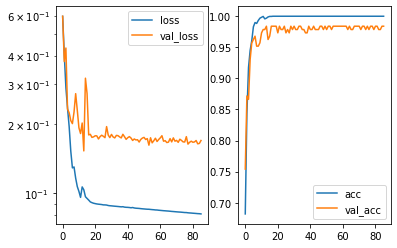

Predicted cell: Background Probability: [[0.96646804]]
True Cell type: Background
x [[0.44184744]]
True positional value x 0.5
y [[0.54382545]]
True positional value y 0.5


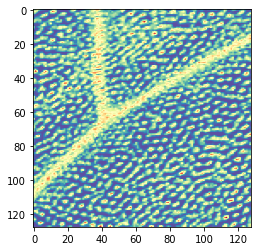

Epoch 87/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0810 - acc: 1.0000 - val_loss: 0.1623 - val_acc: 0.9840

Epoch 00087: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16227993050361061, 'val_acc': 0.9839572154264399, 'loss': 0.08101392017117477, 'acc': 1.0, 'lr': 1e-04}


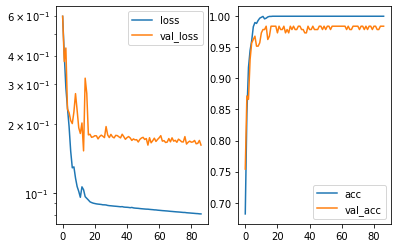

Predicted cell: Landmark Probability: [[0.9999964]]
True Cell type: Landmark
x [[0.4063723]]
True positional value x 0.421875
y [[0.4834]]
True positional value y 0.5


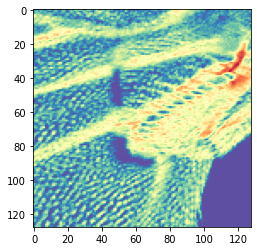

Epoch 88/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0809 - acc: 1.0000 - val_loss: 0.1633 - val_acc: 0.9840

Epoch 00088: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16332648559050125, 'val_acc': 0.9839572154264399, 'loss': 0.08088278460741312, 'acc': 1.0, 'lr': 1e-04}


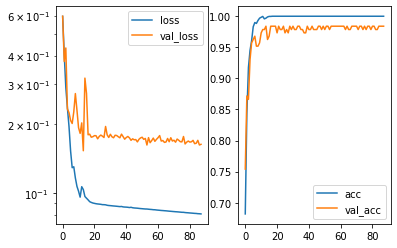

Predicted cell: Landmark Probability: [[0.9645849]]
True Cell type: Landmark
x [[0.47861624]]
True positional value x 0.421875
y [[0.5664258]]
True positional value y 0.578125


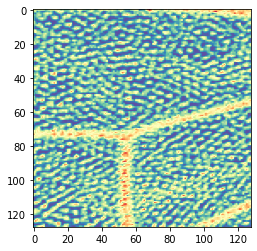

Epoch 89/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0807 - acc: 1.0000 - val_loss: 0.1678 - val_acc: 0.9840

Epoch 00089: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16779485320981175, 'val_acc': 0.9839572154264399, 'loss': 0.0807498975058632, 'acc': 1.0, 'lr': 1e-04}


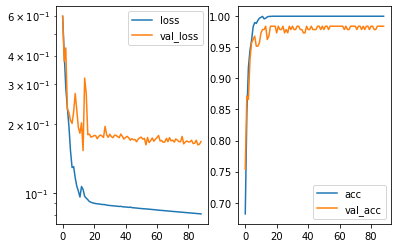

Predicted cell: Background Probability: [[0.99845994]]
True Cell type: Background
x [[0.53148985]]
True positional value x 0.5
y [[0.4499274]]
True positional value y 0.5


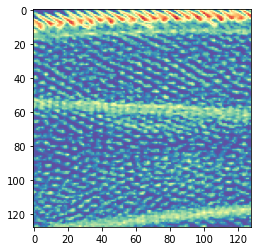

Epoch 90/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0807 - acc: 1.0000 - val_loss: 0.1679 - val_acc: 0.9840

Epoch 00090: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16788572288133244, 'val_acc': 0.9839572154264399, 'loss': 0.08065618321223912, 'acc': 1.0, 'lr': 1e-04}


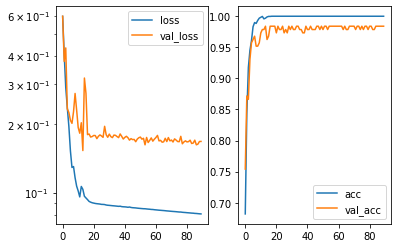

Predicted cell: Landmark Probability: [[0.9831277]]
True Cell type: Landmark
x [[0.44431657]]
True positional value x 0.421875
y [[0.5234625]]
True positional value y 0.5


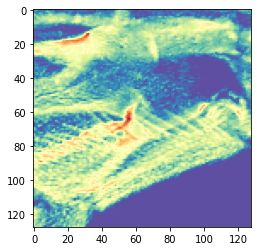

Epoch 91/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0806 - acc: 1.0000 - val_loss: 0.1569 - val_acc: 0.9840

Epoch 00091: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1569060955375911, 'val_acc': 0.9839572154264399, 'loss': 0.08055691765616052, 'acc': 1.0, 'lr': 1e-04}


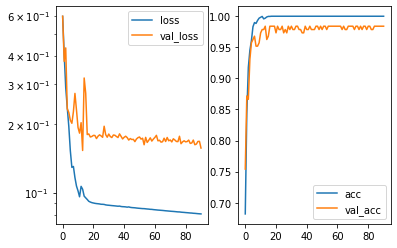

Predicted cell: Landmark Probability: [[0.99999094]]
True Cell type: Landmark
x [[0.4929956]]
True positional value x 0.421875
y [[0.55254734]]
True positional value y 0.578125


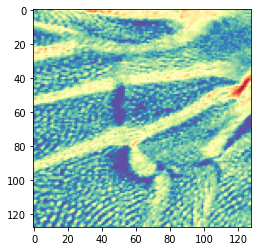

Epoch 92/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0804 - acc: 1.0000 - val_loss: 0.1661 - val_acc: 0.9786

Epoch 00092: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16611109936938567, 'val_acc': 0.9786096205685866, 'loss': 0.08040876154989021, 'acc': 1.0, 'lr': 1e-04}


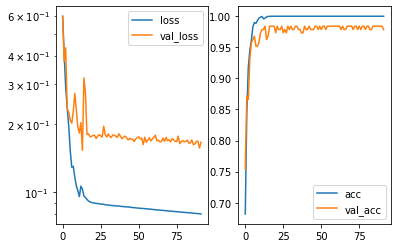

Predicted cell: Landmark Probability: [[0.9298619]]
True Cell type: Background
x [[0.49657056]]
True positional value x 0.5
y [[0.50602376]]
True positional value y 0.5


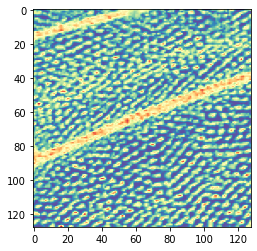

Epoch 93/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0803 - acc: 1.0000 - val_loss: 0.1657 - val_acc: 0.9840

Epoch 00093: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16573699683269716, 'val_acc': 0.9839572154264399, 'loss': 0.08028721258893097, 'acc': 1.0, 'lr': 1e-04}


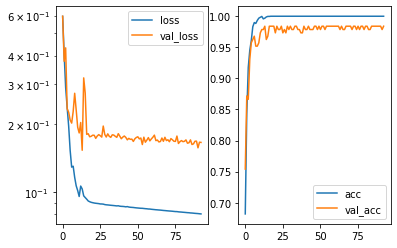

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.47525057]]
True positional value x 0.421875
y [[0.4448599]]
True positional value y 0.421875


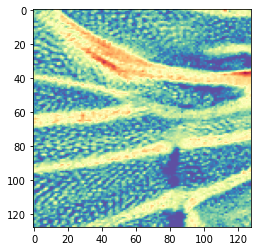

Epoch 94/250
3546/3546 [==============================] - 14s 4ms/step - loss: 0.0802 - acc: 1.0000 - val_loss: 0.1647 - val_acc: 0.9840

Epoch 00094: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16469787443704145, 'val_acc': 0.9839572154264399, 'loss': 0.08016840061325174, 'acc': 1.0, 'lr': 1e-04}


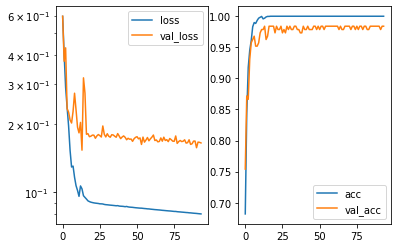

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5482849]]
True positional value x 0.578125
y [[0.42363402]]
True positional value y 0.5


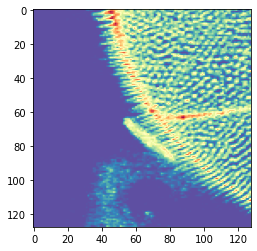

Epoch 95/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0801 - acc: 1.0000 - val_loss: 0.1666 - val_acc: 0.9786

Epoch 00095: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1666402536280015, 'val_acc': 0.9786096205685866, 'loss': 0.08005703710023791, 'acc': 1.0, 'lr': 1e-04}


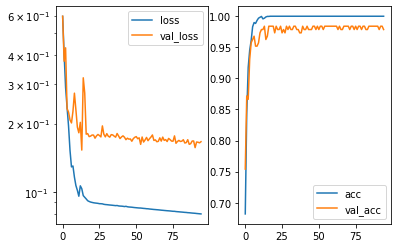

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.56569016]]
True positional value x 0.5
y [[0.48115686]]
True positional value y 0.5


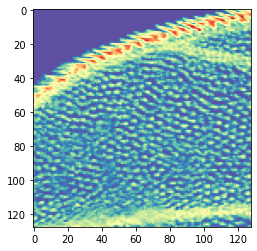

Epoch 96/250
3546/3546 [==============================] - 14s 4ms/step - loss: 0.0799 - acc: 1.0000 - val_loss: 0.1660 - val_acc: 0.9840

Epoch 00096: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1660142694326008, 'val_acc': 0.9839572154264399, 'loss': 0.07994521020985698, 'acc': 1.0, 'lr': 1e-04}


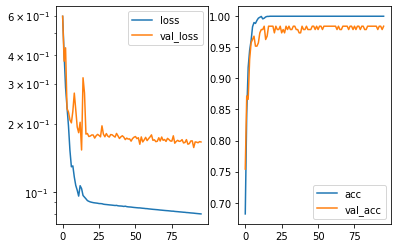

Predicted cell: Background Probability: [[0.9999895]]
True Cell type: Background
x [[0.5215464]]
True positional value x 0.5
y [[0.5031962]]
True positional value y 0.5


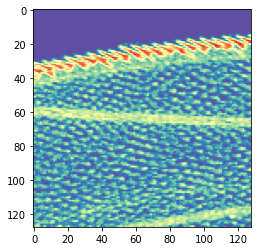

Epoch 97/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0798 - acc: 1.0000 - val_loss: 0.1648 - val_acc: 0.9840

Epoch 00097: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16478428344197452, 'val_acc': 0.9839572154264399, 'loss': 0.07984293193398259, 'acc': 1.0, 'lr': 1e-04}


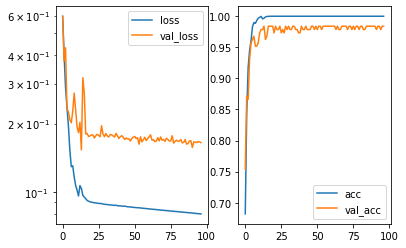

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.54323715]]
True positional value x 0.5
y [[0.43848568]]
True positional value y 0.5


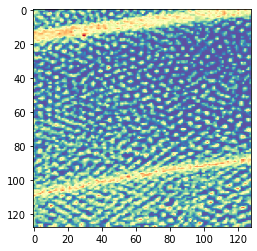

Epoch 98/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0797 - acc: 1.0000 - val_loss: 0.1677 - val_acc: 0.9786

Epoch 00098: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16767938801630294, 'val_acc': 0.9786096205685866, 'loss': 0.07973689079973836, 'acc': 1.0, 'lr': 1e-04}


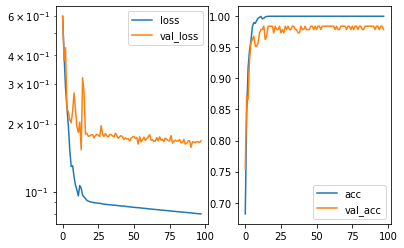

Predicted cell: Landmark Probability: [[0.9997522]]
True Cell type: Landmark
x [[0.6062526]]
True positional value x 0.578125
y [[0.5653836]]
True positional value y 0.578125


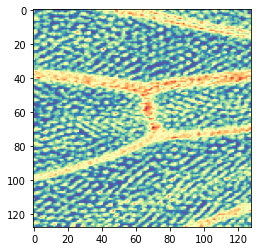

Epoch 99/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0796 - acc: 1.0000 - val_loss: 0.1664 - val_acc: 0.9840

Epoch 00099: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16637612166092358, 'val_acc': 0.9839572154264399, 'loss': 0.07962739291546779, 'acc': 1.0, 'lr': 1e-04}


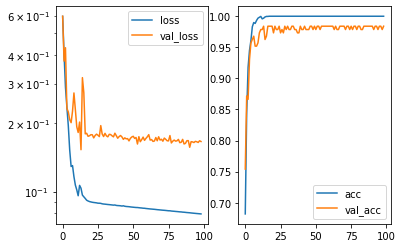

Predicted cell: Landmark Probability: [[0.9999976]]
True Cell type: Landmark
x [[0.5569113]]
True positional value x 0.578125
y [[0.46987337]]
True positional value y 0.5


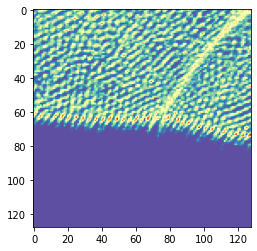

Epoch 100/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0795 - acc: 1.0000 - val_loss: 0.1626 - val_acc: 0.9840

Epoch 00100: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16256004085834014, 'val_acc': 0.9839572154264399, 'loss': 0.07951610152138469, 'acc': 1.0, 'lr': 1e-04}


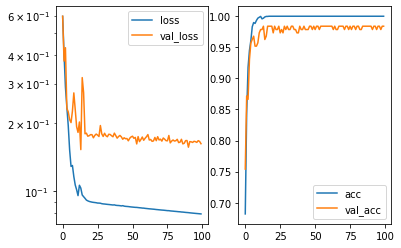

Predicted cell: Background Probability: [[0.99998355]]
True Cell type: Background
x [[0.46709326]]
True positional value x 0.5
y [[0.51957]]
True positional value y 0.5


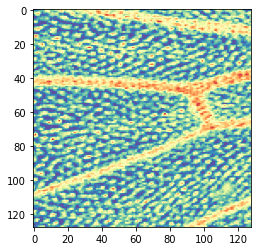

Epoch 101/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0794 - acc: 1.0000 - val_loss: 0.1655 - val_acc: 0.9840

Epoch 00101: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16552466249720935, 'val_acc': 0.9839572154264399, 'loss': 0.07939908365643905, 'acc': 1.0, 'lr': 1e-04}


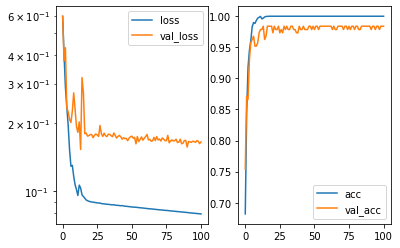

Predicted cell: Background Probability: [[0.9991309]]
True Cell type: Background
x [[0.5675968]]
True positional value x 0.5
y [[0.49456006]]
True positional value y 0.5


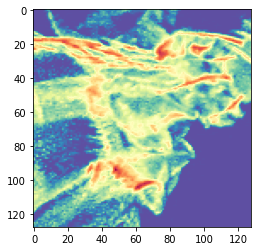

Epoch 102/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0793 - acc: 1.0000 - val_loss: 0.1602 - val_acc: 0.9840

Epoch 00102: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16024558636593947, 'val_acc': 0.9839572154264399, 'loss': 0.07928844318172049, 'acc': 1.0, 'lr': 1e-04}


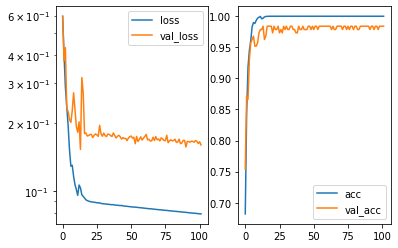

Predicted cell: Background Probability: [[0.9977836]]
True Cell type: Background
x [[0.49420977]]
True positional value x 0.5
y [[0.4531809]]
True positional value y 0.5


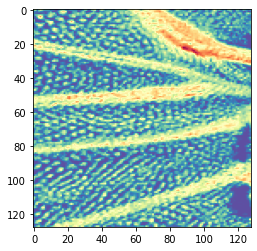

Epoch 103/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0792 - acc: 1.0000 - val_loss: 0.1648 - val_acc: 0.9786

Epoch 00103: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16484029176719686, 'val_acc': 0.9786096205685866, 'loss': 0.07917859735575626, 'acc': 1.0, 'lr': 1e-04}


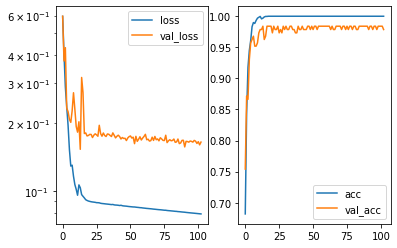

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.61112875]]
True positional value x 0.578125
y [[0.46075353]]
True positional value y 0.421875


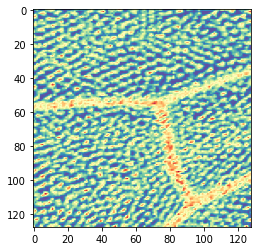

Epoch 104/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0791 - acc: 1.0000 - val_loss: 0.1581 - val_acc: 0.9786

Epoch 00104: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15813697930325799, 'val_acc': 0.9786096205685866, 'loss': 0.07907633844802962, 'acc': 1.0, 'lr': 1e-04}


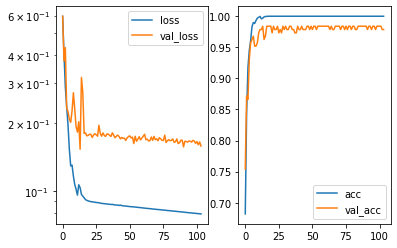

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.6029177]]
True positional value x 0.5
y [[0.515043]]
True positional value y 0.5


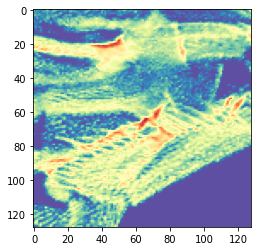

Epoch 105/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0790 - acc: 1.0000 - val_loss: 0.1648 - val_acc: 0.9786

Epoch 00105: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16481595466481172, 'val_acc': 0.9786096205685866, 'loss': 0.0789672014693789, 'acc': 1.0, 'lr': 1e-04}


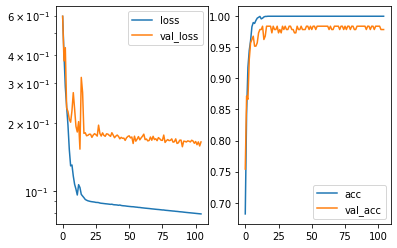

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5456124]]
True positional value x 0.5
y [[0.47869253]]
True positional value y 0.5


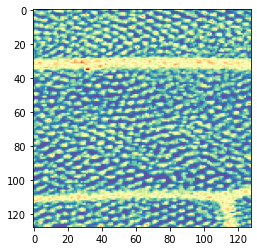

Epoch 106/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0789 - acc: 1.0000 - val_loss: 0.1648 - val_acc: 0.9786

Epoch 00106: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1647993355272288, 'val_acc': 0.9786096205685866, 'loss': 0.07885490478900484, 'acc': 1.0, 'lr': 1e-04}


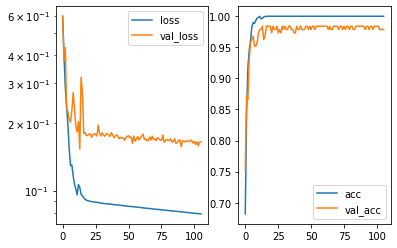

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4378943]]
True positional value x 0.421875
y [[0.45163456]]
True positional value y 0.5


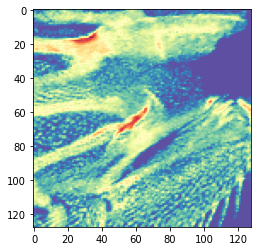

Epoch 107/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0787 - acc: 1.0000 - val_loss: 0.1616 - val_acc: 0.9840

Epoch 00107: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16164004197095166, 'val_acc': 0.9839572154264399, 'loss': 0.07874428603569128, 'acc': 1.0, 'lr': 1e-04}


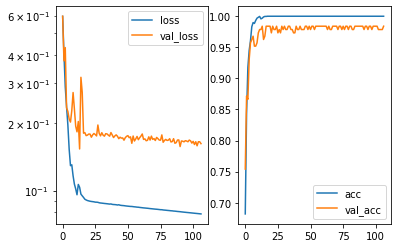

Predicted cell: Landmark Probability: [[0.9999993]]
True Cell type: Landmark
x [[0.4396038]]
True positional value x 0.421875
y [[0.45141193]]
True positional value y 0.5


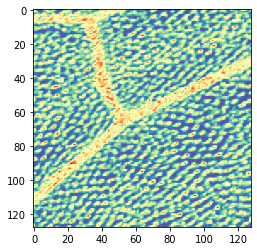

Epoch 108/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0786 - acc: 1.0000 - val_loss: 0.1619 - val_acc: 0.9840

Epoch 00108: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1619135209902085, 'val_acc': 0.9839572154264399, 'loss': 0.078635846537281, 'acc': 1.0, 'lr': 1e-04}


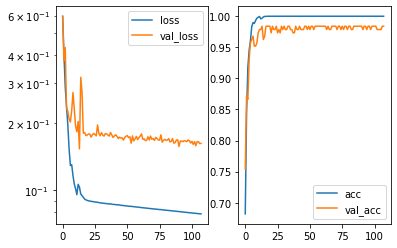

Predicted cell: Landmark Probability: [[0.999443]]
True Cell type: Landmark
x [[0.5434005]]
True positional value x 0.578125
y [[0.52304775]]
True positional value y 0.5


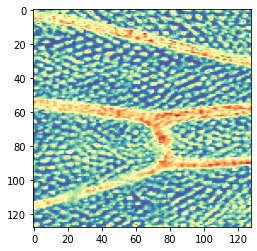

Epoch 109/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0785 - acc: 1.0000 - val_loss: 0.1633 - val_acc: 0.9786

Epoch 00109: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16325176041075254, 'val_acc': 0.9786096205685866, 'loss': 0.07852466544793006, 'acc': 1.0, 'lr': 1e-04}


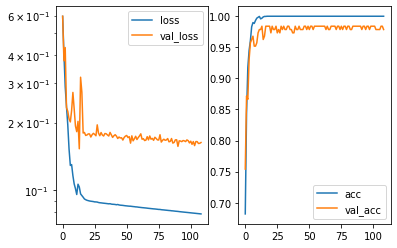

Predicted cell: Landmark Probability: [[0.99990964]]
True Cell type: Landmark
x [[0.47545454]]
True positional value x 0.578125
y [[0.5564968]]
True positional value y 0.578125


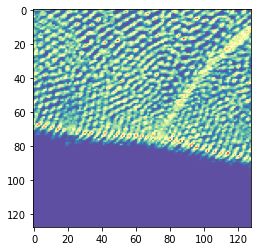

Epoch 110/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0784 - acc: 1.0000 - val_loss: 0.1639 - val_acc: 0.9840

Epoch 00110: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16389184329598983, 'val_acc': 0.9839572154264399, 'loss': 0.07841181111281965, 'acc': 1.0, 'lr': 1e-04}


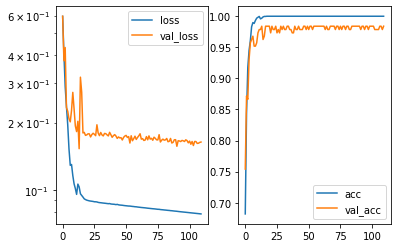

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.52780914]]
True positional value x 0.5
y [[0.56902534]]
True positional value y 0.578125


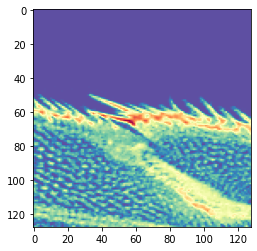

Epoch 111/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0783 - acc: 1.0000 - val_loss: 0.1652 - val_acc: 0.9786

Epoch 00111: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16520969999983987, 'val_acc': 0.9786096205685866, 'loss': 0.07830364914748605, 'acc': 1.0, 'lr': 1e-04}


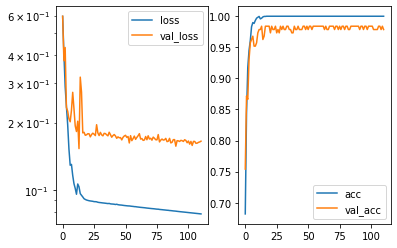

Predicted cell: Background Probability: [[0.9923104]]
True Cell type: Background
x [[0.4316028]]
True positional value x 0.5
y [[0.37942678]]
True positional value y 0.5


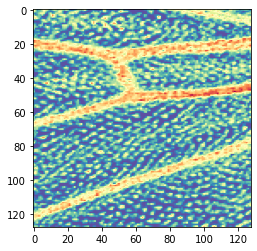

Epoch 112/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0782 - acc: 1.0000 - val_loss: 0.1601 - val_acc: 0.9840

Epoch 00112: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16011454798480407, 'val_acc': 0.9839572154264399, 'loss': 0.0782147311367561, 'acc': 1.0, 'lr': 1e-04}


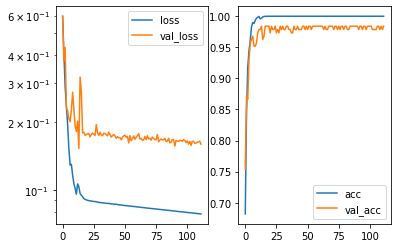

Predicted cell: Landmark Probability: [[0.9999764]]
True Cell type: Landmark
x [[0.539463]]
True positional value x 0.5
y [[0.54165393]]
True positional value y 0.5


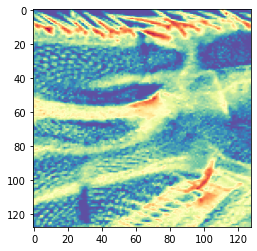

Epoch 113/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0781 - acc: 1.0000 - val_loss: 0.1648 - val_acc: 0.9786

Epoch 00113: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1648093062766733, 'val_acc': 0.9786096205685866, 'loss': 0.07808402461381665, 'acc': 1.0, 'lr': 1e-04}


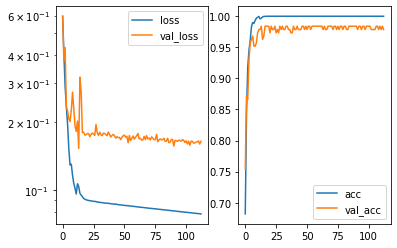

Predicted cell: Landmark Probability: [[0.99997807]]
True Cell type: Landmark
x [[0.53776276]]
True positional value x 0.5
y [[0.5351531]]
True positional value y 0.5


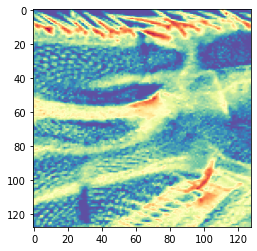

Epoch 114/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0780 - acc: 1.0000 - val_loss: 0.1634 - val_acc: 0.9840

Epoch 00114: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16338512134105765, 'val_acc': 0.9839572154264399, 'loss': 0.07799718040264869, 'acc': 1.0, 'lr': 1e-04}


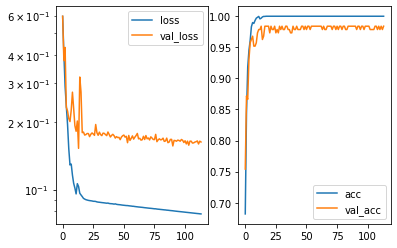

Predicted cell: Landmark Probability: [[0.90077966]]
True Cell type: Background
x [[0.4967338]]
True positional value x 0.5
y [[0.5032057]]
True positional value y 0.5


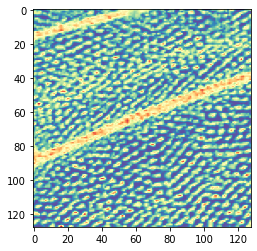

Epoch 115/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0779 - acc: 1.0000 - val_loss: 0.1616 - val_acc: 0.9840

Epoch 00115: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16155982427896662, 'val_acc': 0.9839572154264399, 'loss': 0.07788396877164701, 'acc': 1.0, 'lr': 1e-04}


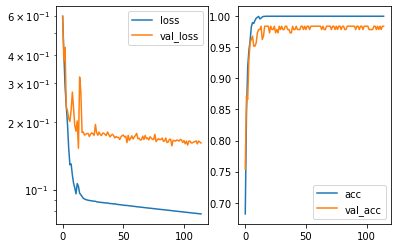

Predicted cell: Background Probability: [[0.9998714]]
True Cell type: Background
x [[0.5706283]]
True positional value x 0.5
y [[0.4658884]]
True positional value y 0.5


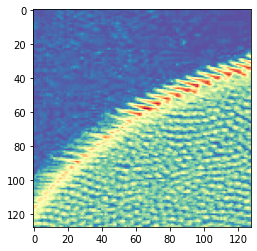

Epoch 116/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0778 - acc: 1.0000 - val_loss: 0.1616 - val_acc: 0.9840

Epoch 00116: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1616315326907418, 'val_acc': 0.9839572154264399, 'loss': 0.07779150954996605, 'acc': 1.0, 'lr': 1e-04}


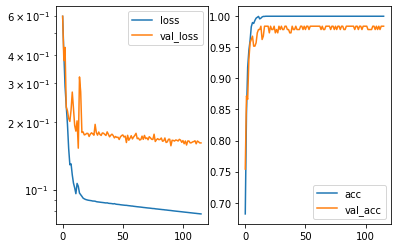

Predicted cell: Landmark Probability: [[0.9999292]]
True Cell type: Landmark
x [[0.40112674]]
True positional value x 0.421875
y [[0.5208018]]
True positional value y 0.578125


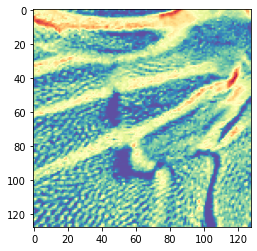

Epoch 117/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0777 - acc: 1.0000 - val_loss: 0.1654 - val_acc: 0.9786

Epoch 00117: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1654497183421079, 'val_acc': 0.9786096205685866, 'loss': 0.07767836640715532, 'acc': 1.0, 'lr': 1e-04}


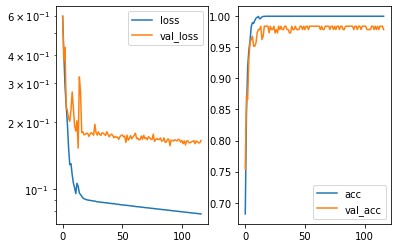

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4871722]]
True positional value x 0.5
y [[0.51451546]]
True positional value y 0.578125


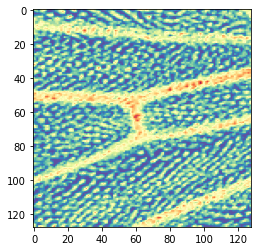

Epoch 118/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0776 - acc: 1.0000 - val_loss: 0.1599 - val_acc: 0.9840

Epoch 00118: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1598556814665463, 'val_acc': 0.9839572154264399, 'loss': 0.0775570624707045, 'acc': 1.0, 'lr': 1e-04}


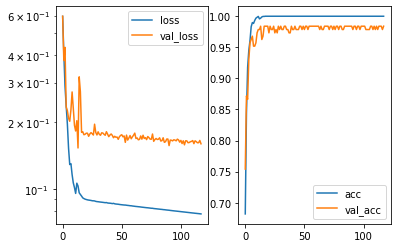

Predicted cell: Landmark Probability: [[0.9999975]]
True Cell type: Landmark
x [[0.5569699]]
True positional value x 0.578125
y [[0.47616628]]
True positional value y 0.5


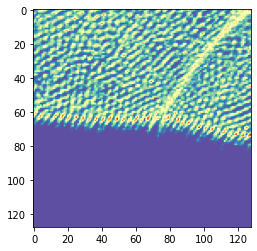

Epoch 119/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0775 - acc: 1.0000 - val_loss: 0.1619 - val_acc: 0.9786

Epoch 00119: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1618961592249692, 'val_acc': 0.9786096205685866, 'loss': 0.07745144635153166, 'acc': 1.0, 'lr': 1e-04}


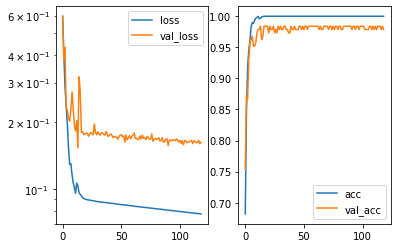

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5513633]]
True positional value x 0.578125
y [[0.4987079]]
True positional value y 0.421875


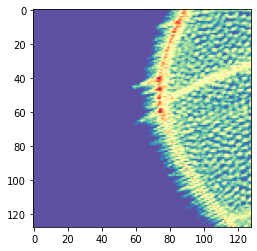

Epoch 120/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0773 - acc: 1.0000 - val_loss: 0.1630 - val_acc: 0.9786

Epoch 00120: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1630184646038448, 'val_acc': 0.9786096205685866, 'loss': 0.07734361131666612, 'acc': 1.0, 'lr': 1e-04}


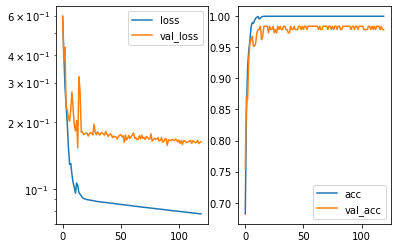

Predicted cell: Landmark Probability: [[0.9999988]]
True Cell type: Landmark
x [[0.47899604]]
True positional value x 0.421875
y [[0.4459532]]
True positional value y 0.5


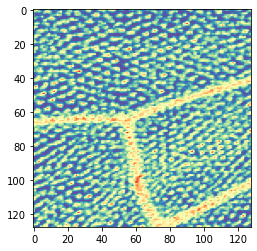

Epoch 121/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0772 - acc: 1.0000 - val_loss: 0.1632 - val_acc: 0.9840

Epoch 00121: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16318211485357845, 'val_acc': 0.9839572154264399, 'loss': 0.07724102818891952, 'acc': 1.0, 'lr': 1e-04}


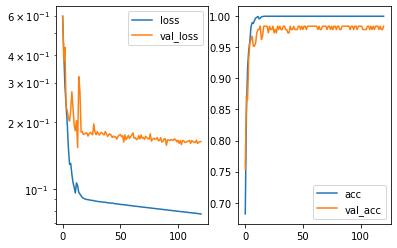

Predicted cell: Landmark Probability: [[0.8973662]]
True Cell type: Background
x [[0.45650077]]
True positional value x 0.5
y [[0.43352813]]
True positional value y 0.5


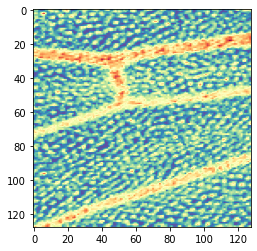

Epoch 122/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0771 - acc: 1.0000 - val_loss: 0.1588 - val_acc: 0.9840

Epoch 00122: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15884475585292368, 'val_acc': 0.9839572154264399, 'loss': 0.07713496488363004, 'acc': 1.0, 'lr': 1e-04}


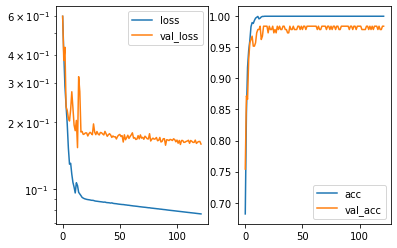

Predicted cell: Landmark Probability: [[0.997391]]
True Cell type: Landmark
x [[0.4389559]]
True positional value x 0.421875
y [[0.46462476]]
True positional value y 0.5


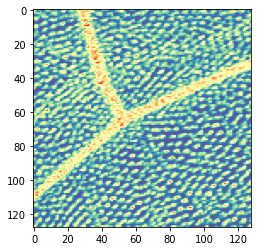

Epoch 123/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0770 - acc: 1.0000 - val_loss: 0.1612 - val_acc: 0.9840

Epoch 00123: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16124229041490962, 'val_acc': 0.9839572154264399, 'loss': 0.07701860183353015, 'acc': 1.0, 'lr': 1e-04}


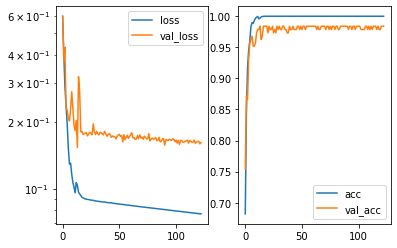

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.40373927]]
True positional value x 0.421875
y [[0.53234416]]
True positional value y 0.578125


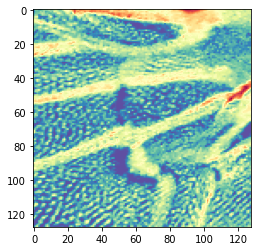

Epoch 124/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0769 - acc: 1.0000 - val_loss: 0.1589 - val_acc: 0.9840

Epoch 00124: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15886841539074392, 'val_acc': 0.9839572154264399, 'loss': 0.07691668603911753, 'acc': 1.0, 'lr': 1e-04}


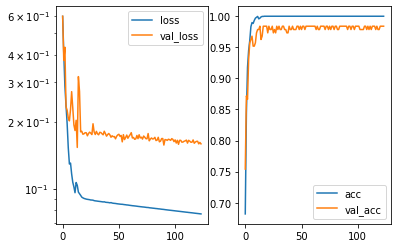

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5262371]]
True positional value x 0.5
y [[0.4766338]]
True positional value y 0.5


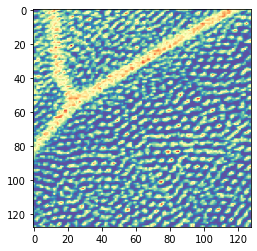

Epoch 125/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0768 - acc: 1.0000 - val_loss: 0.1581 - val_acc: 0.9786

Epoch 00125: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15812964123838089, 'val_acc': 0.9786096205685866, 'loss': 0.07683181162614709, 'acc': 1.0, 'lr': 1e-04}


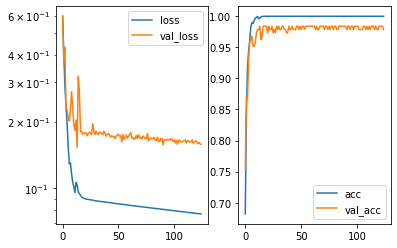

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.48470494]]
True positional value x 0.5
y [[0.5325729]]
True positional value y 0.5


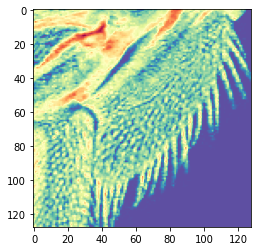

Epoch 126/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0767 - acc: 1.0000 - val_loss: 0.1594 - val_acc: 0.9840

Epoch 00126: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15939657716827596, 'val_acc': 0.9839572154264399, 'loss': 0.07671460940870806, 'acc': 1.0, 'lr': 1e-04}


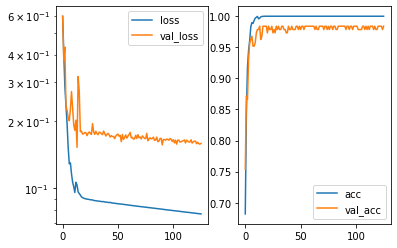

Predicted cell: Landmark Probability: [[0.9999126]]
True Cell type: Landmark
x [[0.47267208]]
True positional value x 0.421875
y [[0.48878703]]
True positional value y 0.5


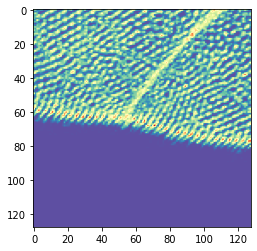

Epoch 127/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0766 - acc: 1.0000 - val_loss: 0.1594 - val_acc: 0.9840

Epoch 00127: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1593891164277964, 'val_acc': 0.9839572154264399, 'loss': 0.07660442170909214, 'acc': 1.0, 'lr': 1e-04}


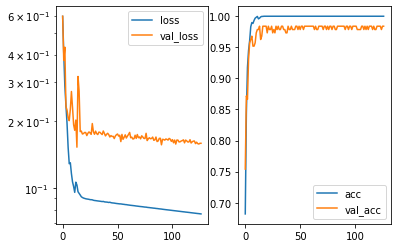

Predicted cell: Background Probability: [[0.9674163]]
True Cell type: Background
x [[0.40152764]]
True positional value x 0.5
y [[0.4539016]]
True positional value y 0.5


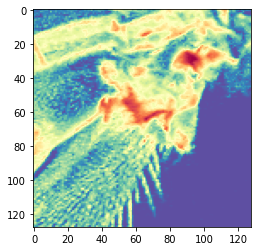

Epoch 128/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0765 - acc: 1.0000 - val_loss: 0.1556 - val_acc: 0.9840

Epoch 00128: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15560753380551057, 'val_acc': 0.9839572154264399, 'loss': 0.0765068423374857, 'acc': 1.0, 'lr': 1e-04}


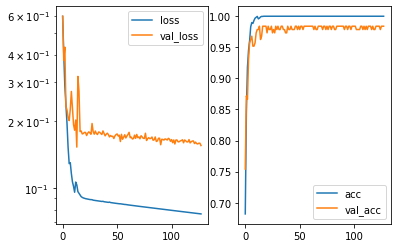

Predicted cell: Landmark Probability: [[0.99999654]]
True Cell type: Landmark
x [[0.43677258]]
True positional value x 0.5
y [[0.5049505]]
True positional value y 0.5


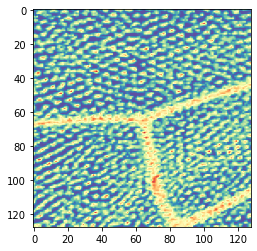

Epoch 129/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0764 - acc: 1.0000 - val_loss: 0.1553 - val_acc: 0.9840

Epoch 00129: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15530683243657178, 'val_acc': 0.9839572154264399, 'loss': 0.07640662293059639, 'acc': 1.0, 'lr': 1e-04}


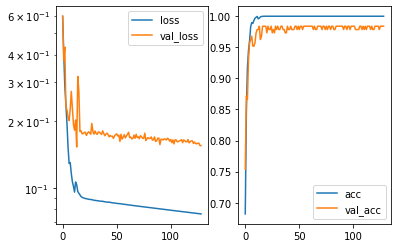

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.5122458]]
True positional value x 0.5
y [[0.47252822]]
True positional value y 0.421875


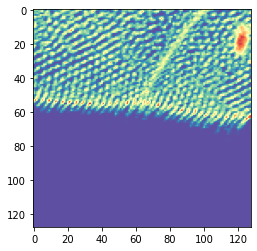

Epoch 130/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0763 - acc: 1.0000 - val_loss: 0.1604 - val_acc: 0.9786

Epoch 00130: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16038404106296958, 'val_acc': 0.9786096205685866, 'loss': 0.07629841175277019, 'acc': 1.0, 'lr': 1e-04}


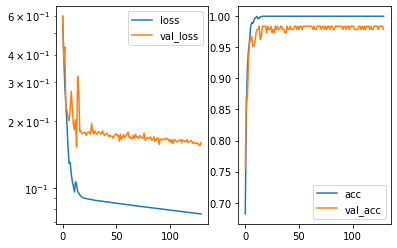

Predicted cell: Landmark Probability: [[0.99999917]]
True Cell type: Landmark
x [[0.4119341]]
True positional value x 0.421875
y [[0.56759423]]
True positional value y 0.578125


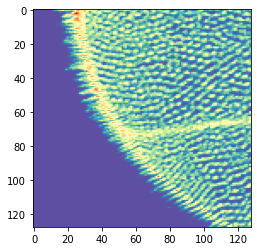

Epoch 131/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0762 - acc: 1.0000 - val_loss: 0.1582 - val_acc: 0.9840

Epoch 00131: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15815628961445813, 'val_acc': 0.9839572154264399, 'loss': 0.0762012723310143, 'acc': 1.0, 'lr': 1e-04}


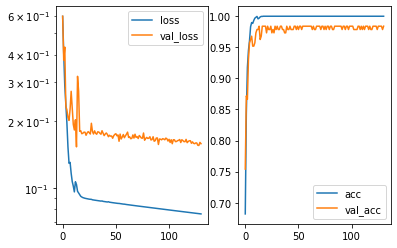

Predicted cell: Landmark Probability: [[0.99997497]]
True Cell type: Landmark
x [[0.54121524]]
True positional value x 0.5
y [[0.5374425]]
True positional value y 0.5


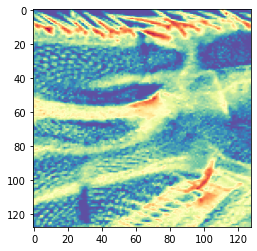

Epoch 132/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0761 - acc: 1.0000 - val_loss: 0.1651 - val_acc: 0.9840

Epoch 00132: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16506698544331413, 'val_acc': 0.9839572154264399, 'loss': 0.07608956323796857, 'acc': 1.0, 'lr': 1e-04}


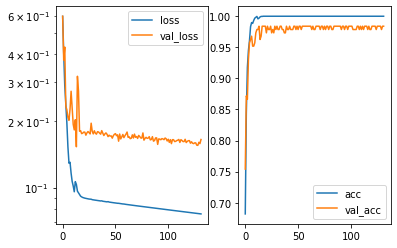

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.4294236]]
True positional value x 0.5
y [[0.53933126]]
True positional value y 0.5


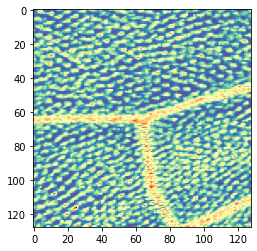

Epoch 133/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0760 - acc: 1.0000 - val_loss: 0.1586 - val_acc: 0.9840

Epoch 00133: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15858698018731918, 'val_acc': 0.9839572154264399, 'loss': 0.07598283904979139, 'acc': 1.0, 'lr': 1e-04}


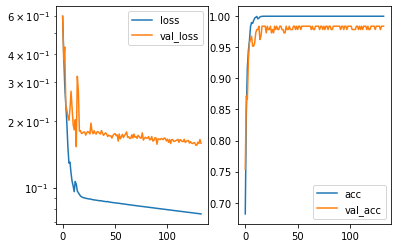

Predicted cell: Landmark Probability: [[0.98921716]]
True Cell type: Landmark
x [[0.5943864]]
True positional value x 0.578125
y [[0.4269163]]
True positional value y 0.421875


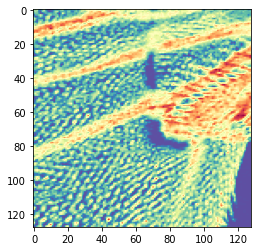

Epoch 134/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0759 - acc: 1.0000 - val_loss: 0.1603 - val_acc: 0.9840

Epoch 00134: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1602995929552272, 'val_acc': 0.9839572154264399, 'loss': 0.07588010720879226, 'acc': 1.0, 'lr': 1e-04}


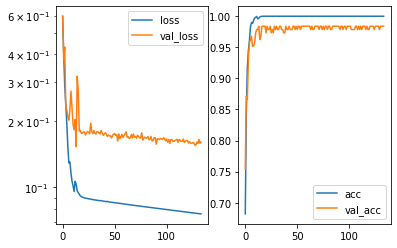

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.44176015]]
True positional value x 0.5
y [[0.52811223]]
True positional value y 0.5


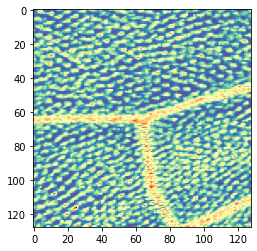

Epoch 135/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0758 - acc: 1.0000 - val_loss: 0.1592 - val_acc: 0.9840

Epoch 00135: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1591828292544513, 'val_acc': 0.9839572154264399, 'loss': 0.07579206959783057, 'acc': 1.0, 'lr': 1e-04}


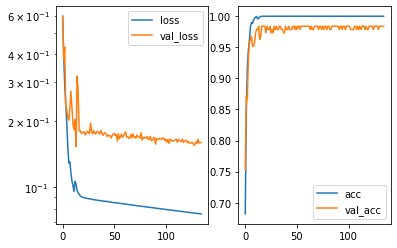

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52038634]]
True positional value x 0.5
y [[0.53360265]]
True positional value y 0.5


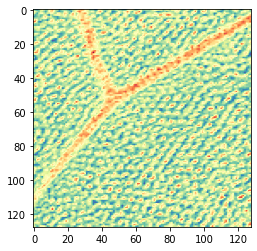

Epoch 136/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0757 - acc: 1.0000 - val_loss: 0.1570 - val_acc: 0.9786

Epoch 00136: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1569930680773475, 'val_acc': 0.9786096205685866, 'loss': 0.07566836122917174, 'acc': 1.0, 'lr': 1e-04}


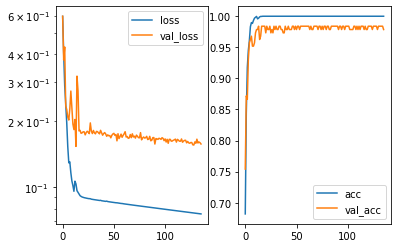

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.55009395]]
True positional value x 0.578125
y [[0.49080998]]
True positional value y 0.5


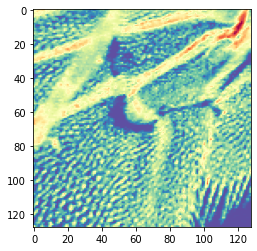

Epoch 137/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0756 - acc: 1.0000 - val_loss: 0.1616 - val_acc: 0.9786

Epoch 00137: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1616330977110939, 'val_acc': 0.9786096205685866, 'loss': 0.07556415415640544, 'acc': 1.0, 'lr': 1e-04}


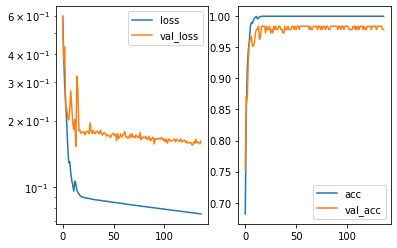

Predicted cell: Background Probability: [[0.9999999]]
True Cell type: Background
x [[0.49372658]]
True positional value x 0.5
y [[0.47352034]]
True positional value y 0.5


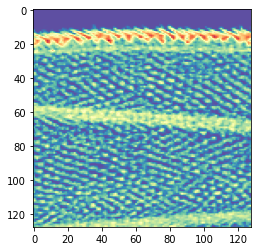

Epoch 138/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0755 - acc: 1.0000 - val_loss: 0.1567 - val_acc: 0.9786

Epoch 00138: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15670107803083358, 'val_acc': 0.9786096205685866, 'loss': 0.07546624077775017, 'acc': 1.0, 'lr': 1e-04}


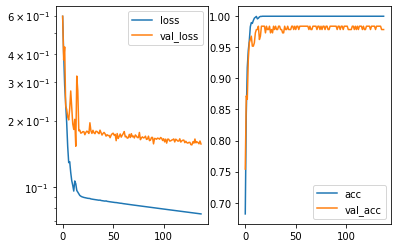

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.42228717]]
True positional value x 0.421875
y [[0.53984636]]
True positional value y 0.5


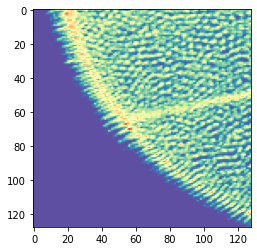

Epoch 139/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0754 - acc: 1.0000 - val_loss: 0.1585 - val_acc: 0.9840

Epoch 00139: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1584767810402707, 'val_acc': 0.9839572154264399, 'loss': 0.07536663489444607, 'acc': 1.0, 'lr': 1e-04}


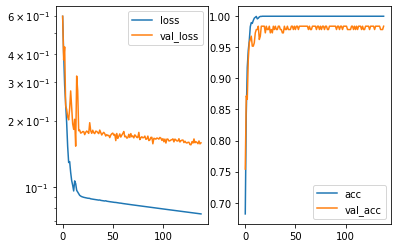

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5458792]]
True positional value x 0.5
y [[0.4770726]]
True positional value y 0.5


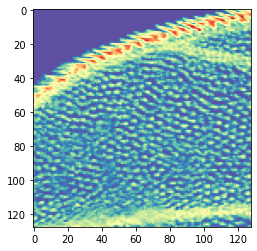

Epoch 140/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0753 - acc: 1.0000 - val_loss: 0.1576 - val_acc: 0.9840

Epoch 00140: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15756388343273, 'val_acc': 0.9839572154264399, 'loss': 0.07526171028832561, 'acc': 1.0, 'lr': 1e-04}


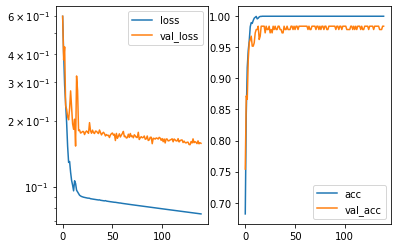

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49454996]]
True positional value x 0.5
y [[0.5082034]]
True positional value y 0.5


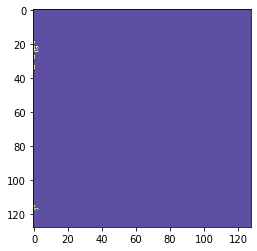

Epoch 141/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0752 - acc: 1.0000 - val_loss: 0.1598 - val_acc: 0.9840

Epoch 00141: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1597721787458435, 'val_acc': 0.9839572154264399, 'loss': 0.07515478062717107, 'acc': 1.0, 'lr': 1e-04}


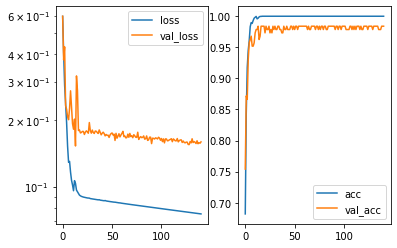

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5464859]]
True positional value x 0.421875
y [[0.52649707]]
True positional value y 0.5


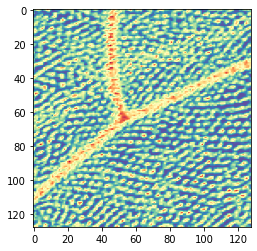

Epoch 142/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0751 - acc: 1.0000 - val_loss: 0.1583 - val_acc: 0.9786

Epoch 00142: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15832043116424174, 'val_acc': 0.9786096205685866, 'loss': 0.07505249396781766, 'acc': 1.0, 'lr': 1e-04}


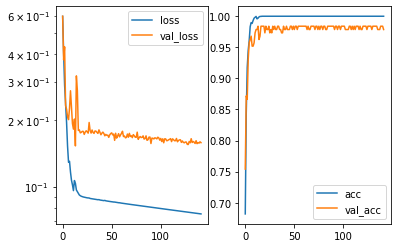

Predicted cell: Landmark Probability: [[0.9999883]]
True Cell type: Landmark
x [[0.517252]]
True positional value x 0.5
y [[0.41196987]]
True positional value y 0.421875


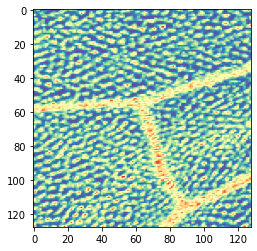

Epoch 143/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0750 - acc: 1.0000 - val_loss: 0.1645 - val_acc: 0.9840

Epoch 00143: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16453746495081142, 'val_acc': 0.9839572154264399, 'loss': 0.07496710737260533, 'acc': 1.0, 'lr': 1e-04}


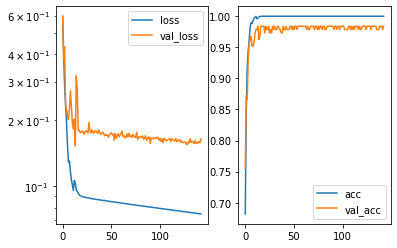

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.55713785]]
True positional value x 0.5
y [[0.48915482]]
True positional value y 0.5


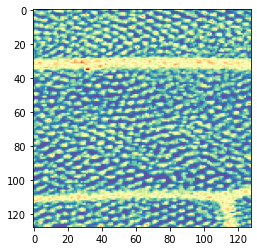

Epoch 144/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0749 - acc: 1.0000 - val_loss: 0.1512 - val_acc: 0.9786

Epoch 00144: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15123376493307358, 'val_acc': 0.9786096205685866, 'loss': 0.07486013052023809, 'acc': 1.0, 'lr': 1e-04}


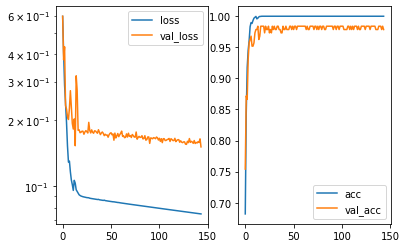

Predicted cell: Landmark Probability: [[0.9998779]]
True Cell type: Landmark
x [[0.465002]]
True positional value x 0.5
y [[0.43325052]]
True positional value y 0.421875


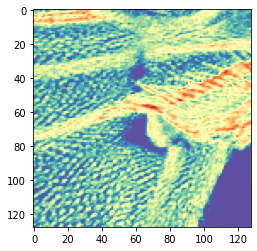

Epoch 145/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0748 - acc: 1.0000 - val_loss: 0.1615 - val_acc: 0.9840

Epoch 00145: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16154475717302313, 'val_acc': 0.9839572154264399, 'loss': 0.07476431419636931, 'acc': 1.0, 'lr': 1e-04}


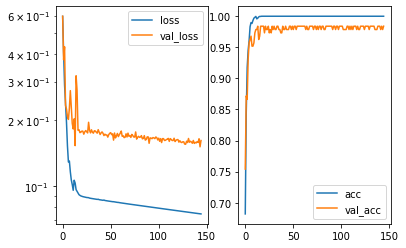

Predicted cell: Landmark Probability: [[0.9999995]]
True Cell type: Landmark
x [[0.51314235]]
True positional value x 0.5
y [[0.40098792]]
True positional value y 0.421875


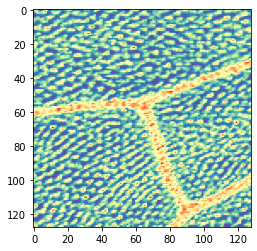

Epoch 146/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0747 - acc: 1.0000 - val_loss: 0.1561 - val_acc: 0.9840

Epoch 00146: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1561127754456219, 'val_acc': 0.9839572154264399, 'loss': 0.07465412986695397, 'acc': 1.0, 'lr': 1e-04}


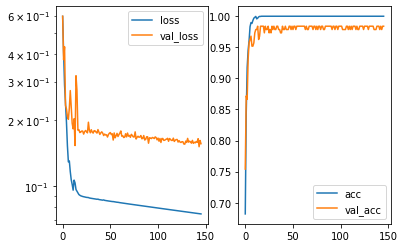

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4509169]]
True positional value x 0.5
y [[0.49877065]]
True positional value y 0.5


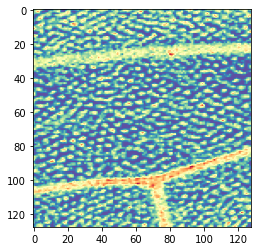

Epoch 147/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0746 - acc: 1.0000 - val_loss: 0.1617 - val_acc: 0.9840

Epoch 00147: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1616641872308471, 'val_acc': 0.9839572154264399, 'loss': 0.07455244185944028, 'acc': 1.0, 'lr': 1e-04}


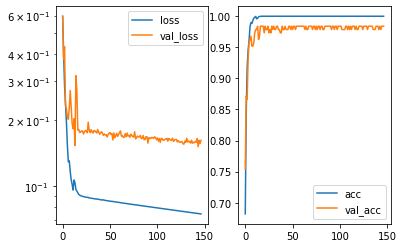

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.39938572]]
True positional value x 0.421875
y [[0.517296]]
True positional value y 0.5


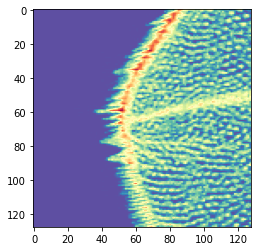

Epoch 148/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0745 - acc: 1.0000 - val_loss: 0.1593 - val_acc: 0.9840

Epoch 00148: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15927728476690098, 'val_acc': 0.9839572154264399, 'loss': 0.0744583383412665, 'acc': 1.0, 'lr': 1e-04}


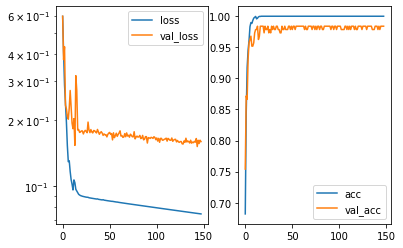

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.50977165]]
True positional value x 0.5
y [[0.5324781]]
True positional value y 0.5


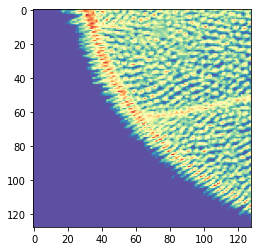

Epoch 149/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0744 - acc: 1.0000 - val_loss: 0.1601 - val_acc: 0.9840

Epoch 00149: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1601154160770503, 'val_acc': 0.9839572154264399, 'loss': 0.07435363278977963, 'acc': 1.0, 'lr': 1e-04}


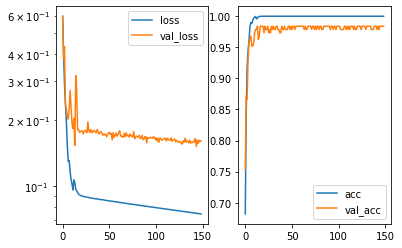

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5118698]]
True positional value x 0.5
y [[0.47826296]]
True positional value y 0.5


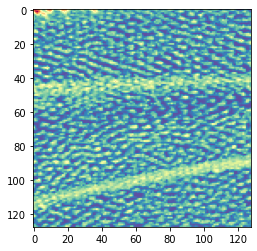

Epoch 150/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0743 - acc: 1.0000 - val_loss: 0.1574 - val_acc: 0.9786

Epoch 00150: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15740128905377923, 'val_acc': 0.9786096205685866, 'loss': 0.07425589620377879, 'acc': 1.0, 'lr': 1e-04}


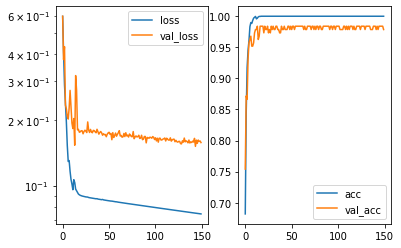

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5062148]]
True positional value x 0.5
y [[0.50178707]]
True positional value y 0.5


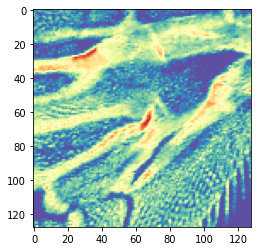

Epoch 151/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0742 - acc: 1.0000 - val_loss: 0.1578 - val_acc: 0.9840

Epoch 00151: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15777408343585417, 'val_acc': 0.9839572154264399, 'loss': 0.07415821233074071, 'acc': 1.0, 'lr': 1e-04}


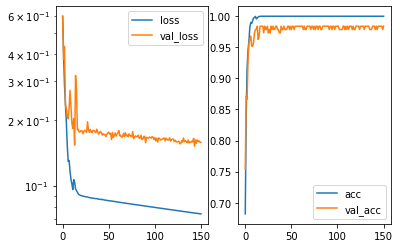

Predicted cell: Background Probability: [[0.9987245]]
True Cell type: Background
x [[0.5113855]]
True positional value x 0.5
y [[0.48975077]]
True positional value y 0.5


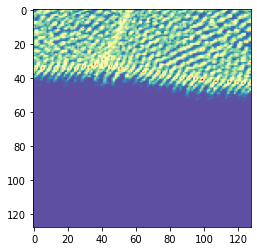

Epoch 152/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0741 - acc: 1.0000 - val_loss: 0.1592 - val_acc: 0.9786

Epoch 00152: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15922724196617616, 'val_acc': 0.9786096205685866, 'loss': 0.07405305932839577, 'acc': 1.0, 'lr': 1e-04}


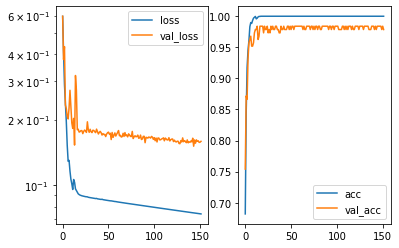

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52400213]]
True positional value x 0.5
y [[0.487003]]
True positional value y 0.5


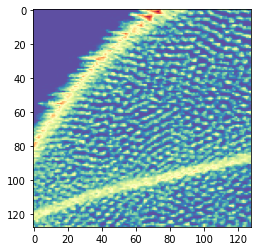

Epoch 153/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0739 - acc: 1.0000 - val_loss: 0.1569 - val_acc: 0.9786

Epoch 00153: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15690649141442967, 'val_acc': 0.9786096205685866, 'loss': 0.07394857107920629, 'acc': 1.0, 'lr': 1e-04}


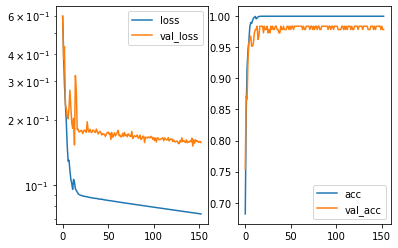

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.5951518]]
True positional value x 0.5
y [[0.4523768]]
True positional value y 0.5


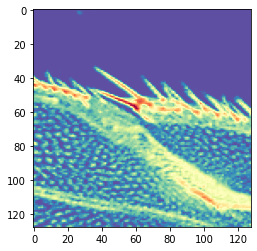

Epoch 154/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0739 - acc: 1.0000 - val_loss: 0.1594 - val_acc: 0.9786

Epoch 00154: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15944132746700296, 'val_acc': 0.9786096205685866, 'loss': 0.07385775809965762, 'acc': 1.0, 'lr': 1e-04}


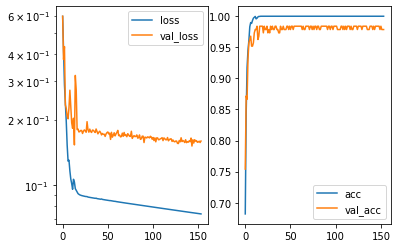

Predicted cell: Landmark Probability: [[0.9997514]]
True Cell type: Landmark
x [[0.53487533]]
True positional value x 0.5
y [[0.49757767]]
True positional value y 0.5


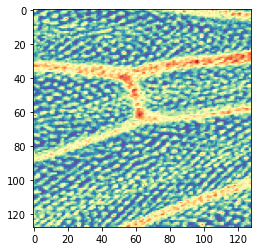

Epoch 155/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0737 - acc: 1.0000 - val_loss: 0.1582 - val_acc: 0.9786

Epoch 00155: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15822544367236888, 'val_acc': 0.9786096205685866, 'loss': 0.07374256844666471, 'acc': 1.0, 'lr': 1e-04}


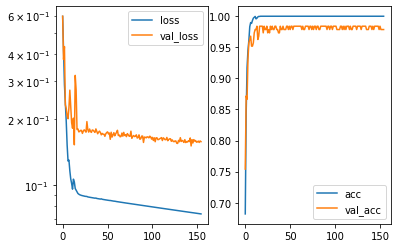

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5322534]]
True positional value x 0.5
y [[0.57124406]]
True positional value y 0.578125


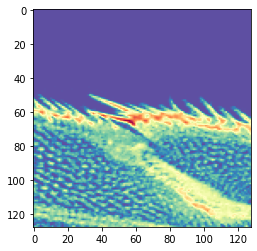

Epoch 156/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0736 - acc: 1.0000 - val_loss: 0.1592 - val_acc: 0.9786

Epoch 00156: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15915575229069767, 'val_acc': 0.9786096205685866, 'loss': 0.07364728613570122, 'acc': 1.0, 'lr': 1e-04}


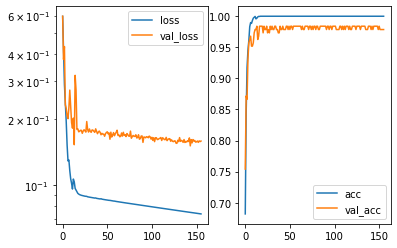

Predicted cell: Landmark Probability: [[0.99997187]]
True Cell type: Landmark
x [[0.42102638]]
True positional value x 0.421875
y [[0.4297131]]
True positional value y 0.421875


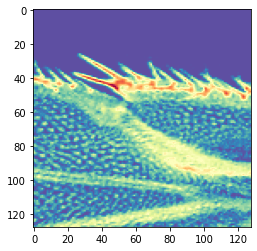

Epoch 157/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0735 - acc: 1.0000 - val_loss: 0.1563 - val_acc: 0.9786

Epoch 00157: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1562879715055068, 'val_acc': 0.9786096205685866, 'loss': 0.07354258260129201, 'acc': 1.0, 'lr': 1e-04}


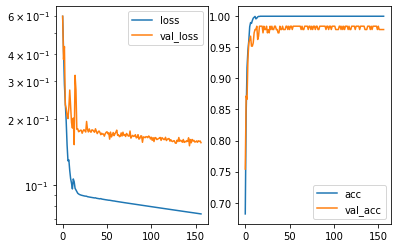

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.45387655]]
True positional value x 0.5
y [[0.5462522]]
True positional value y 0.5


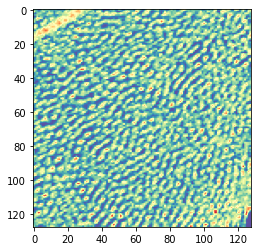

Epoch 158/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0734 - acc: 1.0000 - val_loss: 0.1600 - val_acc: 0.9840

Epoch 00158: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16003243573368553, 'val_acc': 0.9839572154264399, 'loss': 0.07344174417428088, 'acc': 1.0, 'lr': 1e-04}


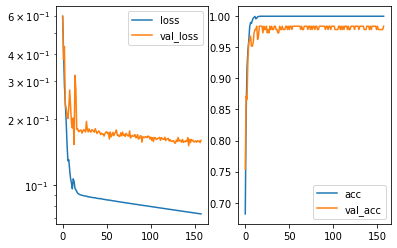

Predicted cell: Background Probability: [[0.99999857]]
True Cell type: Background
x [[0.5450246]]
True positional value x 0.5
y [[0.47472215]]
True positional value y 0.5


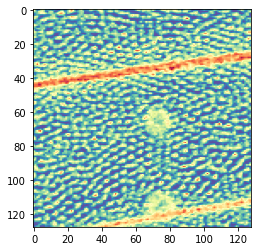

Epoch 159/250
3546/3546 [==============================] - 14s 4ms/step - loss: 0.0734 - acc: 1.0000 - val_loss: 0.1545 - val_acc: 0.9786

Epoch 00159: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15447822141456094, 'val_acc': 0.9786096205685866, 'loss': 0.07335330709369588, 'acc': 1.0, 'lr': 1e-04}


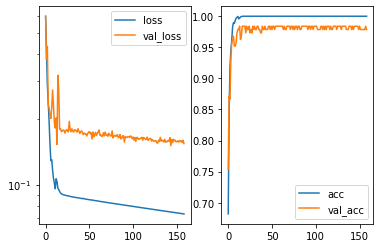

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.5585412]]
True positional value x 0.5
y [[0.48830107]]
True positional value y 0.5


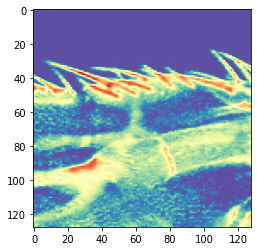

Epoch 160/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0733 - acc: 1.0000 - val_loss: 0.1570 - val_acc: 0.9786

Epoch 00160: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15695741796557278, 'val_acc': 0.9786096205685866, 'loss': 0.07326428540937657, 'acc': 1.0, 'lr': 1e-04}


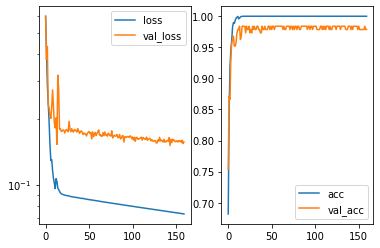

Predicted cell: Landmark Probability: [[0.99999356]]
True Cell type: Landmark
x [[0.43868154]]
True positional value x 0.421875
y [[0.5510951]]
True positional value y 0.5


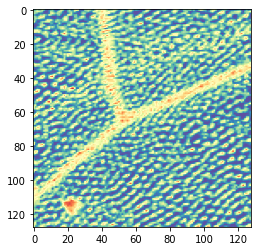

Epoch 161/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0731 - acc: 1.0000 - val_loss: 0.1565 - val_acc: 0.9840

Epoch 00161: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15647017059319798, 'val_acc': 0.9839572154264399, 'loss': 0.07314740090688204, 'acc': 1.0, 'lr': 1e-04}


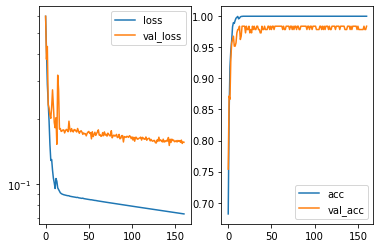

Predicted cell: Landmark Probability: [[0.99998844]]
True Cell type: Landmark
x [[0.5138137]]
True positional value x 0.5
y [[0.4082541]]
True positional value y 0.421875


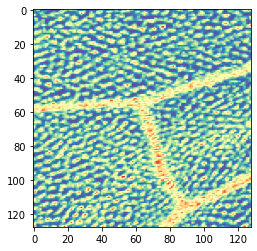

Epoch 162/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0731 - acc: 1.0000 - val_loss: 0.1581 - val_acc: 0.9840

Epoch 00162: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15813473898937358, 'val_acc': 0.9839572154264399, 'loss': 0.07305117623824826, 'acc': 1.0, 'lr': 1e-04}


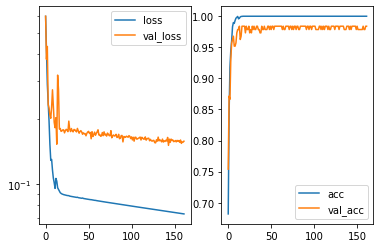

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.52616495]]
True positional value x 0.5
y [[0.45094836]]
True positional value y 0.5


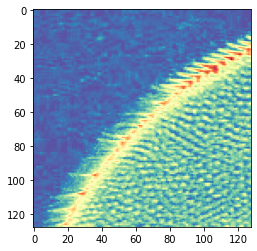

Epoch 163/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0730 - acc: 1.0000 - val_loss: 0.1578 - val_acc: 0.9840

Epoch 00163: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15782919024082429, 'val_acc': 0.9839572154264399, 'loss': 0.07295275683364018, 'acc': 1.0, 'lr': 1e-04}


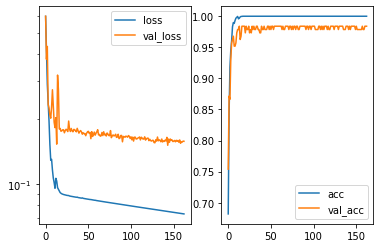

Predicted cell: Background Probability: [[0.9920387]]
True Cell type: Background
x [[0.4346279]]
True positional value x 0.5
y [[0.37916476]]
True positional value y 0.5


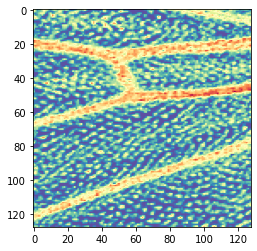

Epoch 164/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0729 - acc: 1.0000 - val_loss: 0.1577 - val_acc: 0.9840

Epoch 00164: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1576813082086211, 'val_acc': 0.9839572154264399, 'loss': 0.07285588219955151, 'acc': 1.0, 'lr': 1e-04}


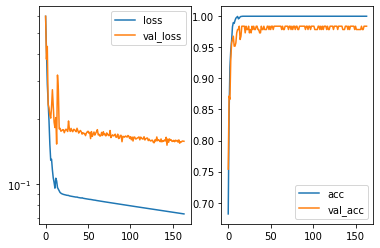

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.5169505]]
True positional value x 0.5
y [[0.38914225]]
True positional value y 0.421875


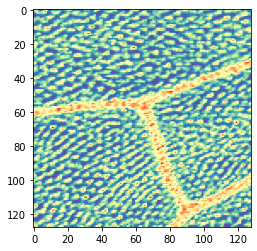

Epoch 165/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0728 - acc: 1.0000 - val_loss: 0.1575 - val_acc: 0.9840

Epoch 00165: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15749905557237207, 'val_acc': 0.9839572154264399, 'loss': 0.07276221188242261, 'acc': 1.0, 'lr': 1e-04}


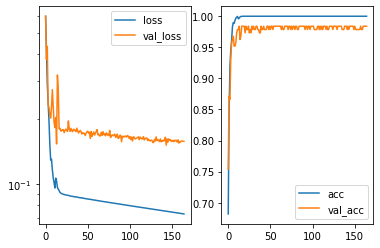

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.6085087]]
True positional value x 0.578125
y [[0.51329017]]
True positional value y 0.5


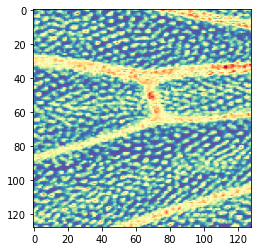

Epoch 166/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0727 - acc: 1.0000 - val_loss: 0.1547 - val_acc: 0.9840

Epoch 00166: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15467274005719048, 'val_acc': 0.9839572154264399, 'loss': 0.07265699927963513, 'acc': 1.0, 'lr': 1e-04}


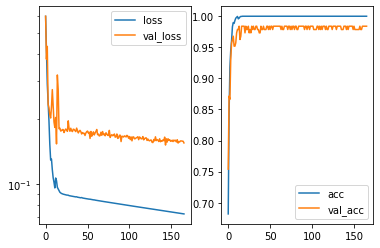

Predicted cell: Background Probability: [[0.9977598]]
True Cell type: Background
x [[0.5015324]]
True positional value x 0.5
y [[0.4641139]]
True positional value y 0.5


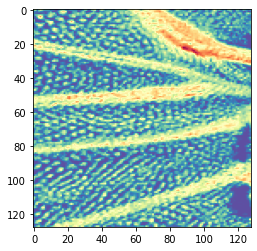

Epoch 167/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0726 - acc: 1.0000 - val_loss: 0.1550 - val_acc: 0.9786

Epoch 00167: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15503329197990703, 'val_acc': 0.9786096205685866, 'loss': 0.07256347959198255, 'acc': 1.0, 'lr': 1e-04}


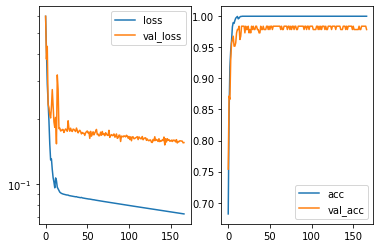

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4336547]]
True positional value x 0.421875
y [[0.4533691]]
True positional value y 0.5


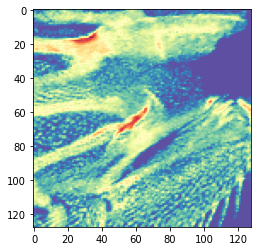

Epoch 168/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0725 - acc: 1.0000 - val_loss: 0.1560 - val_acc: 0.9840

Epoch 00168: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15600952386537337, 'val_acc': 0.9839572154264399, 'loss': 0.07246763204123029, 'acc': 1.0, 'lr': 1e-04}


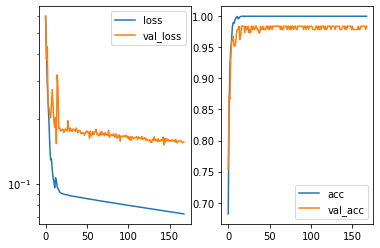

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4934823]]
True positional value x 0.5
y [[0.5557059]]
True positional value y 0.5


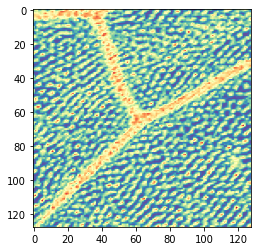

Epoch 169/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0724 - acc: 1.0000 - val_loss: 0.1541 - val_acc: 0.9840

Epoch 00169: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15405198832087338, 'val_acc': 0.9839572154264399, 'loss': 0.0723706098495065, 'acc': 1.0, 'lr': 1e-04}


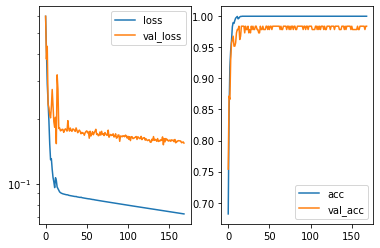

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.52647835]]
True positional value x 0.5
y [[0.54811984]]
True positional value y 0.578125


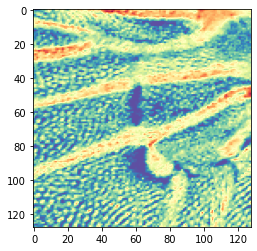

Epoch 170/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0723 - acc: 1.0000 - val_loss: 0.1558 - val_acc: 0.9840

Epoch 00170: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15582394066022678, 'val_acc': 0.9839572154264399, 'loss': 0.07227744325129783, 'acc': 1.0, 'lr': 1e-04}


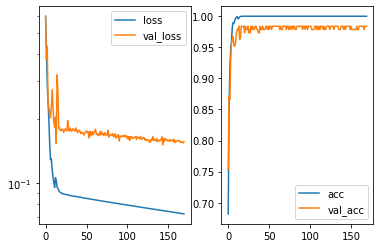

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4907196]]
True positional value x 0.5
y [[0.56856865]]
True positional value y 0.5


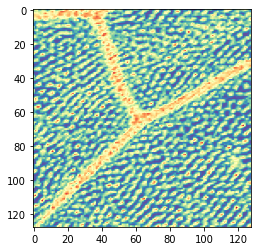

Epoch 171/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0722 - acc: 1.0000 - val_loss: 0.1557 - val_acc: 0.9840

Epoch 00171: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15568415071556274, 'val_acc': 0.9839572154264399, 'loss': 0.0721718069781574, 'acc': 1.0, 'lr': 1e-04}


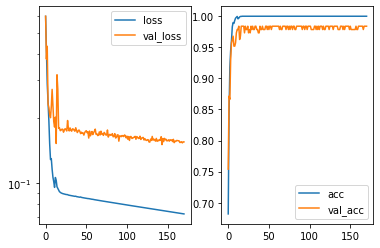

Predicted cell: Background Probability: [[0.999915]]
True Cell type: Background
x [[0.5739655]]
True positional value x 0.5
y [[0.46126115]]
True positional value y 0.5


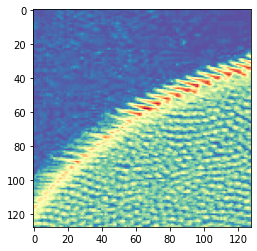

Epoch 172/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0721 - acc: 1.0000 - val_loss: 0.1577 - val_acc: 0.9840

Epoch 00172: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15765213265138514, 'val_acc': 0.9839572154264399, 'loss': 0.07208180389731063, 'acc': 1.0, 'lr': 1e-04}


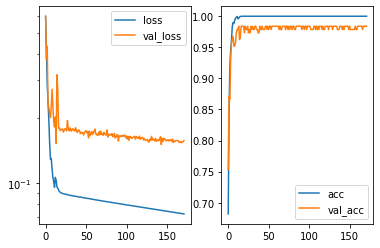

Predicted cell: Background Probability: [[0.99998367]]
True Cell type: Background
x [[0.47073653]]
True positional value x 0.5
y [[0.5246021]]
True positional value y 0.5


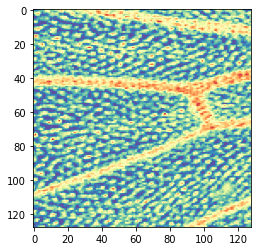

Epoch 173/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0720 - acc: 1.0000 - val_loss: 0.1547 - val_acc: 0.9840

Epoch 00173: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15465110771477542, 'val_acc': 0.9839572154264399, 'loss': 0.07198662114173628, 'acc': 1.0, 'lr': 1e-04}


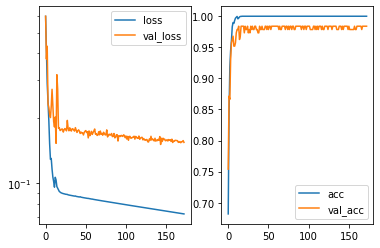

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.41481477]]
True positional value x 0.421875
y [[0.5639531]]
True positional value y 0.578125


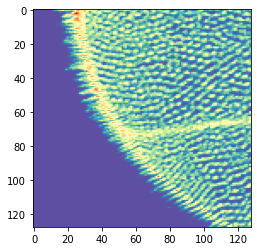

Epoch 174/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0719 - acc: 1.0000 - val_loss: 0.1534 - val_acc: 0.9840

Epoch 00174: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15337265709185982, 'val_acc': 0.9839572154264399, 'loss': 0.0718875901423735, 'acc': 1.0, 'lr': 1e-04}


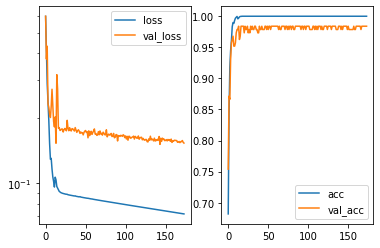

Predicted cell: Landmark Probability: [[0.9998995]]
True Cell type: Landmark
x [[0.407402]]
True positional value x 0.421875
y [[0.52086455]]
True positional value y 0.578125


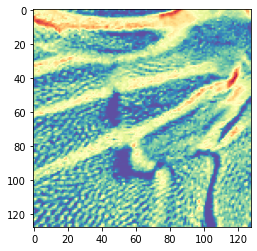

Epoch 175/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0718 - acc: 1.0000 - val_loss: 0.1542 - val_acc: 0.9840

Epoch 00175: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15420629335119124, 'val_acc': 0.9839572154264399, 'loss': 0.07180101266451226, 'acc': 1.0, 'lr': 1e-04}


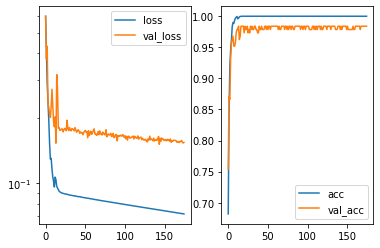

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.52362776]]
True positional value x 0.5
y [[0.52418053]]
True positional value y 0.578125


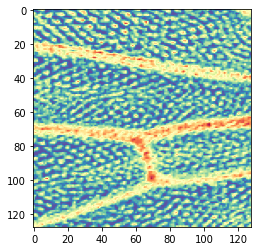

Epoch 176/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0717 - acc: 1.0000 - val_loss: 0.1540 - val_acc: 0.9786

Epoch 00176: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15398495803701687, 'val_acc': 0.9786096205685866, 'loss': 0.07169158351216287, 'acc': 1.0, 'lr': 1e-04}


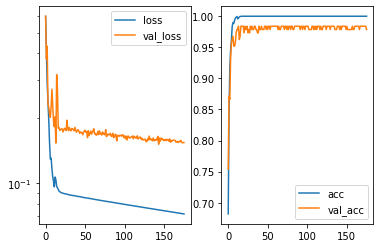

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47085258]]
True positional value x 0.5
y [[0.4186658]]
True positional value y 0.5


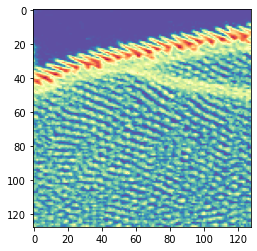

Epoch 177/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0716 - acc: 1.0000 - val_loss: 0.1566 - val_acc: 0.9840

Epoch 00177: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15660800183201856, 'val_acc': 0.9839572154264399, 'loss': 0.07160604084976904, 'acc': 1.0, 'lr': 1e-04}


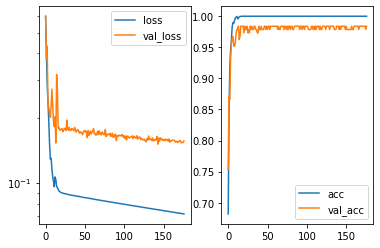

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.4275079]]
True positional value x 0.421875
y [[0.54160887]]
True positional value y 0.5


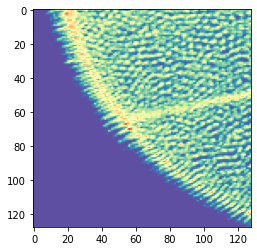

Epoch 178/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0715 - acc: 1.0000 - val_loss: 0.1571 - val_acc: 0.9840

Epoch 00178: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1570515398354454, 'val_acc': 0.9839572154264399, 'loss': 0.0715057949897467, 'acc': 1.0, 'lr': 1e-04}


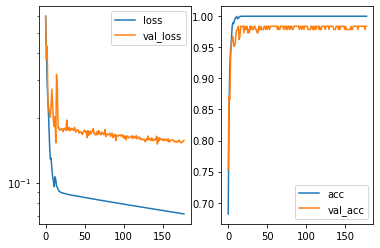

Predicted cell: Landmark Probability: [[0.9999522]]
True Cell type: Landmark
x [[0.46504432]]
True positional value x 0.5
y [[0.43163073]]
True positional value y 0.421875


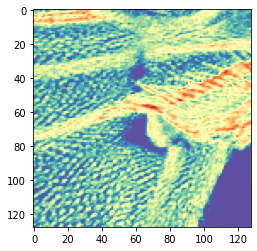

Epoch 179/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0714 - acc: 1.0000 - val_loss: 0.1548 - val_acc: 0.9840

Epoch 00179: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15479319184062315, 'val_acc': 0.9839572154264399, 'loss': 0.07140451225515684, 'acc': 1.0, 'lr': 1e-04}


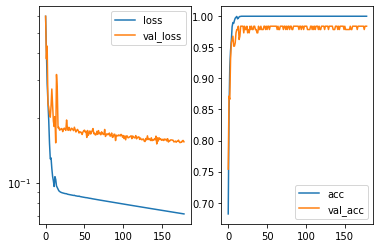

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49264088]]
True positional value x 0.5
y [[0.4964589]]
True positional value y 0.5


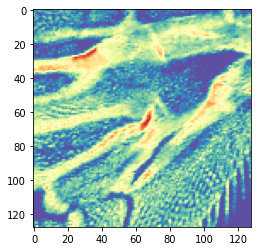

Epoch 180/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0713 - acc: 1.0000 - val_loss: 0.1575 - val_acc: 0.9840

Epoch 00180: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1574730948012143, 'val_acc': 0.9839572154264399, 'loss': 0.07132234083550566, 'acc': 1.0, 'lr': 1e-04}


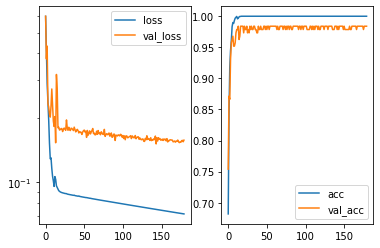

Predicted cell: Background Probability: [[0.99036777]]
True Cell type: Background
x [[0.43502563]]
True positional value x 0.5
y [[0.3755716]]
True positional value y 0.5


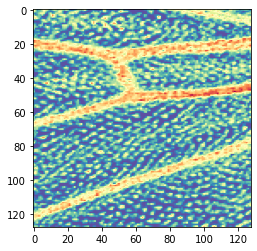

Epoch 181/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0712 - acc: 1.0000 - val_loss: 0.1567 - val_acc: 0.9840

Epoch 00181: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15671146792524002, 'val_acc': 0.9839572154264399, 'loss': 0.07122196223496449, 'acc': 1.0, 'lr': 1e-04}


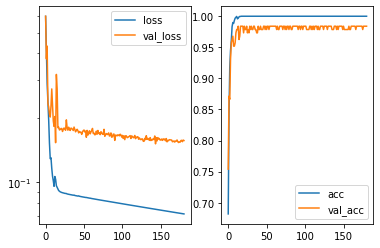

Predicted cell: Background Probability: [[0.99999845]]
True Cell type: Background
x [[0.51986265]]
True positional value x 0.5
y [[0.53157043]]
True positional value y 0.5


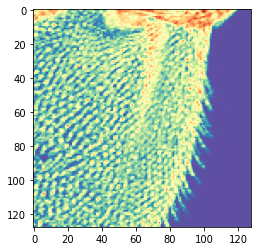

Epoch 182/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0711 - acc: 1.0000 - val_loss: 0.1544 - val_acc: 0.9840

Epoch 00182: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15440004052006626, 'val_acc': 0.9839572154264399, 'loss': 0.07112862918582664, 'acc': 1.0, 'lr': 1e-04}


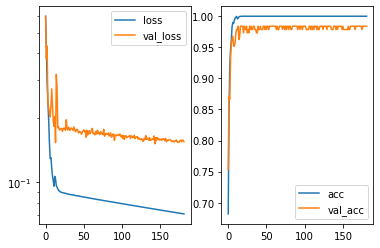

Predicted cell: Landmark Probability: [[0.99998295]]
True Cell type: Landmark
x [[0.5724438]]
True positional value x 0.578125
y [[0.60620975]]
True positional value y 0.578125


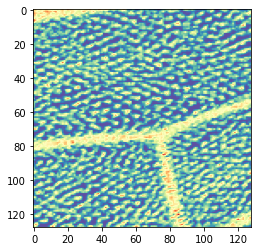

Epoch 183/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0710 - acc: 1.0000 - val_loss: 0.1544 - val_acc: 0.9840

Epoch 00183: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15437921212318748, 'val_acc': 0.9839572154264399, 'loss': 0.07102401092757765, 'acc': 1.0, 'lr': 1e-04}


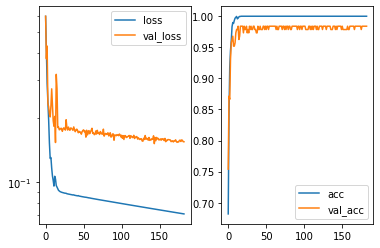

Predicted cell: Background Probability: [[0.99999726]]
True Cell type: Background
x [[0.5002839]]
True positional value x 0.5
y [[0.4577949]]
True positional value y 0.5


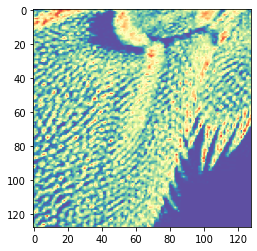

Epoch 184/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0710 - acc: 1.0000 - val_loss: 0.1558 - val_acc: 0.9840

Epoch 00184: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1558249644576547, 'val_acc': 0.9839572154264399, 'loss': 0.07095570485351856, 'acc': 1.0, 'lr': 1e-04}


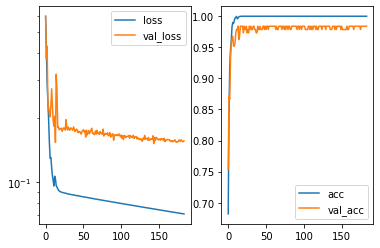

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5166591]]
True positional value x 0.5
y [[0.5315815]]
True positional value y 0.578125


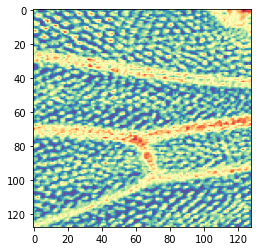

Epoch 185/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0708 - acc: 1.0000 - val_loss: 0.1523 - val_acc: 0.9840

Epoch 00185: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15227486308723848, 'val_acc': 0.9839572154264399, 'loss': 0.07083953781714226, 'acc': 1.0, 'lr': 1e-04}


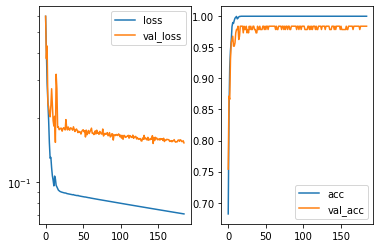

Predicted cell: Landmark Probability: [[0.9992755]]
True Cell type: Landmark
x [[0.5361244]]
True positional value x 0.578125
y [[0.47392195]]
True positional value y 0.5


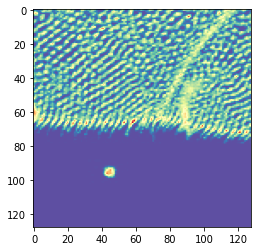

Epoch 186/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0707 - acc: 1.0000 - val_loss: 0.1505 - val_acc: 0.9786

Epoch 00186: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15046854464606169, 'val_acc': 0.9786096205685866, 'loss': 0.07074393582038131, 'acc': 1.0, 'lr': 1e-04}


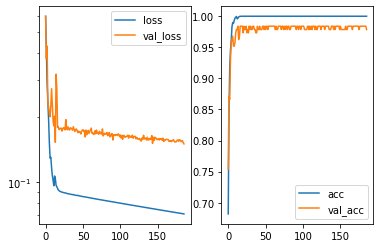

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52489173]]
True positional value x 0.5
y [[0.4952845]]
True positional value y 0.5


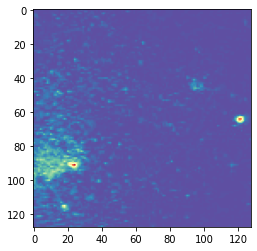

Epoch 187/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0706 - acc: 1.0000 - val_loss: 0.1553 - val_acc: 0.9840

Epoch 00187: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15525360787934797, 'val_acc': 0.9839572154264399, 'loss': 0.07064923898721912, 'acc': 1.0, 'lr': 1e-04}


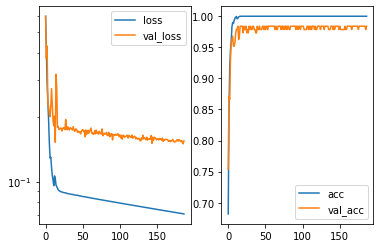

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4874002]]
True positional value x 0.5
y [[0.5276794]]
True positional value y 0.5


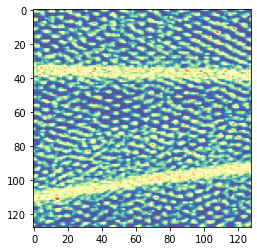

Epoch 188/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0705 - acc: 1.0000 - val_loss: 0.1543 - val_acc: 0.9840

Epoch 00188: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15426860518634, 'val_acc': 0.9839572154264399, 'loss': 0.07054884274145068, 'acc': 1.0, 'lr': 1e-04}


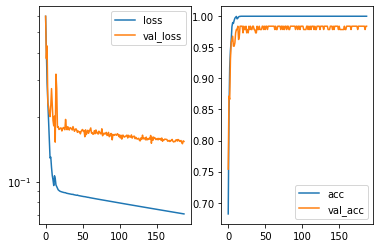

Predicted cell: Landmark Probability: [[0.98765963]]
True Cell type: Landmark
x [[0.4495283]]
True positional value x 0.421875
y [[0.5388019]]
True positional value y 0.5


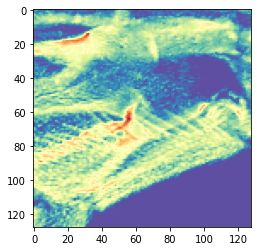

Epoch 189/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0705 - acc: 1.0000 - val_loss: 0.1522 - val_acc: 0.9786

Epoch 00189: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15223558924414896, 'val_acc': 0.9786096205685866, 'loss': 0.07046251453236543, 'acc': 1.0, 'lr': 1e-04}


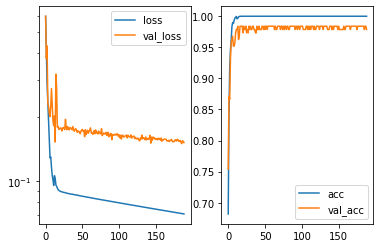

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.55606985]]
True positional value x 0.578125
y [[0.48360655]]
True positional value y 0.421875


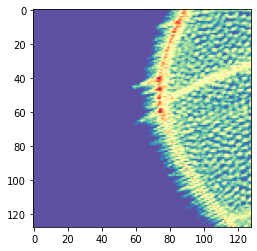

Epoch 190/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0704 - acc: 1.0000 - val_loss: 0.1523 - val_acc: 0.9840

Epoch 00190: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15225821833081424, 'val_acc': 0.9839572154264399, 'loss': 0.07036266583493384, 'acc': 1.0, 'lr': 1e-04}


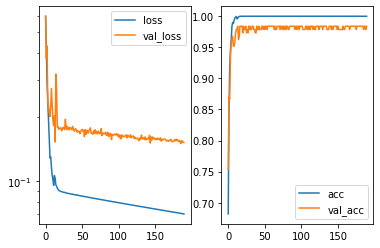

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4252357]]
True positional value x 0.421875
y [[0.5936862]]
True positional value y 0.578125


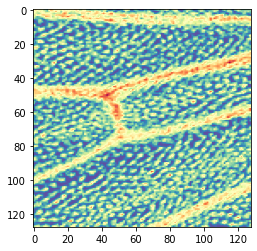

Epoch 191/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0703 - acc: 1.0000 - val_loss: 0.1532 - val_acc: 0.9786

Epoch 00191: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15323526531776643, 'val_acc': 0.9786096205685866, 'loss': 0.07031711301037771, 'acc': 1.0, 'lr': 1e-04}


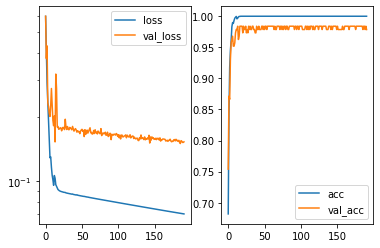

Predicted cell: Landmark Probability: [[0.99999213]]
True Cell type: Landmark
x [[0.43597278]]
True positional value x 0.421875
y [[0.5417845]]
True positional value y 0.5


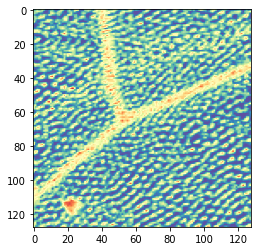

Epoch 192/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0702 - acc: 1.0000 - val_loss: 0.1466 - val_acc: 0.9840

Epoch 00192: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14662116048807766, 'val_acc': 0.9839572154264399, 'loss': 0.0701998335766846, 'acc': 1.0, 'lr': 1e-04}


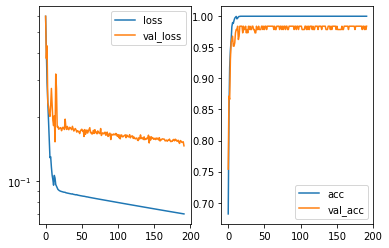

Predicted cell: Landmark Probability: [[0.99999905]]
True Cell type: Landmark
x [[0.5086031]]
True positional value x 0.421875
y [[0.46845382]]
True positional value y 0.421875


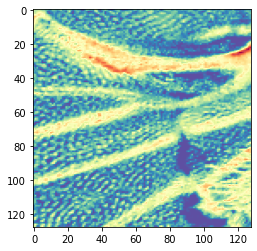

Epoch 193/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0701 - acc: 1.0000 - val_loss: 0.1497 - val_acc: 0.9840

Epoch 00193: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14968669191401274, 'val_acc': 0.9839572154264399, 'loss': 0.07008796007500082, 'acc': 1.0, 'lr': 1e-04}


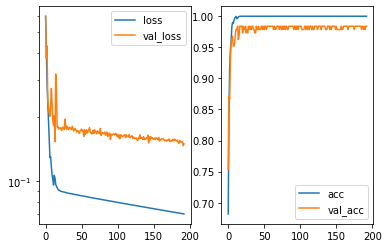

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.4937746]]
True positional value x 0.5
y [[0.5086975]]
True positional value y 0.421875


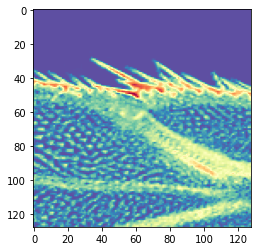

Epoch 194/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0700 - acc: 1.0000 - val_loss: 0.1773 - val_acc: 0.9786

Epoch 00194: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.17731879850759863, 'val_acc': 0.9786096205685866, 'loss': 0.0700395723528534, 'acc': 1.0, 'lr': 1e-04}


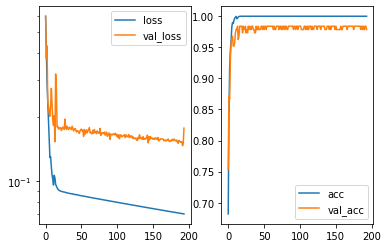

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49445587]]
True positional value x 0.5
y [[0.52015656]]
True positional value y 0.421875


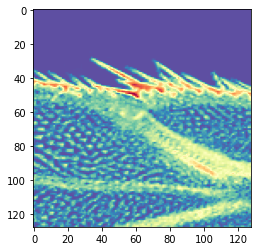

Epoch 195/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0699 - acc: 1.0000 - val_loss: 0.1576 - val_acc: 0.9786

Epoch 00195: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15762455263399186, 'val_acc': 0.9786096205685866, 'loss': 0.0699147680848921, 'acc': 1.0, 'lr': 1e-04}


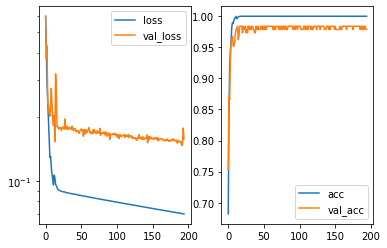

Predicted cell: Landmark Probability: [[0.99999905]]
True Cell type: Landmark
x [[0.50189656]]
True positional value x 0.421875
y [[0.4724711]]
True positional value y 0.421875


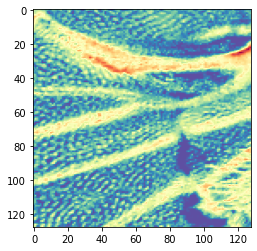

Epoch 196/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0698 - acc: 1.0000 - val_loss: 0.1623 - val_acc: 0.9786

Epoch 00196: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1623454605513078, 'val_acc': 0.9786096205685866, 'loss': 0.06981426161843643, 'acc': 1.0, 'lr': 1e-04}


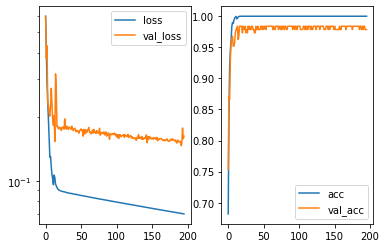

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.43157136]]
True positional value x 0.421875
y [[0.5377599]]
True positional value y 0.5


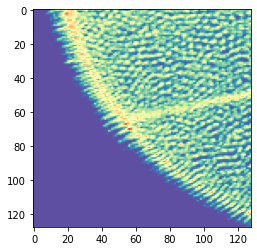

Epoch 197/250
3546/3546 [==============================] - 12s 4ms/step - loss: 0.0697 - acc: 1.0000 - val_loss: 0.1579 - val_acc: 0.9786

Epoch 00197: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15793312918693625, 'val_acc': 0.9786096205685866, 'loss': 0.06971314452794468, 'acc': 1.0, 'lr': 1e-04}


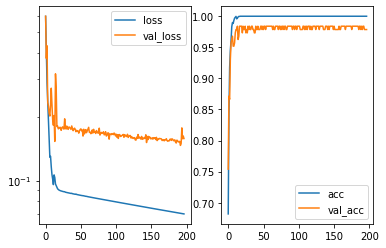

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.46031877]]
True positional value x 0.5
y [[0.49747214]]
True positional value y 0.5


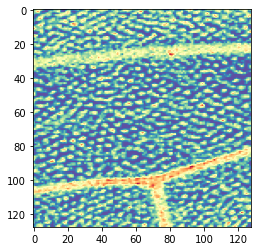

Epoch 198/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0696 - acc: 1.0000 - val_loss: 0.1614 - val_acc: 0.9786

Epoch 00198: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.16139222052008073, 'val_acc': 0.9786096205685866, 'loss': 0.06962068021314263, 'acc': 1.0, 'lr': 1e-04}


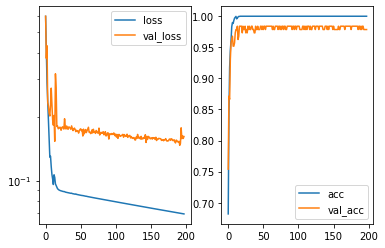

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.444292]]
True positional value x 0.5
y [[0.5329296]]
True positional value y 0.5


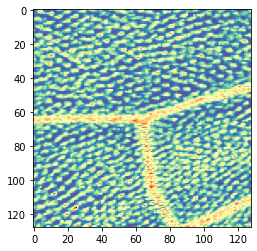

Epoch 199/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0695 - acc: 1.0000 - val_loss: 0.1588 - val_acc: 0.9786

Epoch 00199: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15876809439875864, 'val_acc': 0.9786096205685866, 'loss': 0.06952997994621259, 'acc': 1.0, 'lr': 1e-04}


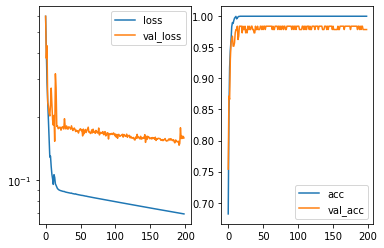

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.51689726]]
True positional value x 0.5
y [[0.45630673]]
True positional value y 0.5


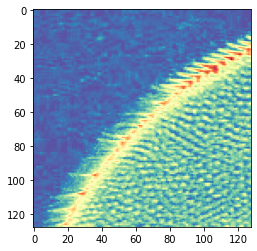

Epoch 200/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0694 - acc: 1.0000 - val_loss: 0.1585 - val_acc: 0.9786

Epoch 00200: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15850711502334014, 'val_acc': 0.9786096205685866, 'loss': 0.06944155379986938, 'acc': 1.0, 'lr': 1e-04}


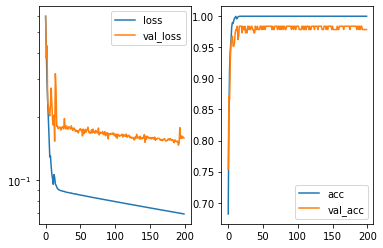

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49326947]]
True positional value x 0.5
y [[0.5198297]]
True positional value y 0.5


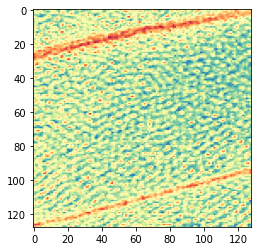

Epoch 201/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0694 - acc: 1.0000 - val_loss: 0.1547 - val_acc: 0.9786

Epoch 00201: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15467278822698696, 'val_acc': 0.9786096205685866, 'loss': 0.06935065973800116, 'acc': 1.0, 'lr': 1e-04}


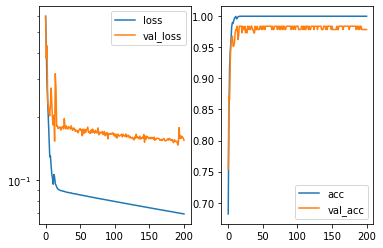

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47304153]]
True positional value x 0.5
y [[0.42672434]]
True positional value y 0.5


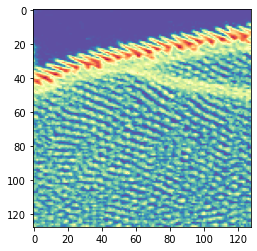

Epoch 202/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0693 - acc: 1.0000 - val_loss: 0.1494 - val_acc: 0.9840

Epoch 00202: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14939214667693818, 'val_acc': 0.9839572154264399, 'loss': 0.0692615410112353, 'acc': 1.0, 'lr': 1e-04}


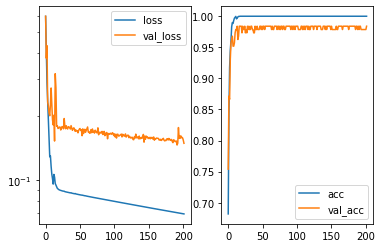

Predicted cell: Landmark Probability: [[0.99999094]]
True Cell type: Landmark
x [[0.537547]]
True positional value x 0.5
y [[0.53028953]]
True positional value y 0.5


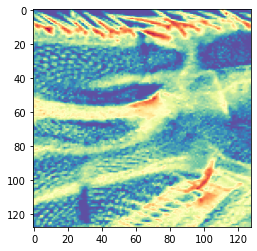

Epoch 203/250
3546/3546 [==============================] - 13s 4ms/step - loss: 0.0692 - acc: 1.0000 - val_loss: 0.1511 - val_acc: 0.9840

Epoch 00203: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1511120440010081, 'val_acc': 0.9839572154264399, 'loss': 0.0691619206638035, 'acc': 1.0, 'lr': 1e-04}


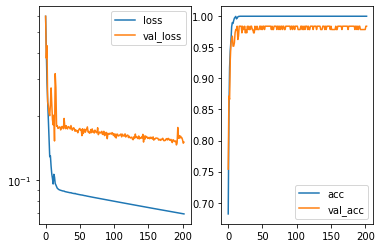

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.54471356]]
True positional value x 0.5
y [[0.48009855]]
True positional value y 0.5


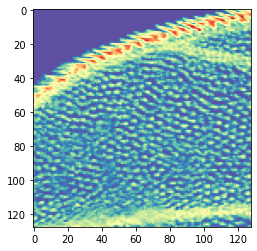

Epoch 204/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0691 - acc: 1.0000 - val_loss: 0.1530 - val_acc: 0.9786

Epoch 00204: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15302729072736546, 'val_acc': 0.9786096205685866, 'loss': 0.06907533236516107, 'acc': 1.0, 'lr': 1e-04}


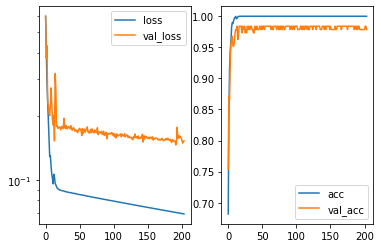

Predicted cell: Landmark Probability: [[0.99983287]]
True Cell type: Landmark
x [[0.4944918]]
True positional value x 0.578125
y [[0.51412207]]
True positional value y 0.5


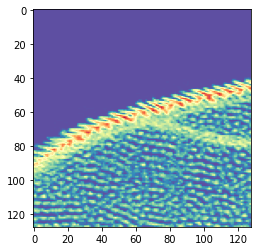

Epoch 205/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0690 - acc: 1.0000 - val_loss: 0.1516 - val_acc: 0.9840

Epoch 00205: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15156950853406426, 'val_acc': 0.9839572154264399, 'loss': 0.06897568761529185, 'acc': 1.0, 'lr': 1e-04}


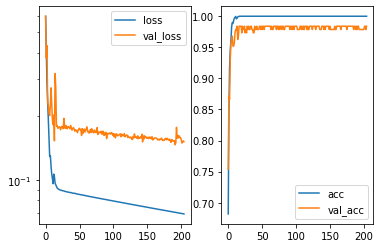

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.57954407]]
True positional value x 0.578125
y [[0.3988041]]
True positional value y 0.421875


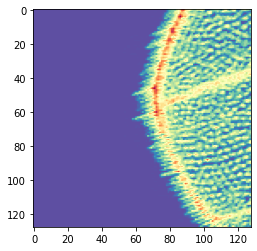

Epoch 206/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0689 - acc: 1.0000 - val_loss: 0.1522 - val_acc: 0.9840

Epoch 00206: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1521920840689205, 'val_acc': 0.9839572154264399, 'loss': 0.06888782532619879, 'acc': 1.0, 'lr': 1e-04}


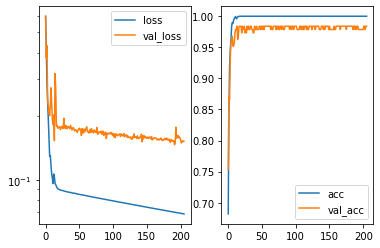

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.61153865]]
True positional value x 0.578125
y [[0.42841932]]
True positional value y 0.5


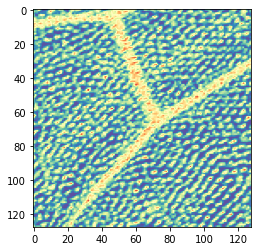

Epoch 207/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0688 - acc: 1.0000 - val_loss: 0.1513 - val_acc: 0.9786

Epoch 00207: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1512573220353713, 'val_acc': 0.9786096205685866, 'loss': 0.06880356739939637, 'acc': 1.0, 'lr': 1e-04}


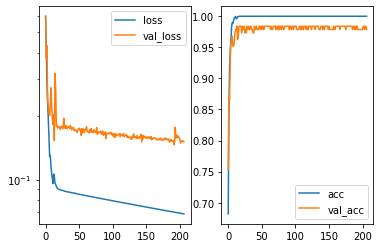

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.53913474]]
True positional value x 0.578125
y [[0.4265046]]
True positional value y 0.421875


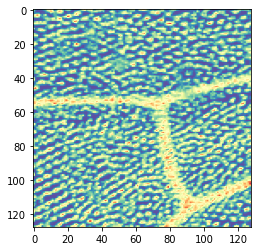

Epoch 208/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0687 - acc: 1.0000 - val_loss: 0.1482 - val_acc: 0.9840

Epoch 00208: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14822272191391908, 'val_acc': 0.9839572154264399, 'loss': 0.06870183984035162, 'acc': 1.0, 'lr': 1e-04}


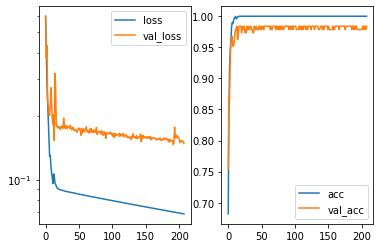

Predicted cell: Background Probability: [[0.999984]]
True Cell type: Background
x [[0.51187813]]
True positional value x 0.5
y [[0.50901425]]
True positional value y 0.5


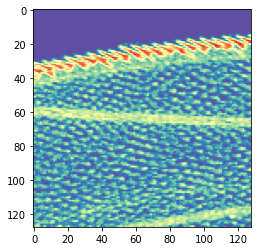

Epoch 209/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0686 - acc: 1.0000 - val_loss: 0.1498 - val_acc: 0.9840

Epoch 00209: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14982243770743436, 'val_acc': 0.9839572154264399, 'loss': 0.06861460217717537, 'acc': 1.0, 'lr': 1e-04}


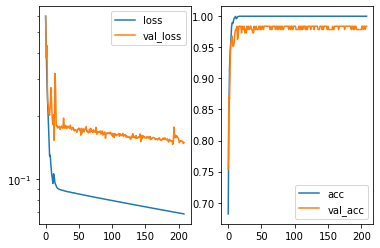

Predicted cell: Landmark Probability: [[0.9999993]]
True Cell type: Landmark
x [[0.49547836]]
True positional value x 0.421875
y [[0.45438555]]
True positional value y 0.5


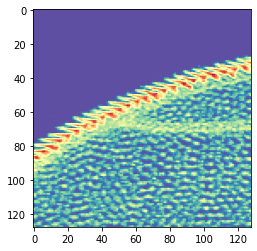

Epoch 210/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0685 - acc: 1.0000 - val_loss: 0.1500 - val_acc: 0.9840

Epoch 00210: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15003219932158363, 'val_acc': 0.9839572154264399, 'loss': 0.0685305734996532, 'acc': 1.0, 'lr': 1e-04}


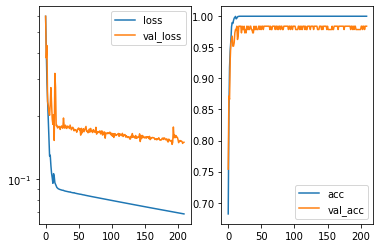

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.46055356]]
True positional value x 0.5
y [[0.5339232]]
True positional value y 0.5


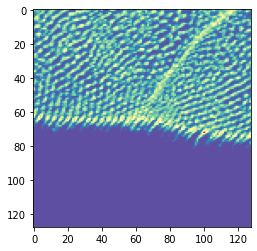

Epoch 211/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0684 - acc: 1.0000 - val_loss: 0.1516 - val_acc: 0.9786

Epoch 00211: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15155822456998622, 'val_acc': 0.9786096205685866, 'loss': 0.0684370277412719, 'acc': 1.0, 'lr': 1e-04}


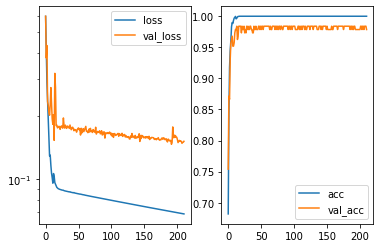

Predicted cell: Landmark Probability: [[0.99996424]]
True Cell type: Landmark
x [[0.46375084]]
True positional value x 0.5
y [[0.4379872]]
True positional value y 0.421875


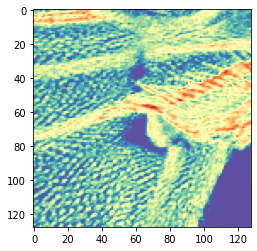

Epoch 212/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0683 - acc: 1.0000 - val_loss: 0.1552 - val_acc: 0.9840

Epoch 00212: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15516963848136964, 'val_acc': 0.9839572154264399, 'loss': 0.06834231990242973, 'acc': 1.0, 'lr': 1e-04}


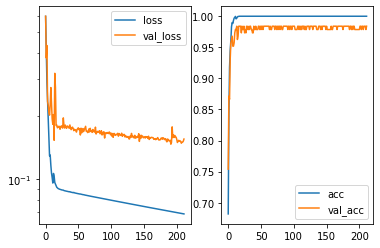

Predicted cell: Background Probability: [[0.9999995]]
True Cell type: Background
x [[0.52232486]]
True positional value x 0.5
y [[0.45739332]]
True positional value y 0.5


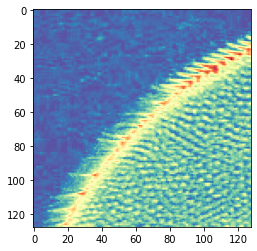

Epoch 213/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0683 - acc: 1.0000 - val_loss: 0.1483 - val_acc: 0.9840

Epoch 00213: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.148274913788798, 'val_acc': 0.9839572154264399, 'loss': 0.0682547298347755, 'acc': 1.0, 'lr': 1e-04}


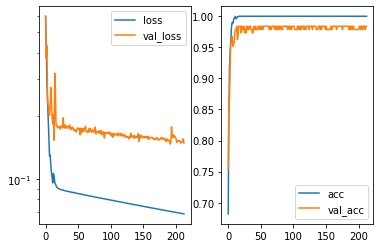

Predicted cell: Background Probability: [[0.99995184]]
True Cell type: Background
x [[0.5021816]]
True positional value x 0.5
y [[0.54045415]]
True positional value y 0.5


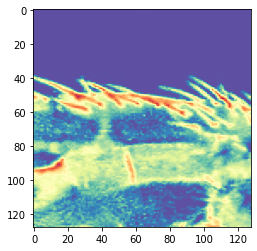

Epoch 214/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0682 - acc: 1.0000 - val_loss: 0.1476 - val_acc: 0.9840

Epoch 00214: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14755113307326873, 'val_acc': 0.9839572154264399, 'loss': 0.06816238356524111, 'acc': 1.0, 'lr': 1e-04}


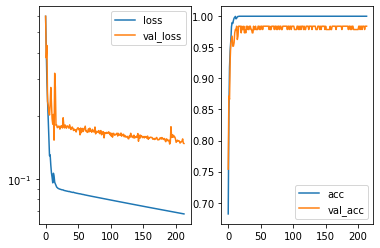

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.38200307]]
True positional value x 0.421875
y [[0.4090409]]
True positional value y 0.421875


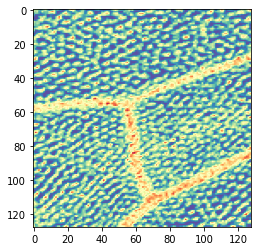

Epoch 215/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0681 - acc: 1.0000 - val_loss: 0.1503 - val_acc: 0.9840

Epoch 00215: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1502787363242338, 'val_acc': 0.9839572154264399, 'loss': 0.06807247947668263, 'acc': 1.0, 'lr': 1e-04}


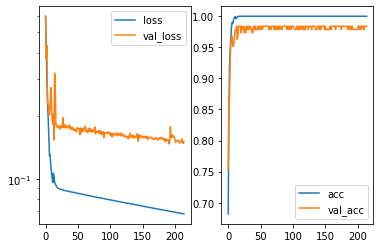

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5195603]]
True positional value x 0.5
y [[0.53095806]]
True positional value y 0.578125


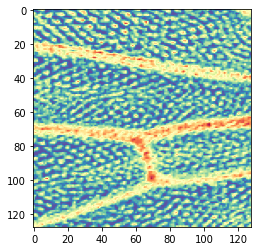

Epoch 216/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0680 - acc: 1.0000 - val_loss: 0.1501 - val_acc: 0.9840

Epoch 00216: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15014033202819008, 'val_acc': 0.9839572154264399, 'loss': 0.06798662083487153, 'acc': 1.0, 'lr': 1e-04}


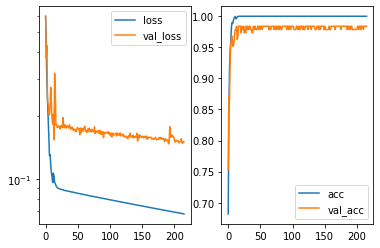

Predicted cell: Landmark Probability: [[0.9999974]]
True Cell type: Landmark
x [[0.53813934]]
True positional value x 0.578125
y [[0.4897764]]
True positional value y 0.578125


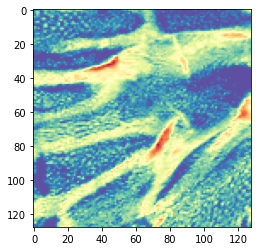

Epoch 217/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0679 - acc: 1.0000 - val_loss: 0.1492 - val_acc: 0.9840

Epoch 00217: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1491829095119461, 'val_acc': 0.9839572154264399, 'loss': 0.06789356788217987, 'acc': 1.0, 'lr': 1e-04}


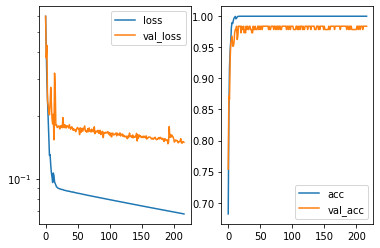

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5190725]]
True positional value x 0.5
y [[0.47187975]]
True positional value y 0.5


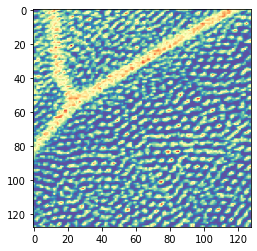

Epoch 218/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0678 - acc: 1.0000 - val_loss: 0.1503 - val_acc: 0.9840

Epoch 00218: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15026080600399386, 'val_acc': 0.9839572154264399, 'loss': 0.06780327713244122, 'acc': 1.0, 'lr': 1e-04}


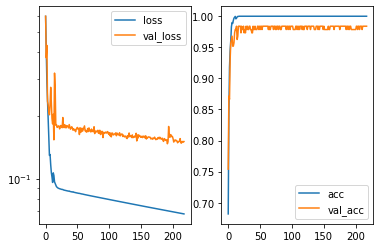

Predicted cell: Landmark Probability: [[0.85615146]]
True Cell type: Background
x [[0.45026147]]
True positional value x 0.5
y [[0.4251971]]
True positional value y 0.5


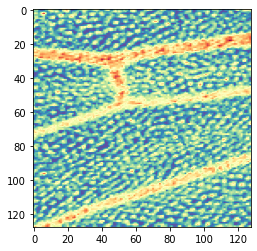

Epoch 219/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0677 - acc: 1.0000 - val_loss: 0.1515 - val_acc: 0.9786

Epoch 00219: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15147307953413794, 'val_acc': 0.9786096205685866, 'loss': 0.06771575849034728, 'acc': 1.0, 'lr': 1e-04}


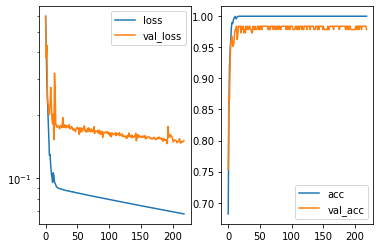

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52402574]]
True positional value x 0.5
y [[0.49906072]]
True positional value y 0.5


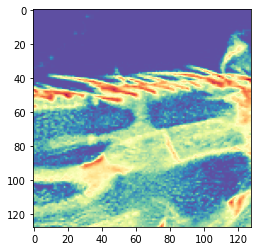

Epoch 220/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0676 - acc: 1.0000 - val_loss: 0.1526 - val_acc: 0.9840

Epoch 00220: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15258056044897295, 'val_acc': 0.9839572154264399, 'loss': 0.06762759393376276, 'acc': 1.0, 'lr': 1e-04}


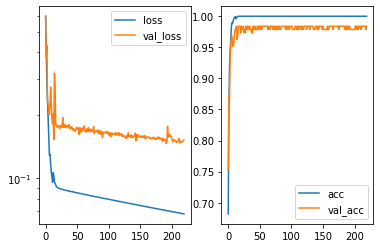

Predicted cell: Landmark Probability: [[0.9999583]]
True Cell type: Background
x [[0.54725385]]
True positional value x 0.5
y [[0.4986549]]
True positional value y 0.5


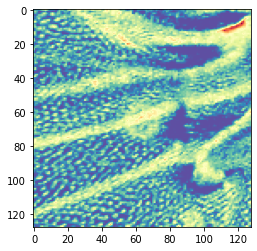

Epoch 221/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0675 - acc: 1.0000 - val_loss: 0.1467 - val_acc: 0.9840

Epoch 00221: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14665576357414378, 'val_acc': 0.9839572154264399, 'loss': 0.0675405262514016, 'acc': 1.0, 'lr': 1e-04}


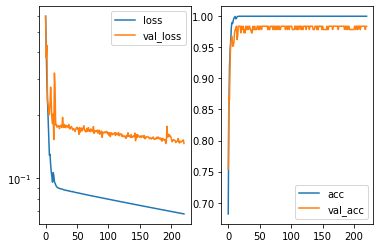

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.50520205]]
True positional value x 0.5
y [[0.44906756]]
True positional value y 0.5


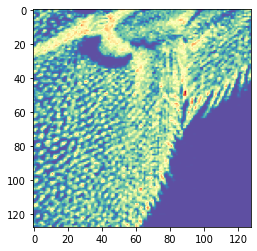

Epoch 222/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0675 - acc: 1.0000 - val_loss: 0.1520 - val_acc: 0.9840

Epoch 00222: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15197402055569512, 'val_acc': 0.9839572154264399, 'loss': 0.06745953469611263, 'acc': 1.0, 'lr': 1e-04}


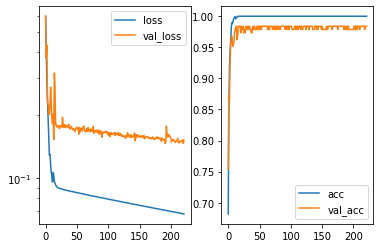

Predicted cell: Landmark Probability: [[0.99998546]]
True Cell type: Landmark
x [[0.6095588]]
True positional value x 0.578125
y [[0.5511762]]
True positional value y 0.578125


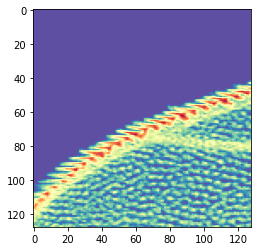

Epoch 223/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0674 - acc: 1.0000 - val_loss: 0.1471 - val_acc: 0.9840

Epoch 00223: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14707705745085037, 'val_acc': 0.9839572154264399, 'loss': 0.06736595691242127, 'acc': 1.0, 'lr': 1e-04}


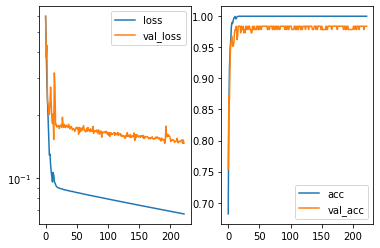

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.50541717]]
True positional value x 0.5
y [[0.5362983]]
True positional value y 0.5


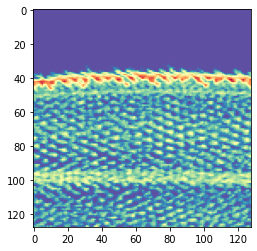

Epoch 224/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0673 - acc: 1.0000 - val_loss: 0.1446 - val_acc: 0.9840

Epoch 00224: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14464742343693493, 'val_acc': 0.9839572154264399, 'loss': 0.06726776983733912, 'acc': 1.0, 'lr': 1e-04}


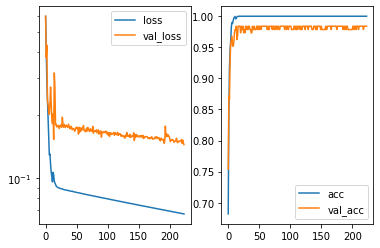

Predicted cell: Background Probability: [[0.99999845]]
True Cell type: Background
x [[0.49491754]]
True positional value x 0.5
y [[0.45698795]]
True positional value y 0.5


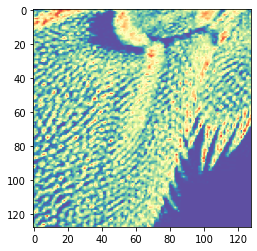

Epoch 225/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0672 - acc: 1.0000 - val_loss: 0.1465 - val_acc: 0.9840

Epoch 00225: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14653437883458673, 'val_acc': 0.9839572154264399, 'loss': 0.06717939598793642, 'acc': 1.0, 'lr': 1e-04}


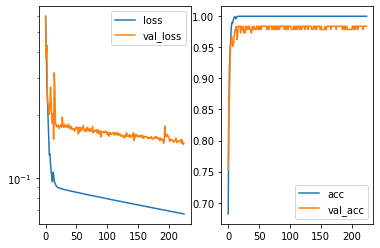

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.51930743]]
True positional value x 0.5
y [[0.54749864]]
True positional value y 0.5


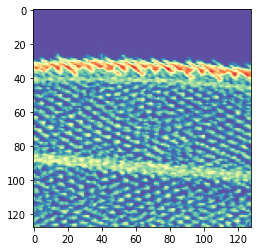

Epoch 226/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0671 - acc: 1.0000 - val_loss: 0.1478 - val_acc: 0.9786

Epoch 00226: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1478454166236408, 'val_acc': 0.9786096205685866, 'loss': 0.06709335651931558, 'acc': 1.0, 'lr': 1e-04}


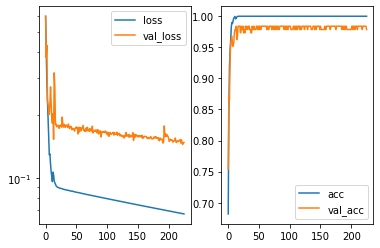

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5140994]]
True positional value x 0.5
y [[0.47885233]]
True positional value y 0.5


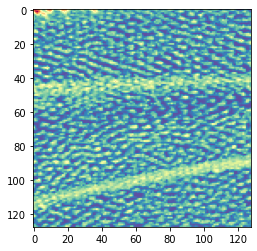

Epoch 227/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0670 - acc: 1.0000 - val_loss: 0.1494 - val_acc: 0.9840

Epoch 00227: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14936624762208703, 'val_acc': 0.9839572154264399, 'loss': 0.06700186982742488, 'acc': 1.0, 'lr': 1e-04}


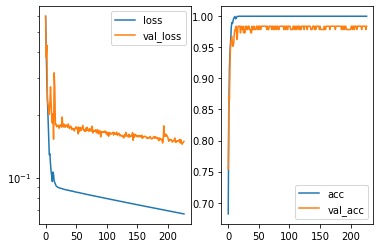

Predicted cell: Background Probability: [[0.9970125]]
True Cell type: Background
x [[0.4969492]]
True positional value x 0.5
y [[0.46302933]]
True positional value y 0.5


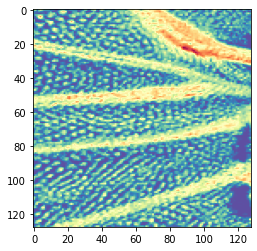

Epoch 228/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0669 - acc: 1.0000 - val_loss: 0.1479 - val_acc: 0.9786

Epoch 00228: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14789190338575903, 'val_acc': 0.9786096205685866, 'loss': 0.06692634362809348, 'acc': 1.0, 'lr': 1e-04}


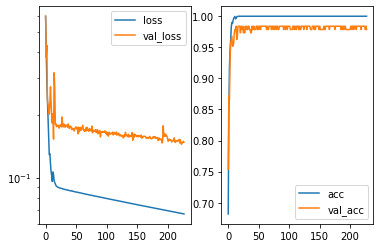

Predicted cell: Landmark Probability: [[0.99985015]]
True Cell type: Landmark
x [[0.450935]]
True positional value x 0.421875
y [[0.39609936]]
True positional value y 0.5


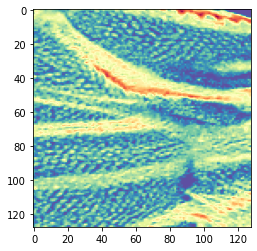

Epoch 229/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0668 - acc: 1.0000 - val_loss: 0.1481 - val_acc: 0.9840

Epoch 00229: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1481082428266658, 'val_acc': 0.9839572154264399, 'loss': 0.06683271113957515, 'acc': 1.0, 'lr': 1e-04}


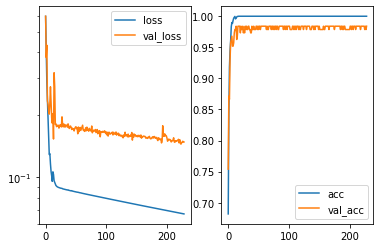

Predicted cell: Background Probability: [[0.9998833]]
True Cell type: Background
x [[0.575696]]
True positional value x 0.5
y [[0.45735735]]
True positional value y 0.5


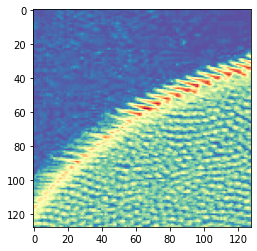

Epoch 230/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0667 - acc: 1.0000 - val_loss: 0.1499 - val_acc: 0.9786

Epoch 00230: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14985812080894562, 'val_acc': 0.9786096205685866, 'loss': 0.06673971498863077, 'acc': 1.0, 'lr': 1e-04}


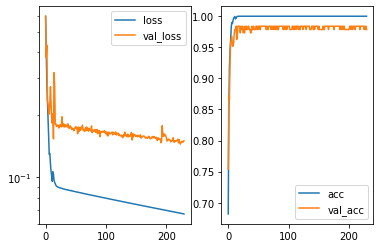

Predicted cell: Landmark Probability: [[0.9999976]]
True Cell type: Landmark
x [[0.5720288]]
True positional value x 0.578125
y [[0.42339376]]
True positional value y 0.421875


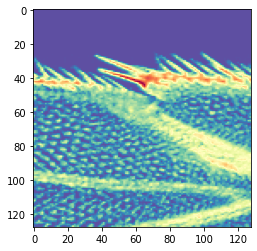

Epoch 231/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0667 - acc: 1.0000 - val_loss: 0.1482 - val_acc: 0.9840

Epoch 00231: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1482453975766738, 'val_acc': 0.9839572154264399, 'loss': 0.06665632487587249, 'acc': 1.0, 'lr': 1e-04}


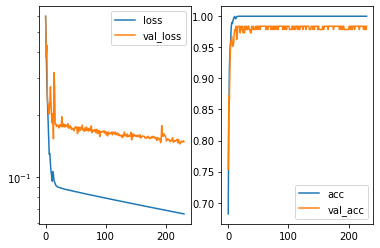

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.43010387]]
True positional value x 0.421875
y [[0.4519112]]
True positional value y 0.5


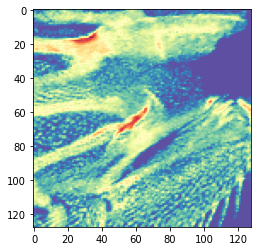

Epoch 232/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0666 - acc: 1.0000 - val_loss: 0.1480 - val_acc: 0.9840

Epoch 00232: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14798447768637205, 'val_acc': 0.9839572154264399, 'loss': 0.06657084012461865, 'acc': 1.0, 'lr': 1e-04}


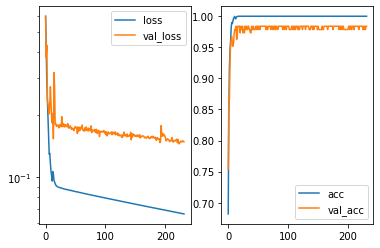

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.57941777]]
True positional value x 0.578125
y [[0.538034]]
True positional value y 0.578125


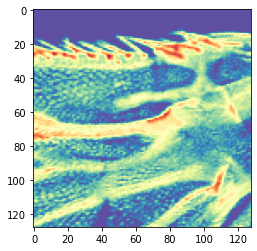

Epoch 233/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0665 - acc: 1.0000 - val_loss: 0.1485 - val_acc: 0.9840

Epoch 00233: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1484886964852797, 'val_acc': 0.9839572154264399, 'loss': 0.06647948234920373, 'acc': 1.0, 'lr': 1e-04}


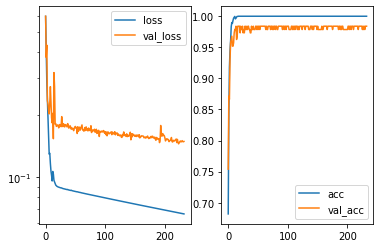

Predicted cell: Landmark Probability: [[0.99999905]]
True Cell type: Landmark
x [[0.43200362]]
True positional value x 0.421875
y [[0.50960886]]
True positional value y 0.578125


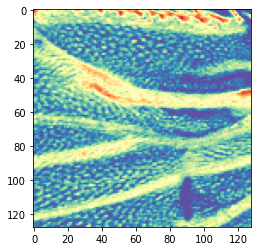

Epoch 234/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0664 - acc: 1.0000 - val_loss: 0.1501 - val_acc: 0.9840

Epoch 00234: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15014965633020044, 'val_acc': 0.9839572154264399, 'loss': 0.06639877910154793, 'acc': 1.0, 'lr': 1e-04}


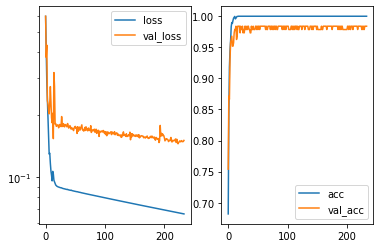

Predicted cell: Background Probability: [[0.99999714]]
True Cell type: Background
x [[0.5002725]]
True positional value x 0.5
y [[0.45877242]]
True positional value y 0.5


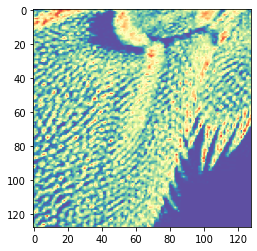

Epoch 235/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0663 - acc: 1.0000 - val_loss: 0.1458 - val_acc: 0.9786

Epoch 00235: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14584243333435312, 'val_acc': 0.9786096205685866, 'loss': 0.06630962502969838, 'acc': 1.0, 'lr': 1e-04}


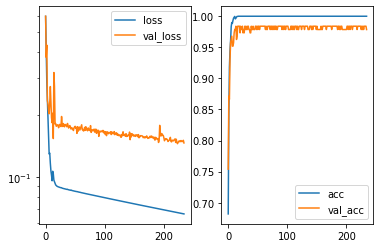

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.5009195]]
True positional value x 0.5
y [[0.45284188]]
True positional value y 0.5


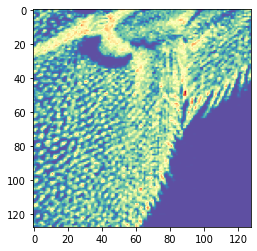

Epoch 236/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0662 - acc: 1.0000 - val_loss: 0.1518 - val_acc: 0.9840

Epoch 00236: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15175547096181044, 'val_acc': 0.9839572154264399, 'loss': 0.06621716534577045, 'acc': 1.0, 'lr': 1e-04}


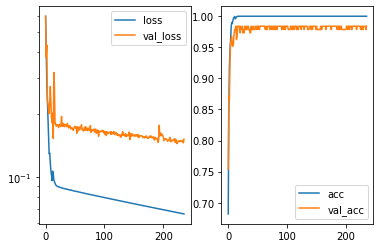

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.57453805]]
True positional value x 0.5
y [[0.45683494]]
True positional value y 0.5


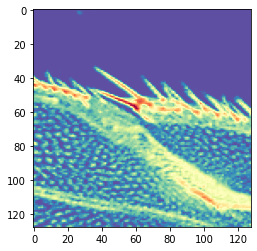

Epoch 237/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0661 - acc: 1.0000 - val_loss: 0.1495 - val_acc: 0.9840

Epoch 00237: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14953080919337144, 'val_acc': 0.9839572154264399, 'loss': 0.06613526857225356, 'acc': 1.0, 'lr': 1e-04}


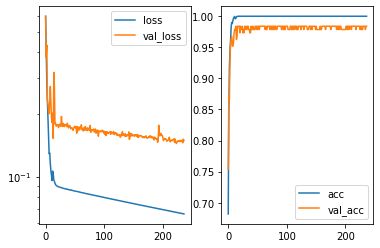

Predicted cell: Landmark Probability: [[0.99999726]]
True Cell type: Landmark
x [[0.5349479]]
True positional value x 0.578125
y [[0.49265805]]
True positional value y 0.578125


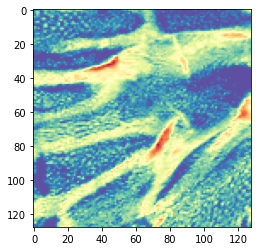

Epoch 238/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0660 - acc: 1.0000 - val_loss: 0.1475 - val_acc: 0.9840

Epoch 00238: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1475423615485589, 'val_acc': 0.9839572154264399, 'loss': 0.06604290035019066, 'acc': 1.0, 'lr': 1e-04}


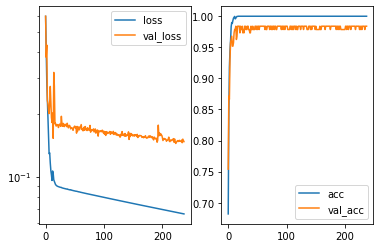

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5121996]]
True positional value x 0.5
y [[0.55476975]]
True positional value y 0.5


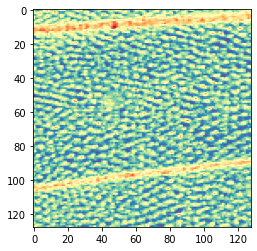

Epoch 239/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0660 - acc: 1.0000 - val_loss: 0.1475 - val_acc: 0.9840

Epoch 00239: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14754446950507036, 'val_acc': 0.9839572154264399, 'loss': 0.06596178651797321, 'acc': 1.0, 'lr': 1e-04}


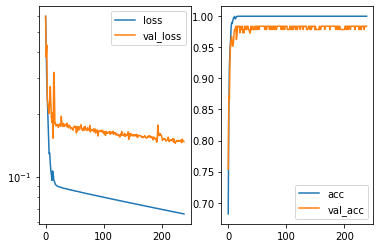

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5199512]]
True positional value x 0.5
y [[0.49727407]]
True positional value y 0.5


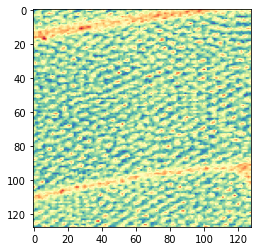

Epoch 240/250
3546/3546 [==============================] - 11s 3ms/step - loss: 0.0659 - acc: 1.0000 - val_loss: 0.1465 - val_acc: 0.9786

Epoch 00240: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1464842785807217, 'val_acc': 0.9786096205685866, 'loss': 0.06588267781222801, 'acc': 1.0, 'lr': 1e-04}


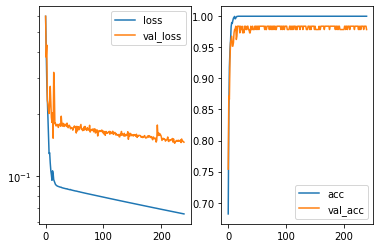

Predicted cell: Landmark Probability: [[0.9999994]]
True Cell type: Landmark
x [[0.50475705]]
True positional value x 0.421875
y [[0.4659717]]
True positional value y 0.421875


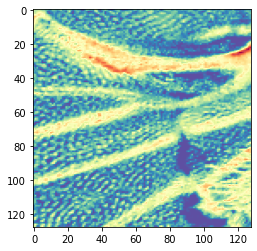

Epoch 241/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0658 - acc: 1.0000 - val_loss: 0.1504 - val_acc: 0.9840

Epoch 00241: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.15044322040151148, 'val_acc': 0.9839572154264399, 'loss': 0.06579254626034346, 'acc': 1.0, 'lr': 1e-04}


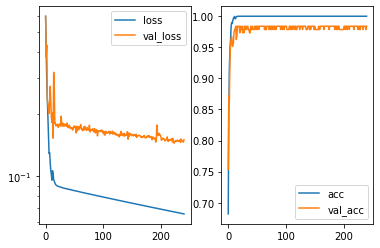

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.6120341]]
True positional value x 0.578125
y [[0.56194633]]
True positional value y 0.578125


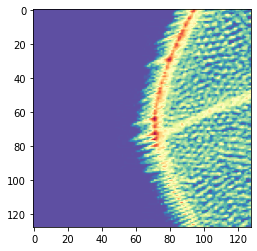

Epoch 242/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0657 - acc: 1.0000 - val_loss: 0.1461 - val_acc: 0.9840

Epoch 00242: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1460564759644595, 'val_acc': 0.9839572154264399, 'loss': 0.06570224864413626, 'acc': 1.0, 'lr': 1e-04}


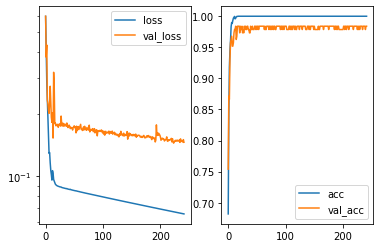

Predicted cell: Landmark Probability: [[0.99999356]]
True Cell type: Landmark
x [[0.54100275]]
True positional value x 0.578125
y [[0.61491275]]
True positional value y 0.578125


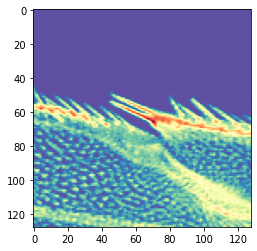

Epoch 243/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0656 - acc: 1.0000 - val_loss: 0.1486 - val_acc: 0.9786

Epoch 00243: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14856942571739462, 'val_acc': 0.9786096205685866, 'loss': 0.06562724826753442, 'acc': 1.0, 'lr': 1e-04}


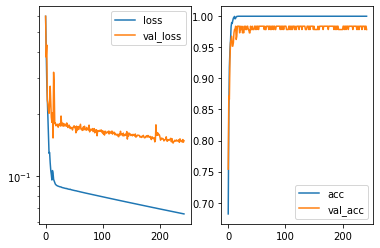

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.6077202]]
True positional value x 0.578125
y [[0.43258256]]
True positional value y 0.5


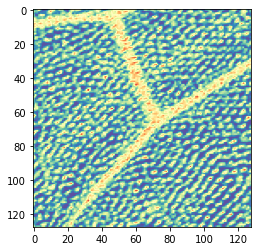

Epoch 244/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0655 - acc: 1.0000 - val_loss: 0.1433 - val_acc: 0.9840

Epoch 00244: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14330703354774313, 'val_acc': 0.9839572154264399, 'loss': 0.06553349144718974, 'acc': 1.0, 'lr': 1e-04}


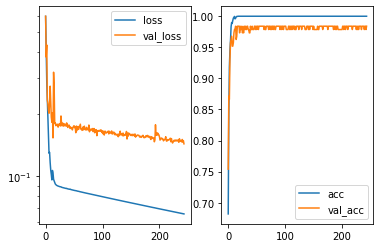

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49509293]]
True positional value x 0.5
y [[0.4683374]]
True positional value y 0.5


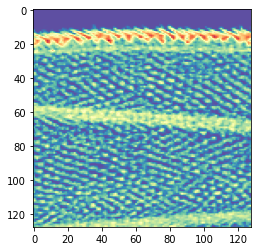

Epoch 245/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0655 - acc: 1.0000 - val_loss: 0.1484 - val_acc: 0.9840

Epoch 00245: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.1483862901275808, 'val_acc': 0.9839572154264399, 'loss': 0.06545018372785151, 'acc': 1.0, 'lr': 1e-04}


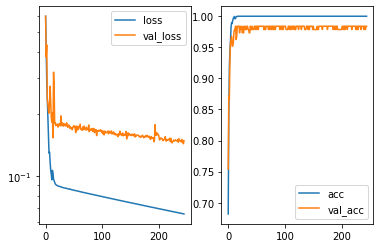

Predicted cell: Background Probability: [[0.9999999]]
True Cell type: Background
x [[0.51185876]]
True positional value x 0.5
y [[0.54153216]]
True positional value y 0.5


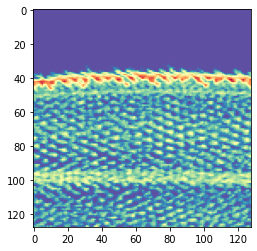

Epoch 246/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0654 - acc: 1.0000 - val_loss: 0.1448 - val_acc: 0.9840

Epoch 00246: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14477976511187732, 'val_acc': 0.9839572154264399, 'loss': 0.06535674921130301, 'acc': 1.0, 'lr': 1e-04}


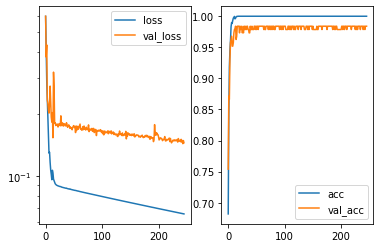

Predicted cell: Landmark Probability: [[0.9999894]]
True Cell type: Landmark
x [[0.41746584]]
True positional value x 0.421875
y [[0.47349608]]
True positional value y 0.5


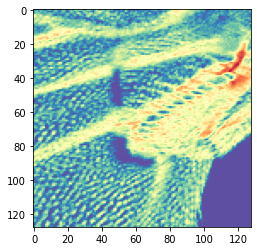

Epoch 247/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0653 - acc: 1.0000 - val_loss: 0.1428 - val_acc: 0.9786

Epoch 00247: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14279630218438286, 'val_acc': 0.9786096205685866, 'loss': 0.06527853985745155, 'acc': 1.0, 'lr': 1e-04}


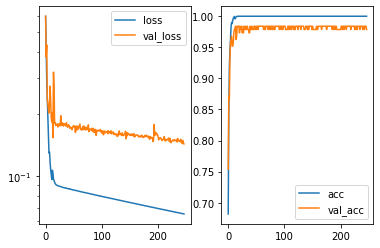

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5137697]]
True positional value x 0.5
y [[0.4841255]]
True positional value y 0.421875


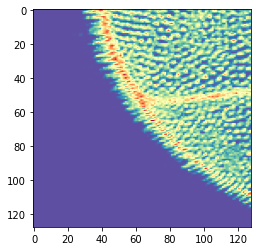

Epoch 248/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0652 - acc: 1.0000 - val_loss: 0.1487 - val_acc: 0.9840

Epoch 00248: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14874232899058948, 'val_acc': 0.9839572154264399, 'loss': 0.06519151470181099, 'acc': 1.0, 'lr': 1e-04}


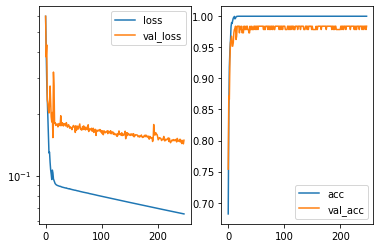

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5966958]]
True positional value x 0.5
y [[0.5179589]]
True positional value y 0.5


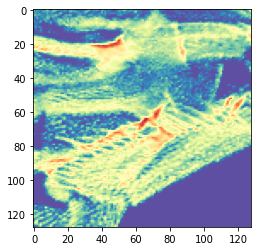

Epoch 249/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0651 - acc: 1.0000 - val_loss: 0.1461 - val_acc: 0.9786

Epoch 00249: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14606040022908684, 'val_acc': 0.9786096205685866, 'loss': 0.06511040175626726, 'acc': 1.0, 'lr': 1e-04}


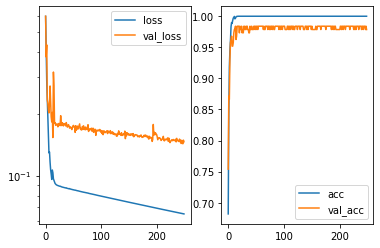

Predicted cell: Landmark Probability: [[0.9998117]]
True Cell type: Landmark
x [[0.529635]]
True positional value x 0.5
y [[0.49615055]]
True positional value y 0.5


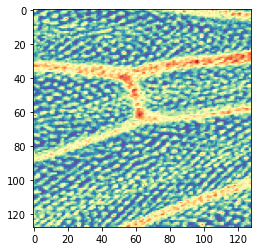

Epoch 250/250
3546/3546 [==============================] - 12s 3ms/step - loss: 0.0650 - acc: 1.0000 - val_loss: 0.1487 - val_acc: 0.9786

Epoch 00250: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d11.h5
{'val_loss': 0.14868395197837747, 'val_acc': 0.9786096205685866, 'loss': 0.06503196042167622, 'acc': 1.0, 'lr': 1e-04}


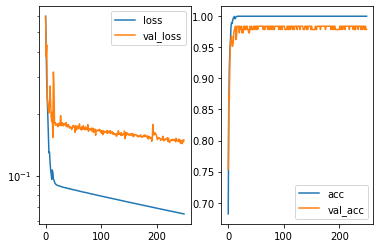

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.44034374]]
True positional value x 0.421875
y [[0.5052555]]
True positional value y 0.5


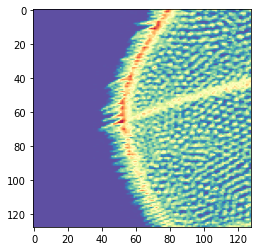

In [5]:
static_model = NEATStatic(config, model_dir, model_name)

static_model.loadData()

static_model.TrainModel()
